# Imports

In [1]:
from __future__ import print_function, division

from keras.datasets import mnist
from keras.layers.merge import _Merge
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import RMSprop, Adam
from functools import partial

import keras.backend as K

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import sys
import os
import pathlib
import glob
import shutil
import sklearn.datasets

import cv2

from PIL import Image

import numpy as np
from keras.models import load_model

Using TensorFlow backend.


# Setup

In [2]:
# Mount CU Drive
from google.colab import drive
drive.mount('/content/drive')

# Make Image dir
!mkdir images/

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# Clear everything in the directory including the directory itself
def clear_dir(dir_name):
  shutil.rmtree(dir_name)

In [4]:
!ls drive/My\ Drive/

 001_0001.jpg
'Appel A.W. - Modern compiler implementation in ML-CUP (1999).pdf'
'(Cambridge Series in Statistical and Probabilistic Mathematics) David Pollard - A User’s Guide to Measure Theoretic Probability-Cambridge University Press (2001).pdf'
 DCGAN-polygons-20k
 DCGAN-squares-1-4
 DCGAN-squares-3-4
'DCGAN-squares-3-4 (1)'
 DCGAN-squares-3-4-transfer-40000
 DCGAN-squares-3-4-transfer-48000
 images-70k
 mod_vid.mp4
 new_vid.mp4
'Personal-Data Information Worksheet.gsheet'
 res-net-28-2-1hr-dropout-IS-acc.png
 res-net-28-2-1hr-dropout-IS.h5
 res-net-28-2-1hr-dropout-IS-history.npy
 res-net-28-2-1hr-dropout-IS-loss.png
 res-net-28-2-1hr-dropout-IS-superRes8x8-acc.png
 res-net-28-2-1hr-dropout-IS-superRes8x8.h5
 res-net-28-2-1hr-dropout-IS-superRes8x8-history.npy
 res-net-28-2-1hr-dropout-IS-superRes8x8-loss.png
 res-net-28-2-1hr-dropout-noIS-acc.png
 res-net-28-2-1hr-dropout-noIS.h5
 res-net-28-2-1hr-dropout-noIS-history.npy
 res-net-28-2-1hr-dropout-noIS-loss.png
 res-net-28-2-1hr-

# Point Datasets

## Vanilla GAN

### Class and Utilities

In [0]:
class GAN_point():
    def __init__(self, X_train, out_shape, latent_dim, save_path):
        self.out_shape = out_shape
        self.latent_dim = latent_dim
        self.dataset = X_train
        self.save_path = save_path

        optimizer = Adam(0.0002, 0.5)

        # Build and compile the discriminator
        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

        # Build the generator
        self.generator = self.build_generator()

        # The generator takes noise as input and generates imgs
        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        # For the combined model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator takes generated images as input and determines validity
        validity = self.discriminator(img)

        # The combined model  (stacked generator and discriminator)
        # Trains the generator to fool the discriminator
        self.combined = Model(z, validity)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer)


    def build_generator(self):

        model = Sequential()

        model.add(Dense(8, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        #model.add(BatchNormalization(momentum=0.8))
        
        model.add(Dense(16, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        #model.add(BatchNormalization(momentum=0.8))
        
        model.add(Dense(8, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        #model.add(BatchNormalization(momentum=0.8))
    
        model.add(Dense(self.out_shape, activation='tanh'))
        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_discriminator(self):

        model = Sequential()

        model.add(Dense(8, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(16, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(8, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))

        model.add(Dense(1, activation='sigmoid'))
        model.summary()

        img = Input(shape=(self.out_shape,))
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size=128, sample_interval=50, azm = 240):
        # Normalize Dataset
        X_train = self.dataset
        scale = max(abs(np.amin(X_train)), np.max(X_train))
        X_train = X_train/(scale)

        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))
        
        # Keep track of losses
        disc_loss = []
        gen_loss = []

        for epoch in range(epochs):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random batch of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))

            # Generate a batch of new images
            gen_imgs = self.generator.predict(noise)

            # Train the discriminator
            d_loss_real = self.discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))

            # Train the generator (to have the discriminator label samples as valid)
            g_loss = self.combined.train_on_batch(noise, valid)

            # Print the progress
            if epoch % sample_interval == 0:
              print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))
              
            disc_loss.append(d_loss[0])
            gen_loss.append(g_loss)

            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:
                noise = np.random.normal(0, 1, (1000, self.latent_dim))
                gen_imgs = self.generator.predict(noise)
                
                # Save Snapshots of models, losses and samples
                
                # Save model snapshots
                model_dir = self.save_path + '/models/' + str(epoch) + '/'
                pathlib.Path(model_dir).mkdir(parents=True, exist_ok=True) 
                self.generator.save(model_dir + 'gen_' + str(epoch) + '.h5')
                self.combined.save(model_dir + 'combined_' + str(epoch) + '.h5')
                
                # Save Losses
                loss_dir = self.save_path + '/loss/' + str(epoch) + '/'
                pathlib.Path(loss_dir).mkdir(parents=True, exist_ok=True) 
                np.save(loss_dir + 'disc_loss', np.array(disc_loss))
                np.save(loss_dir + 'gen_loss', np.array(gen_loss))
                
                # Plot Samples
                idx = np.random.randint(0, high = 5000, size = 1000)
                
                if self.out_shape == 2:
                  x, y = X_train[idx,0], X_train[idx,1]
                  plt.figure(0)
                  plt.scatter(gen_imgs[:,0], gen_imgs[:,1], color = 'green')
                  plt.scatter(x, y, color = 'red')
                  
                  plt.figure(1)
                  plt.scatter(gen_imgs[:,0], gen_imgs[:,1], color = 'green')
                  
                  
                elif self.out_shape == 3:
                  x, y, z = X_train[idx,0], X_train[idx,1], X_train[idx,2]
                  
                  fig = plt.figure(0)
                  ax = fig.add_subplot(111, projection='3d')
                  ax.scatter(x, y, z, c='r', marker='o')
                  ax.scatter(gen_imgs[:,0], gen_imgs[:,1], gen_imgs[:,2], c='g', marker='o')
                  
                  ax.azim= azm
                  
                  
                  fig = plt.figure(1)
                  ax = fig.add_subplot(111, projection='3d')
                  ax.scatter(gen_imgs[:,0], gen_imgs[:,1], gen_imgs[:,2], c='g', marker='o')
                  
                  ax.azim= azm
                  
                # Save samples
                sample_dir = self.save_path + '/samples/' + str(epoch) + '/'
                pathlib.Path(sample_dir).mkdir(parents=True, exist_ok=True) 
                plt.savefig(sample_dir + 'sample.png')
                
                plt.show()
                

In [0]:
def build_model(model_class, ds_path, inp_size, latent_dim, save_path, n_iter, azimuth = 240):
  # Load Dataset
  ds = np.load(ds_path)
  X_train = ds[:,:inp_size]
  
  # Train model
  gan = model_class(X_train, inp_size, latent_dim, save_path)
  gan.train(epochs=n_iter, batch_size=32, sample_interval=2000, azm = azimuth)

### Eval on Circles factor 5

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 8)                 24        
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 16)                144       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 8)                 0         
_________________________________________________________________
dens

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.675619, acc.: 50.00%] [G loss: 0.687441]


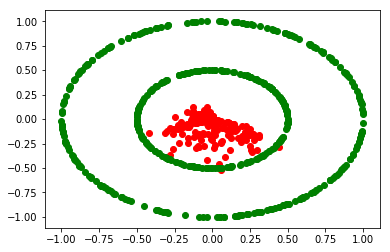

2000 [D loss: 0.713231, acc.: 37.50%] [G loss: 0.629838]


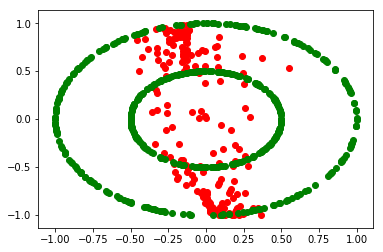

4000 [D loss: 0.635861, acc.: 78.12%] [G loss: 0.713123]


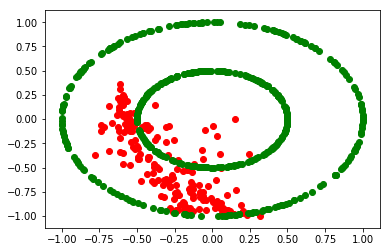

6000 [D loss: 0.687982, acc.: 51.56%] [G loss: 0.754108]


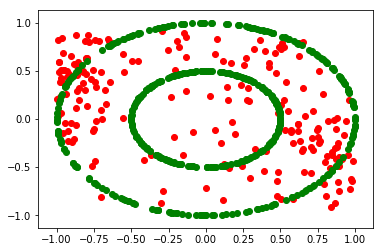

8000 [D loss: 0.694389, acc.: 71.88%] [G loss: 0.714333]


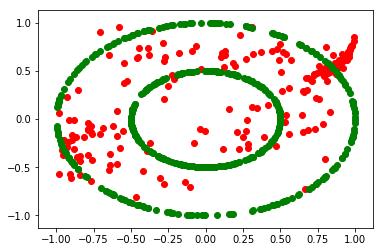

10000 [D loss: 0.693120, acc.: 57.81%] [G loss: 0.692438]


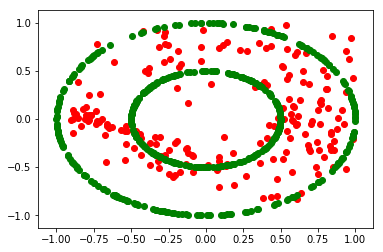

12000 [D loss: 0.692840, acc.: 54.69%] [G loss: 0.693420]


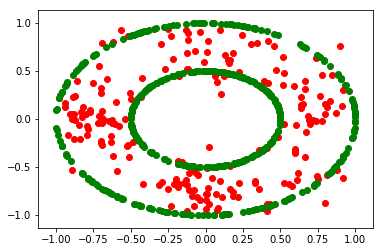

14000 [D loss: 0.692444, acc.: 59.38%] [G loss: 0.692933]


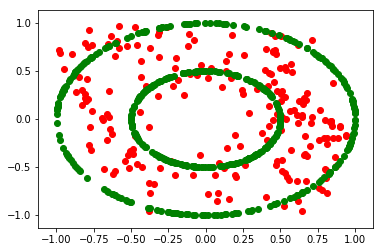

16000 [D loss: 0.692795, acc.: 51.56%] [G loss: 0.692336]


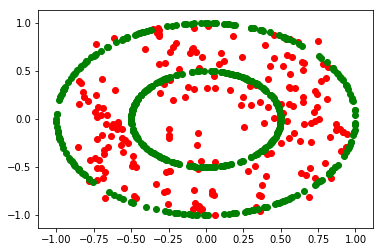

18000 [D loss: 0.691855, acc.: 46.88%] [G loss: 0.691830]


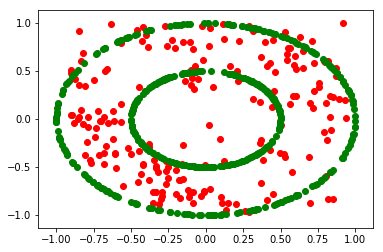

20000 [D loss: 0.694694, acc.: 39.06%] [G loss: 0.695357]


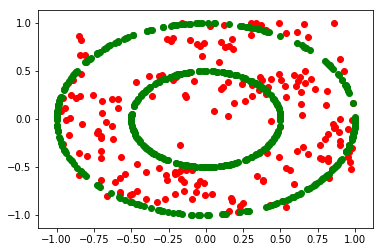

22000 [D loss: 0.691836, acc.: 59.38%] [G loss: 0.696460]


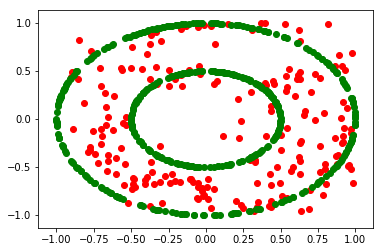

24000 [D loss: 0.692535, acc.: 53.12%] [G loss: 0.689750]


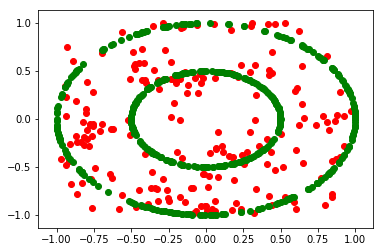

26000 [D loss: 0.693227, acc.: 48.44%] [G loss: 0.692622]


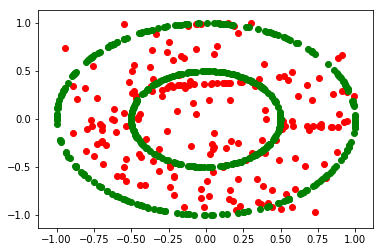

28000 [D loss: 0.692747, acc.: 50.00%] [G loss: 0.692778]


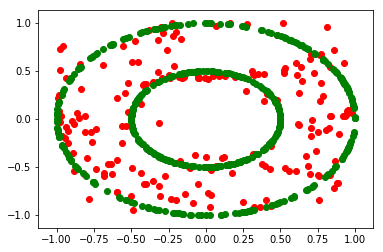

30000 [D loss: 0.691571, acc.: 53.12%] [G loss: 0.692463]


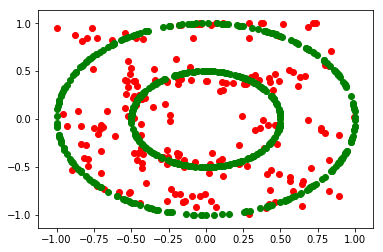

32000 [D loss: 0.692458, acc.: 62.50%] [G loss: 0.696790]


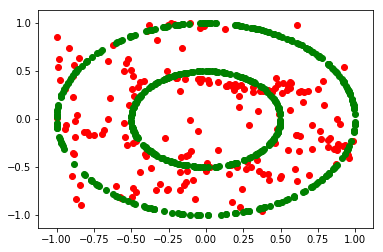

34000 [D loss: 0.693593, acc.: 53.12%] [G loss: 0.694997]


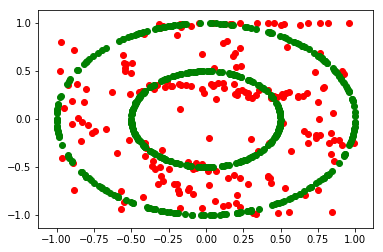

36000 [D loss: 0.692079, acc.: 56.25%] [G loss: 0.692458]


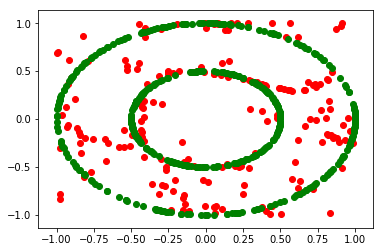

38000 [D loss: 0.692574, acc.: 56.25%] [G loss: 0.693961]


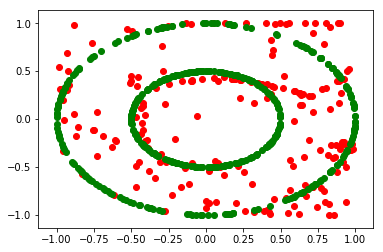

40000 [D loss: 0.692398, acc.: 53.12%] [G loss: 0.692239]


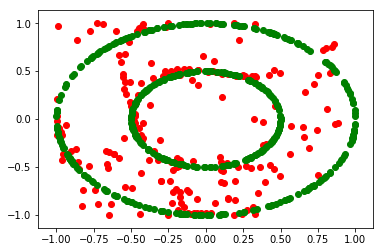

42000 [D loss: 0.694097, acc.: 46.88%] [G loss: 0.690899]


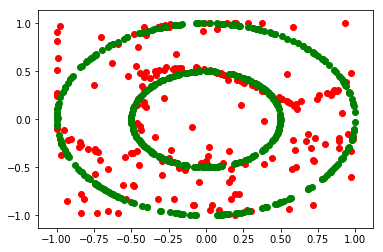

44000 [D loss: 0.693517, acc.: 40.62%] [G loss: 0.695171]


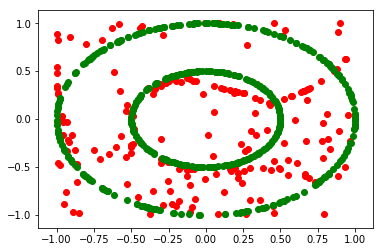

46000 [D loss: 0.692408, acc.: 54.69%] [G loss: 0.694332]


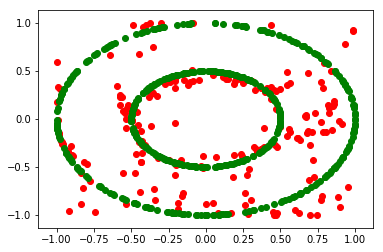

48000 [D loss: 0.693048, acc.: 53.12%] [G loss: 0.692284]


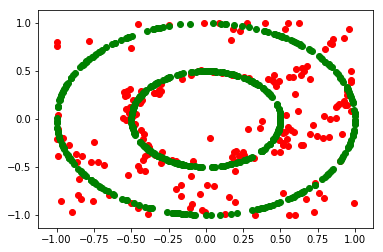

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/circles/circle_factor_5.npy', 2, 2, 'drive/My Drive/Vanilla-GAN-Circles-factor-5', 50000)

In [0]:
clear_dir('drive/My Drive/Vanilla-GAN-Circles-factor-5/')

FileNotFoundError: ignored

### Eval on S Curve noise 5

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_81 (Dense)             (None, 8)                 32        
_________________________________________________________________
leaky_re_lu_61 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_82 (Dense)             (None, 16)                144       
_________________________________________________________________
leaky_re_lu_62 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_83 (Dense)             (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_63 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_84 (Dense)             (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.720498, acc.: 31.25%] [G loss: 0.726705]


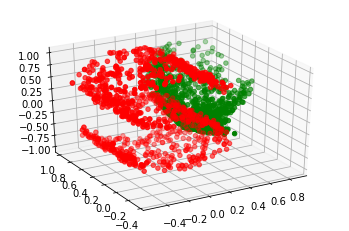

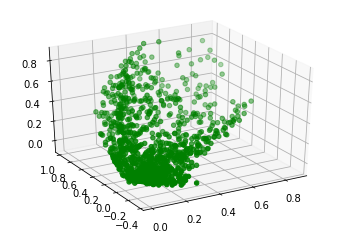

2000 [D loss: 0.574302, acc.: 82.81%] [G loss: 0.908979]


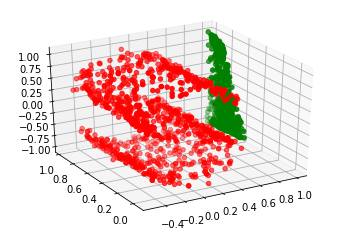

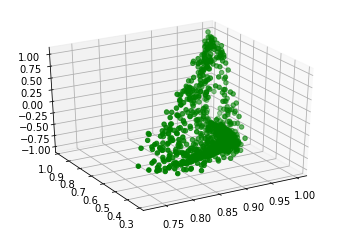

4000 [D loss: 0.697197, acc.: 46.88%] [G loss: 0.718623]


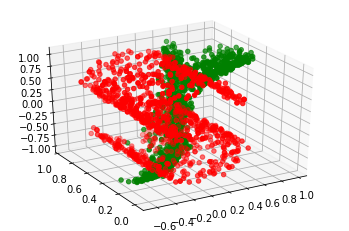

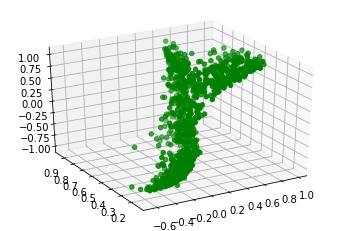

6000 [D loss: 0.690459, acc.: 54.69%] [G loss: 0.711380]


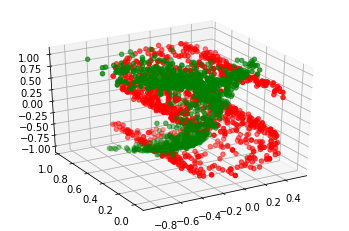

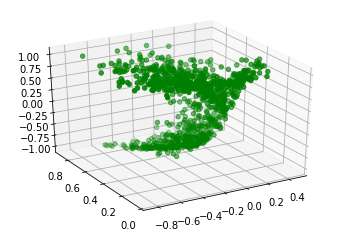

8000 [D loss: 0.694626, acc.: 65.62%] [G loss: 0.682091]


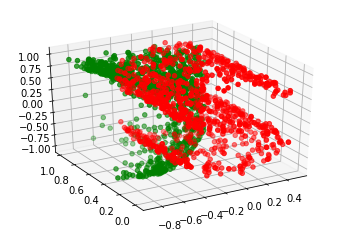

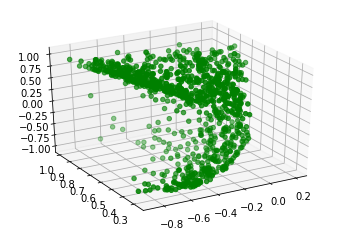

10000 [D loss: 0.681487, acc.: 68.75%] [G loss: 0.725770]


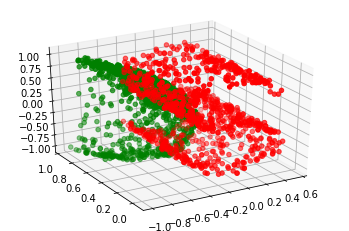

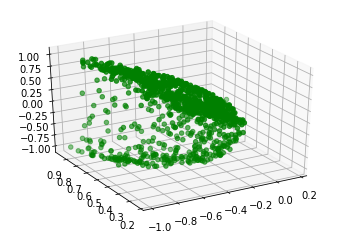

12000 [D loss: 0.688494, acc.: 56.25%] [G loss: 0.707203]


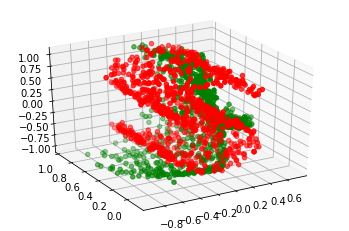

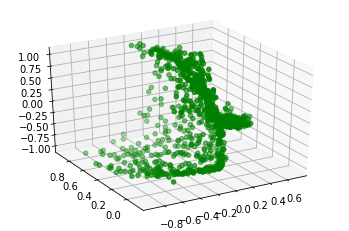

14000 [D loss: 0.688848, acc.: 70.31%] [G loss: 0.692550]


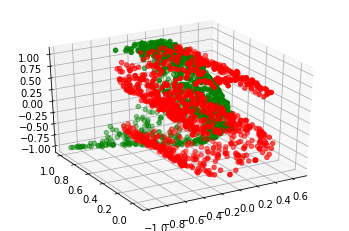

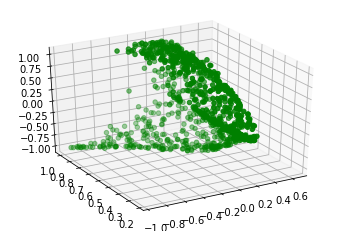

16000 [D loss: 0.692749, acc.: 39.06%] [G loss: 0.691739]


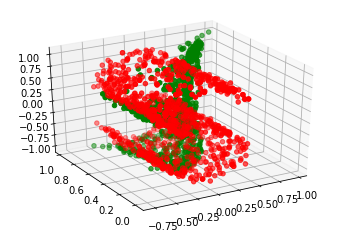

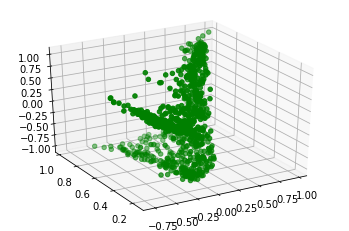

18000 [D loss: 0.694034, acc.: 56.25%] [G loss: 0.715104]


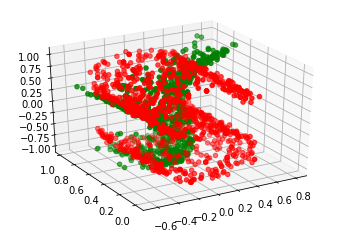

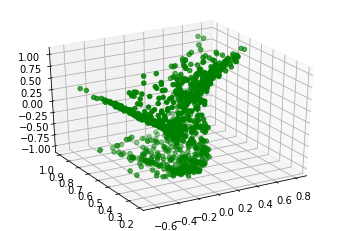

20000 [D loss: 0.689215, acc.: 51.56%] [G loss: 0.708396]


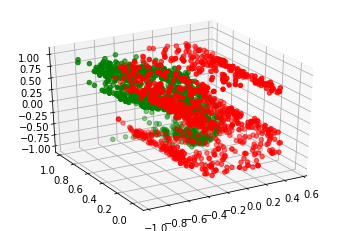

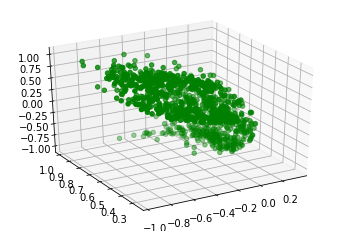

22000 [D loss: 0.697733, acc.: 53.12%] [G loss: 0.717351]


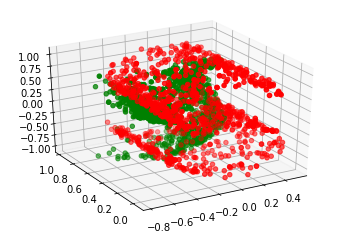

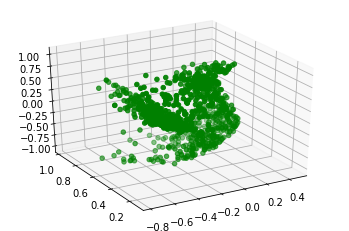

24000 [D loss: 0.694278, acc.: 46.88%] [G loss: 0.714743]


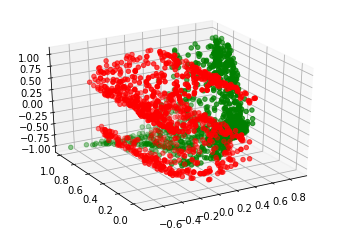

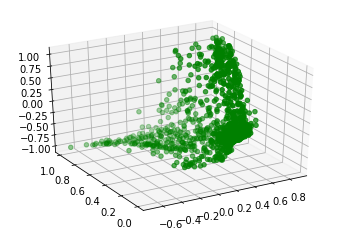

26000 [D loss: 0.683696, acc.: 64.06%] [G loss: 0.686111]


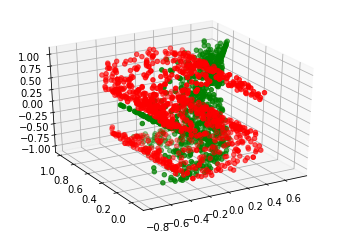

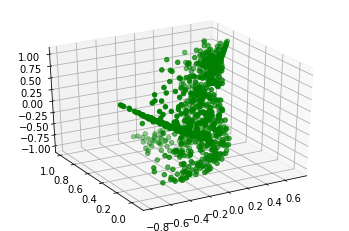

28000 [D loss: 0.689719, acc.: 53.12%] [G loss: 0.704709]


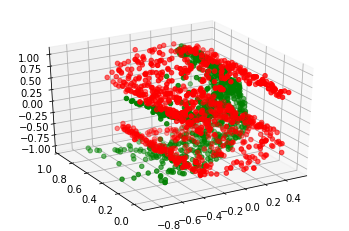

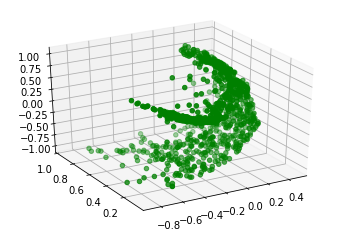

30000 [D loss: 0.695863, acc.: 46.88%] [G loss: 0.692114]


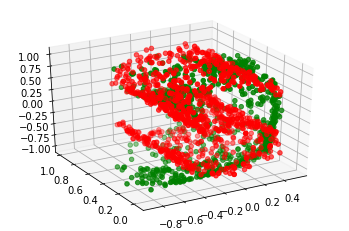

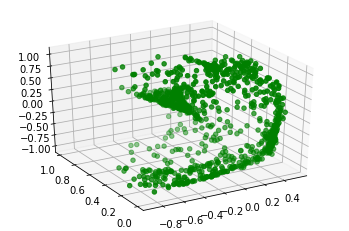

32000 [D loss: 0.689058, acc.: 57.81%] [G loss: 0.725692]


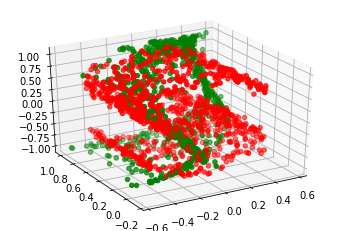

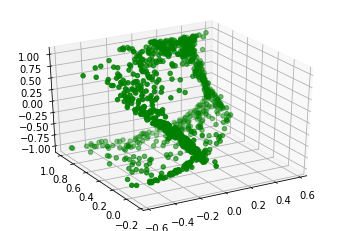

34000 [D loss: 0.689294, acc.: 50.00%] [G loss: 0.691258]


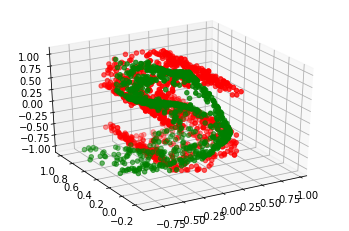

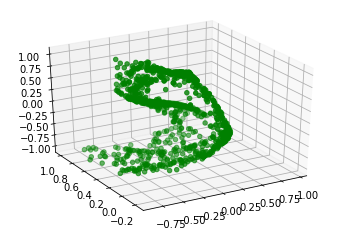

36000 [D loss: 0.689843, acc.: 62.50%] [G loss: 0.706128]


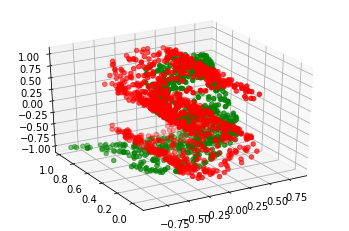

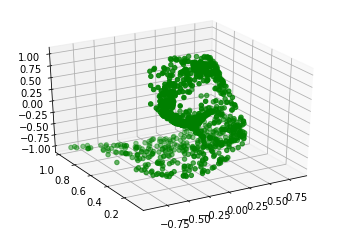

38000 [D loss: 0.692502, acc.: 43.75%] [G loss: 0.696905]


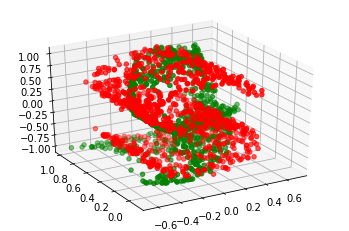

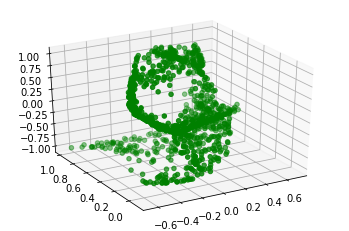

40000 [D loss: 0.695098, acc.: 50.00%] [G loss: 0.696870]


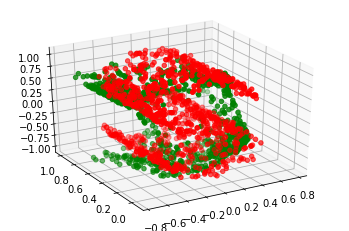

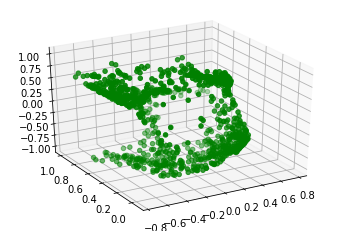

42000 [D loss: 0.692141, acc.: 48.44%] [G loss: 0.709756]


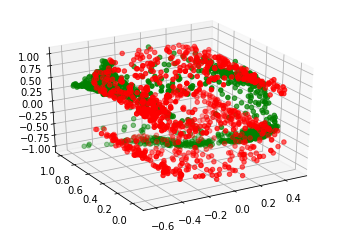

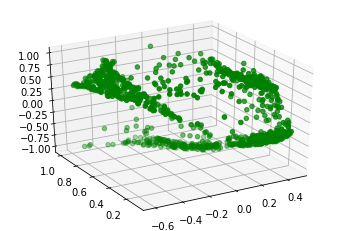

44000 [D loss: 0.690206, acc.: 48.44%] [G loss: 0.696237]


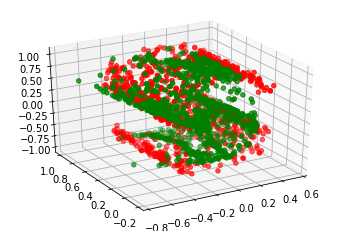

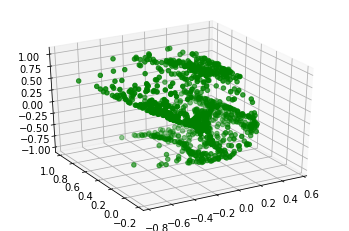

46000 [D loss: 0.687174, acc.: 57.81%] [G loss: 0.687787]


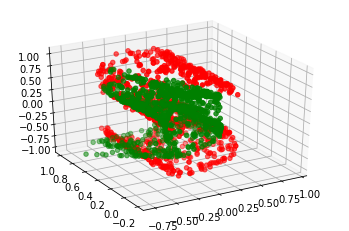

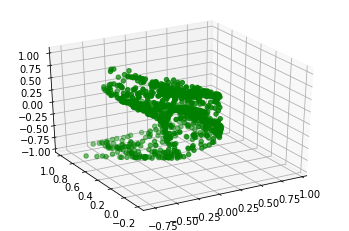

48000 [D loss: 0.689773, acc.: 53.12%] [G loss: 0.690735]


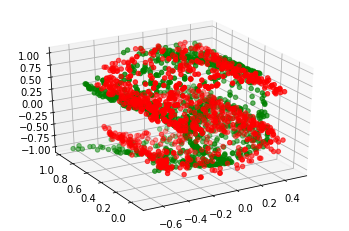

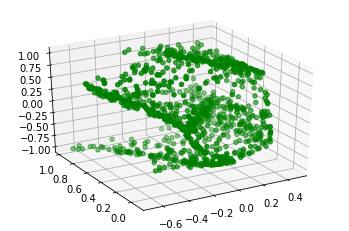

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/s_curves/scurve_noise_5.npy', 3, 3, 'drive/My Drive/Vanilla-GAN-SCurve-factor-5', 50000)

In [0]:
clear_dir('drive/My Drive/Vanilla-GAN-SCurve-factor-5')

### Eval on Swiss roll noise 5

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_57 (Dense)             (None, 8)                 32        
_________________________________________________________________
leaky_re_lu_43 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_58 (Dense)             (None, 16)                144       
_________________________________________________________________
leaky_re_lu_44 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_59 (Dense)             (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_45 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_60 (Dense)             (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.708805, acc.: 26.56%] [G loss: 0.655571]


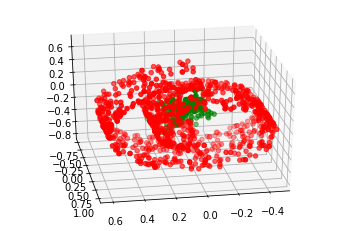

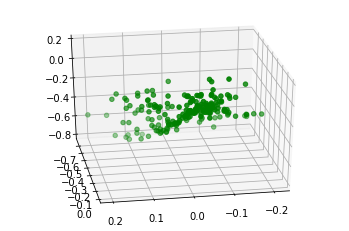

2000 [D loss: 0.684848, acc.: 65.62%] [G loss: 0.728220]


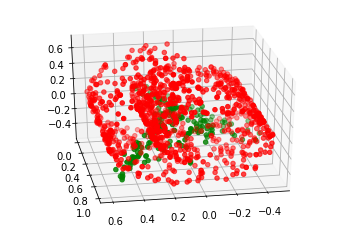

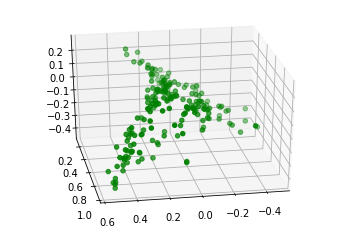

4000 [D loss: 0.674336, acc.: 65.62%] [G loss: 0.687353]


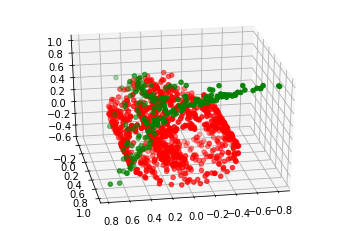

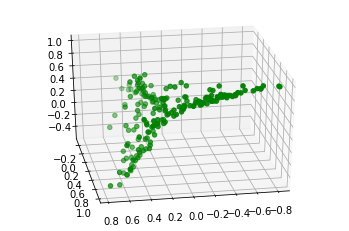

6000 [D loss: 0.691403, acc.: 59.38%] [G loss: 0.701421]


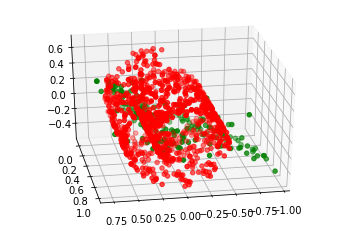

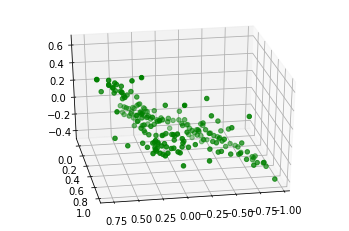

8000 [D loss: 0.693949, acc.: 50.00%] [G loss: 0.683597]


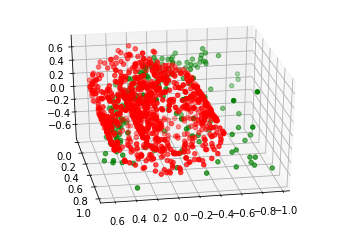

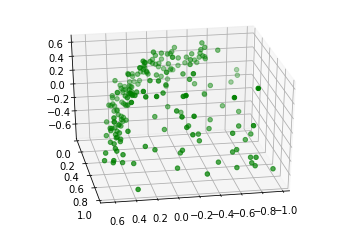

10000 [D loss: 0.692029, acc.: 56.25%] [G loss: 0.689727]


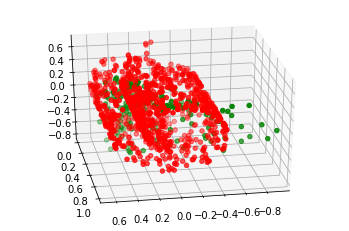

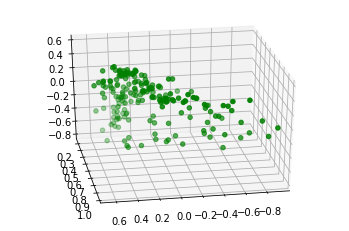

12000 [D loss: 0.691291, acc.: 56.25%] [G loss: 0.701421]


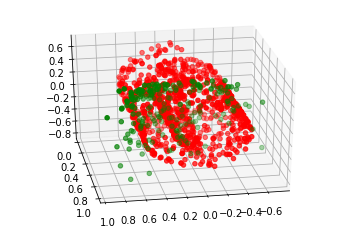

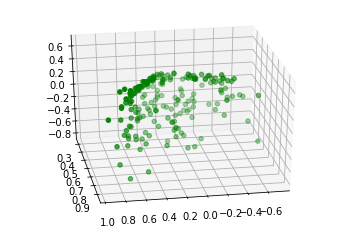

14000 [D loss: 0.692261, acc.: 56.25%] [G loss: 0.700690]


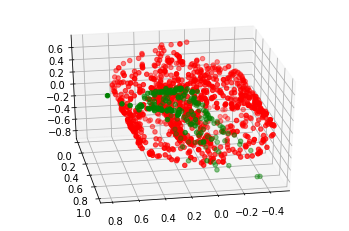

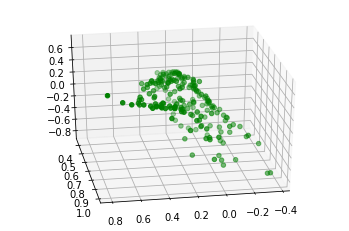

16000 [D loss: 0.687064, acc.: 65.62%] [G loss: 0.690071]


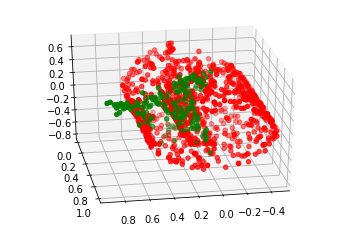

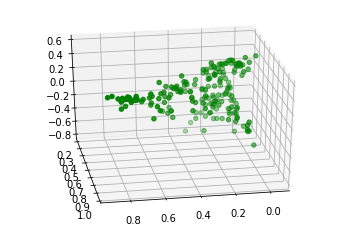

18000 [D loss: 0.702682, acc.: 43.75%] [G loss: 0.689415]


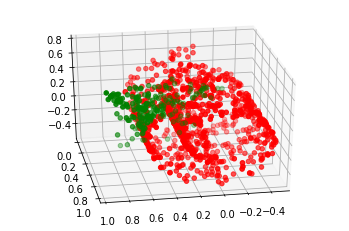

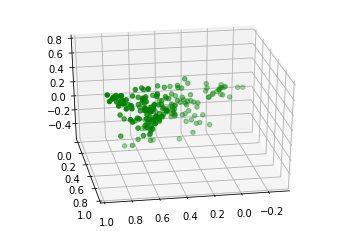

20000 [D loss: 0.691396, acc.: 53.12%] [G loss: 0.703127]


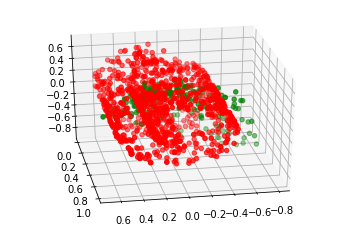

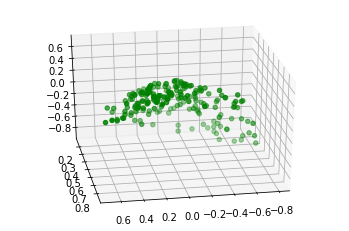

22000 [D loss: 0.694399, acc.: 40.62%] [G loss: 0.683705]


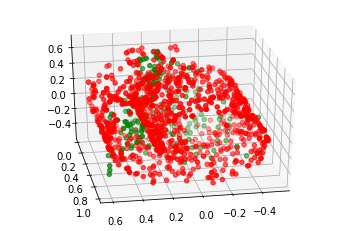

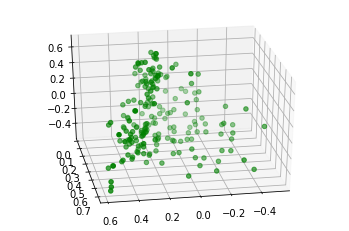

24000 [D loss: 0.693194, acc.: 51.56%] [G loss: 0.695481]


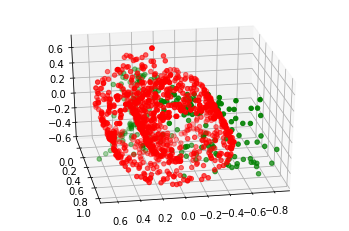

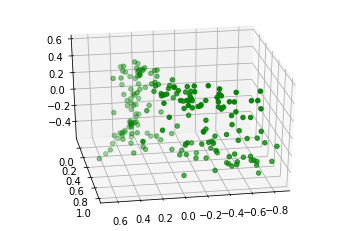

26000 [D loss: 0.690212, acc.: 51.56%] [G loss: 0.712894]


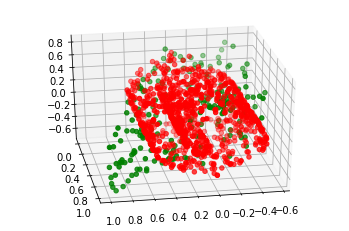

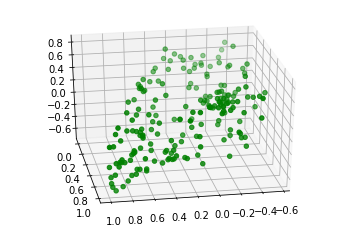

28000 [D loss: 0.691459, acc.: 51.56%] [G loss: 0.697995]


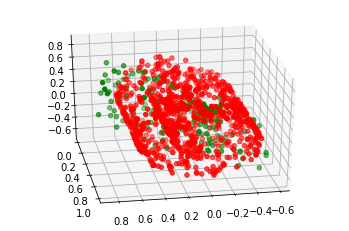

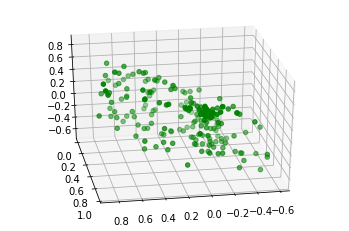

30000 [D loss: 0.687554, acc.: 62.50%] [G loss: 0.712723]


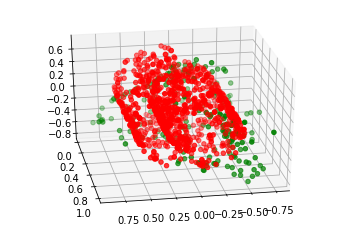

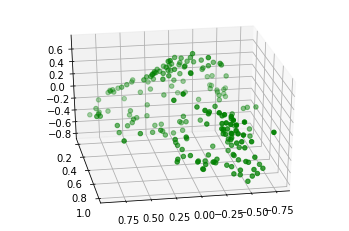

32000 [D loss: 0.690080, acc.: 57.81%] [G loss: 0.700889]


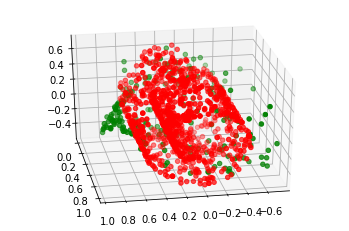

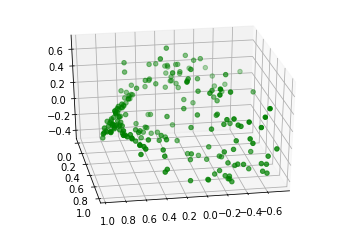

34000 [D loss: 0.692837, acc.: 46.88%] [G loss: 0.686702]


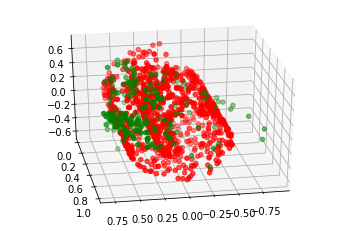

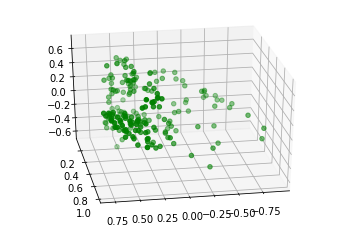

36000 [D loss: 0.693722, acc.: 45.31%] [G loss: 0.684893]


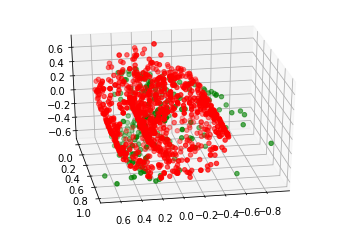

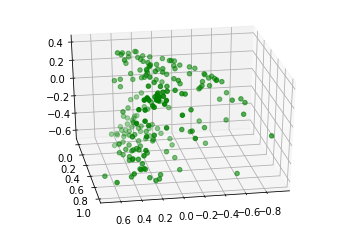

38000 [D loss: 0.693808, acc.: 43.75%] [G loss: 0.681808]


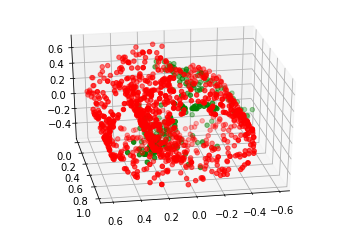

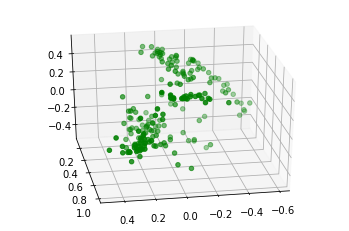

40000 [D loss: 0.694330, acc.: 42.19%] [G loss: 0.695771]


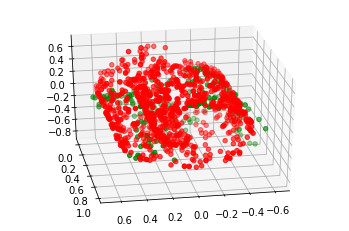

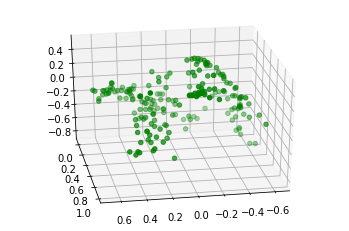

42000 [D loss: 0.691266, acc.: 57.81%] [G loss: 0.701848]


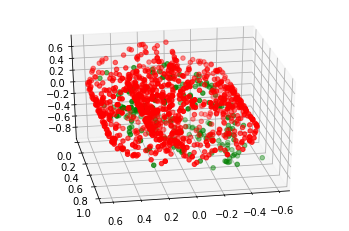

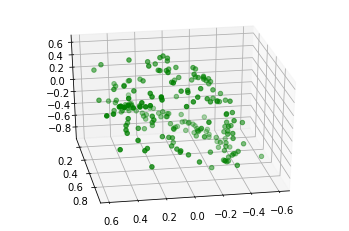

44000 [D loss: 0.694161, acc.: 40.62%] [G loss: 0.695135]


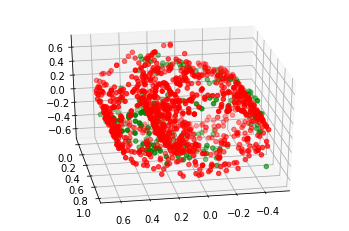

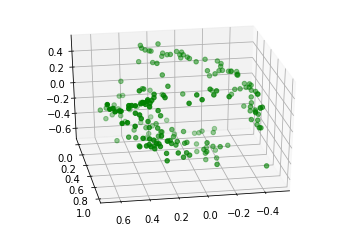

46000 [D loss: 0.693177, acc.: 46.88%] [G loss: 0.694199]


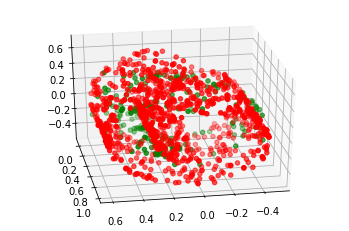

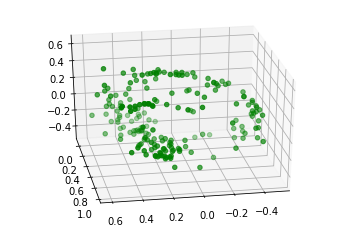

48000 [D loss: 0.693473, acc.: 53.12%] [G loss: 0.693758]


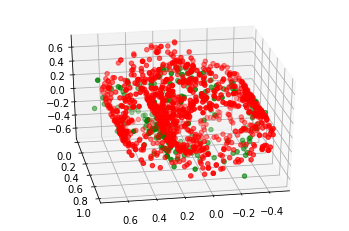

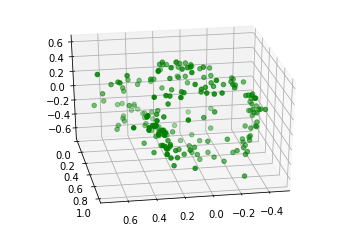

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/swiss_roll/roll_noise_5.npy', 3, 3, 'drive/My Drive/Vanilla-GAN-SwissRoll-noise-5', 50000, 80)

In [0]:
clear_dir('drive/My Drive/Vanilla-GAN-SwissRoll-noise-5')

FileNotFoundError: ignored

### Eval on Blobs with 3 centers

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_105 (Dense)            (None, 8)                 24        
_________________________________________________________________
leaky_re_lu_79 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_106 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_80 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_107 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_81 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_108 (Dense)            (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.720732, acc.: 60.94%] [G loss: 0.716866]


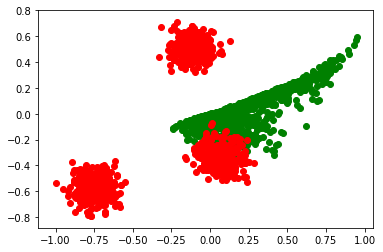

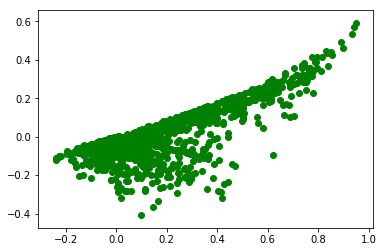

2000 [D loss: 0.662792, acc.: 65.62%] [G loss: 0.748339]


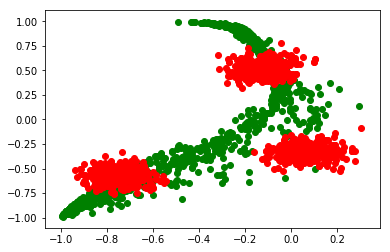

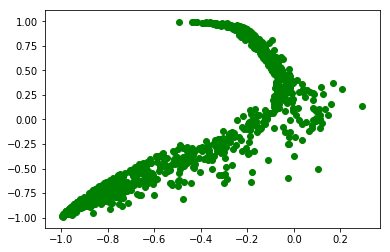

4000 [D loss: 0.691155, acc.: 57.81%] [G loss: 0.710678]


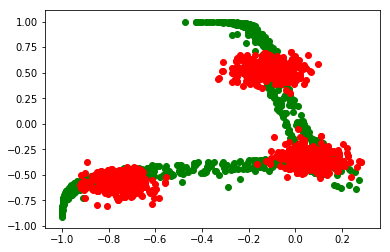

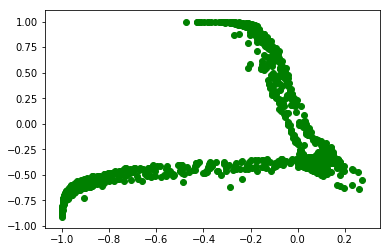

6000 [D loss: 0.684652, acc.: 54.69%] [G loss: 0.721038]


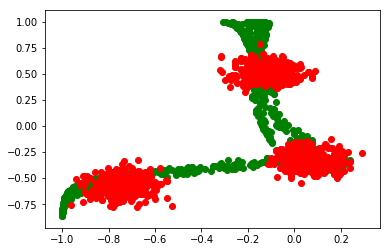

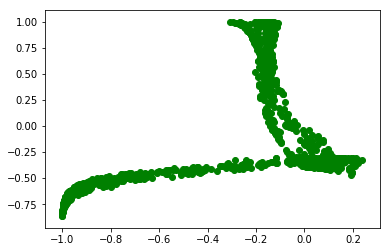

8000 [D loss: 0.679900, acc.: 67.19%] [G loss: 0.721196]


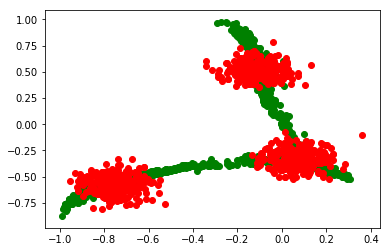

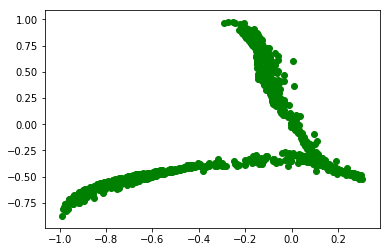

10000 [D loss: 0.689929, acc.: 57.81%] [G loss: 0.696993]


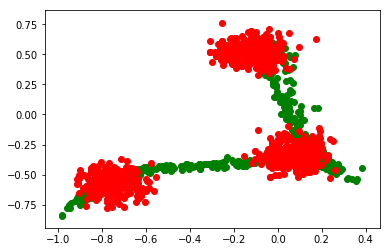

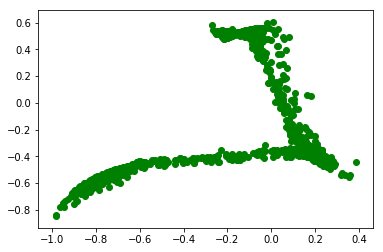

12000 [D loss: 0.692573, acc.: 43.75%] [G loss: 0.683222]


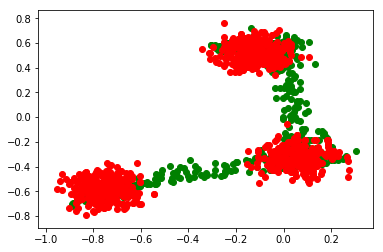

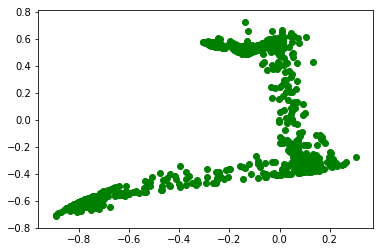

14000 [D loss: 0.688054, acc.: 53.12%] [G loss: 0.709406]


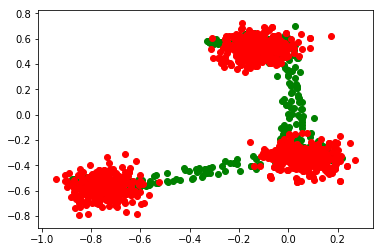

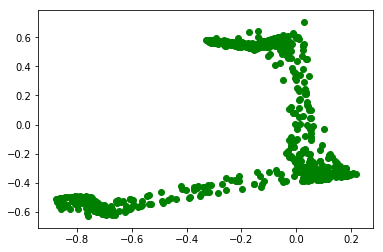

16000 [D loss: 0.687963, acc.: 60.94%] [G loss: 0.690050]


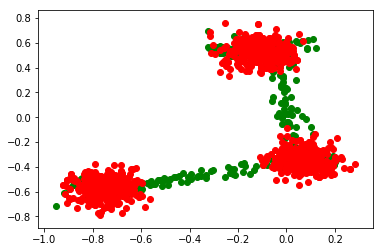

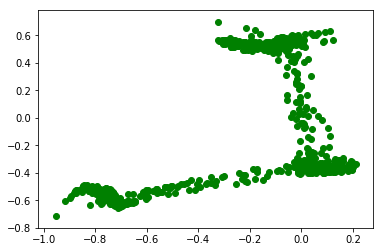

18000 [D loss: 0.690905, acc.: 54.69%] [G loss: 0.685656]


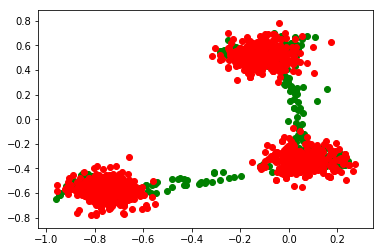

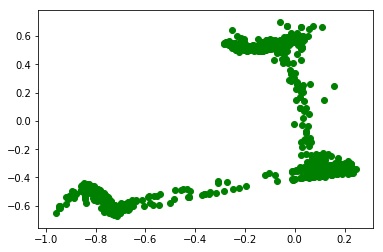

20000 [D loss: 0.689539, acc.: 50.00%] [G loss: 0.696465]


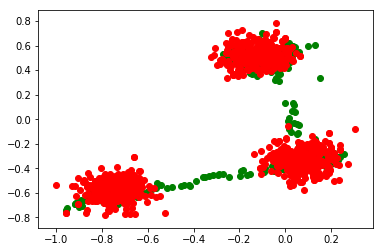

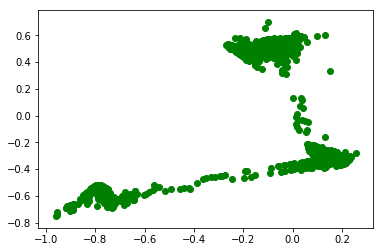

22000 [D loss: 0.691070, acc.: 46.88%] [G loss: 0.691677]


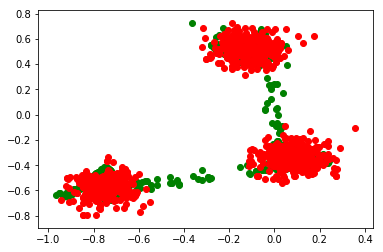

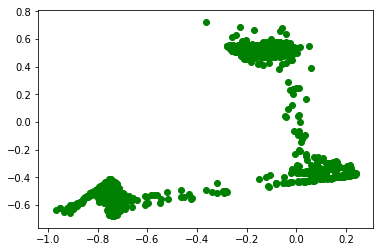

24000 [D loss: 0.687584, acc.: 45.31%] [G loss: 0.700217]


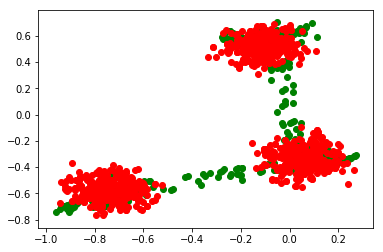

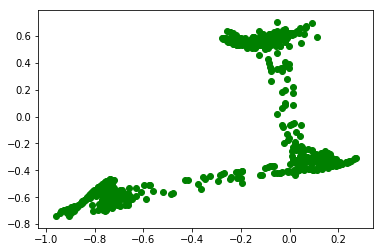

26000 [D loss: 0.687503, acc.: 43.75%] [G loss: 0.707377]


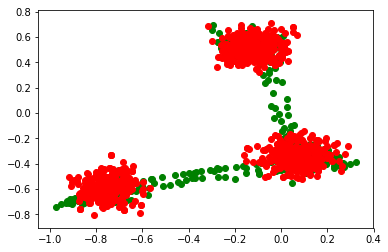

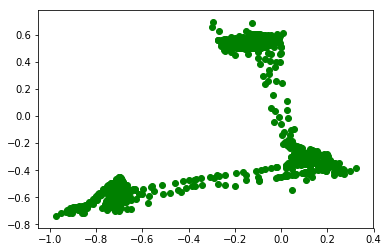

28000 [D loss: 0.693267, acc.: 42.19%] [G loss: 0.699762]


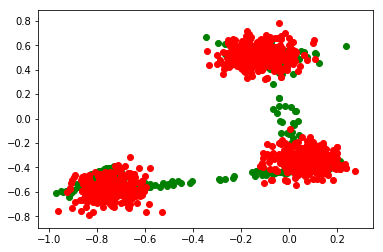

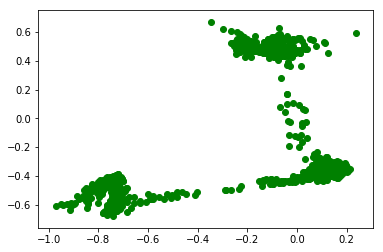

30000 [D loss: 0.685702, acc.: 40.62%] [G loss: 0.687986]


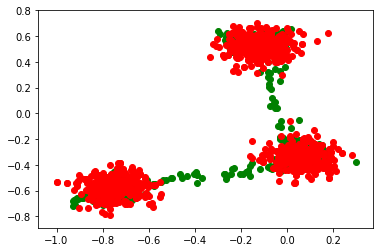

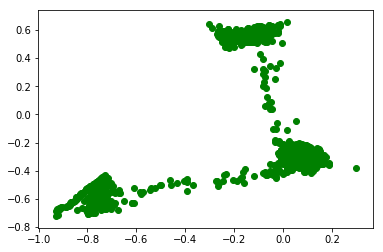

32000 [D loss: 0.691870, acc.: 37.50%] [G loss: 0.706795]


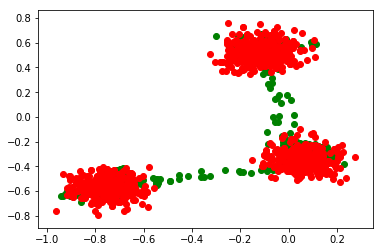

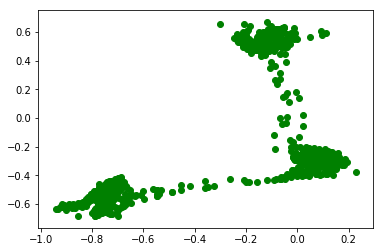

34000 [D loss: 0.694610, acc.: 56.25%] [G loss: 0.701500]


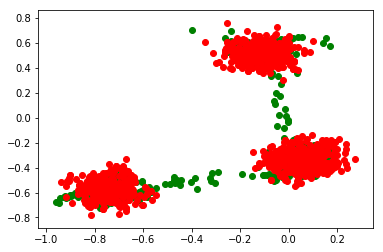

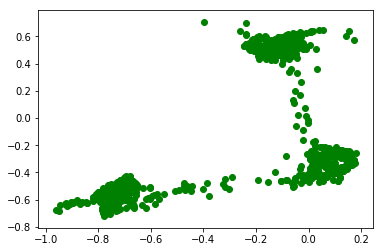

36000 [D loss: 0.689901, acc.: 54.69%] [G loss: 0.695530]


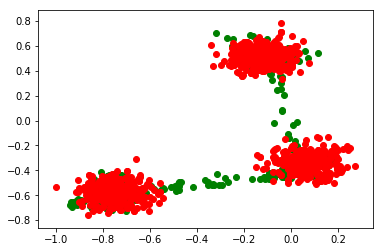

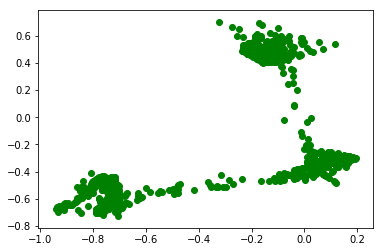

38000 [D loss: 0.691263, acc.: 53.12%] [G loss: 0.707919]


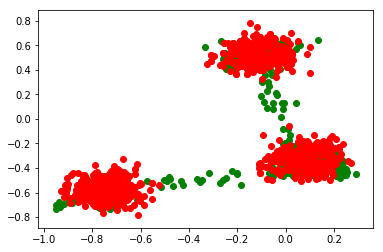

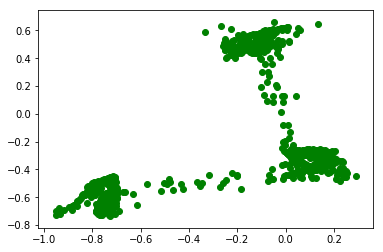

40000 [D loss: 0.696108, acc.: 42.19%] [G loss: 0.703413]


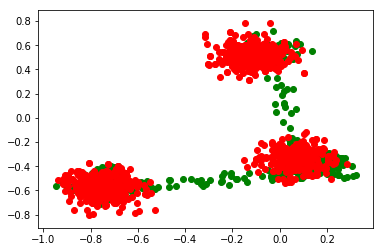

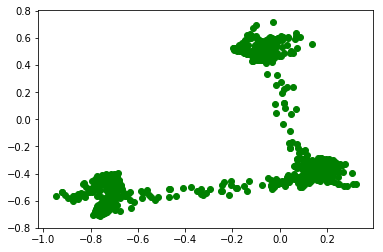

42000 [D loss: 0.691913, acc.: 54.69%] [G loss: 0.691417]


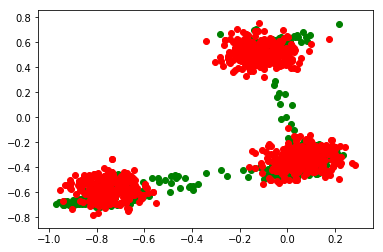

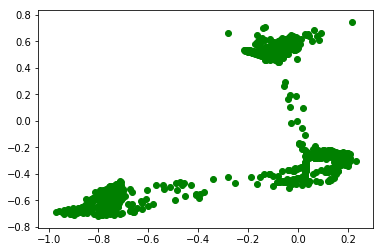

44000 [D loss: 0.692139, acc.: 56.25%] [G loss: 0.705922]


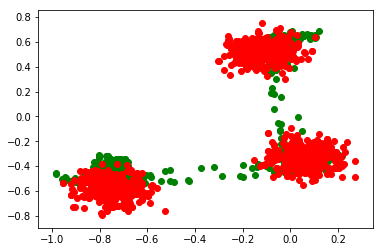

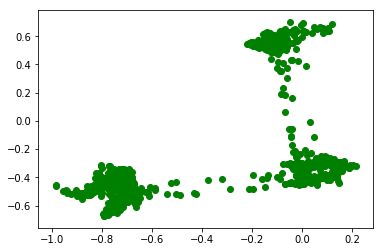

46000 [D loss: 0.691745, acc.: 51.56%] [G loss: 0.692445]


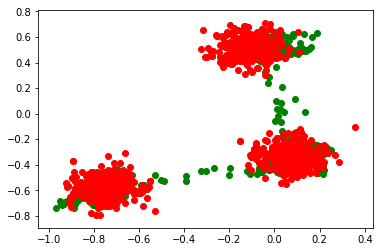

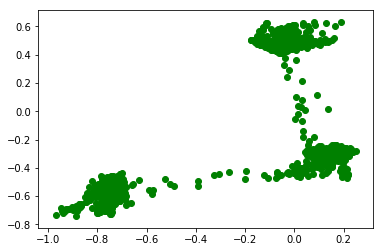

48000 [D loss: 0.686734, acc.: 45.31%] [G loss: 0.700864]


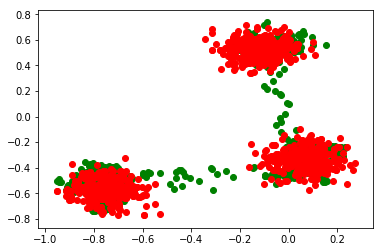

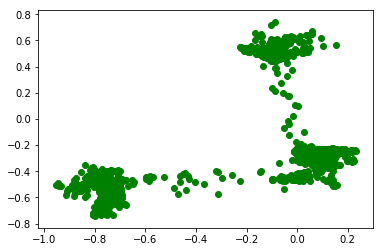

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/blobs/blobs_3.npy', 2, 2, 'drive/My Drive/Vanilla-GAN-Blobs-3', 50000, 80)

In [0]:
clear_dir('drive/My Drive/Vanilla-GAN-Blobs-3')

## WGAN-GP for point data

### Class and Utilities

In [0]:
class RandomWeightedAverage(_Merge):
    """Provides a (random) weighted average between real and generated image samples"""
    def _merge_function(self, inputs):
        alpha = K.random_uniform((32, 1, 1, 1))
        return (alpha * inputs[0]) + ((1 - alpha) * inputs[1])

class WGANGP_point():
    def __init__(self, X_train, out_shape, latent_dim, save_path):
        self.out_shape = out_shape
        self.latent_dim = latent_dim
        self.dataset = X_train
        self.save_path = save_path

        # Following parameter and optimizer set as recommended in paper
        self.n_critic = 5
        optimizer = RMSprop(lr=0.00005)

        # Build the generator and critic
        self.generator = self.build_generator()
        self.critic = self.build_critic()

        #-------------------------------
        # Construct Computational Graph
        #       for the Critic
        #-------------------------------

        # Freeze generator's layers while training critic
        self.generator.trainable = False

        # Image input (real sample)
        real_img = Input(shape=(self.out_shape,))

        # Noise input
        z_disc = Input(shape=(self.latent_dim,))
        # Generate image based of noise (fake sample)
        fake_img = self.generator(z_disc)

        # Discriminator determines validity of the real and fake images
        fake = self.critic(fake_img)
        valid = self.critic(real_img)

        # Construct weighted average between real and fake images
        print(real_img.shape)
        interpolated_img = RandomWeightedAverage()([real_img, fake_img])
        # Determine validity of weighted sample
        validity_interpolated = self.critic(interpolated_img)

        # Use Python partial to provide loss function with additional
        # 'averaged_samples' argument
        partial_gp_loss = partial(self.gradient_penalty_loss,
                          averaged_samples=interpolated_img)
        partial_gp_loss.__name__ = 'gradient_penalty' # Keras requires function names

        self.critic_model = Model(inputs=[real_img, z_disc],
                            outputs=[valid, fake, validity_interpolated])
        self.critic_model.compile(loss=[self.wasserstein_loss,
                                              self.wasserstein_loss,
                                              partial_gp_loss],
                                        optimizer=optimizer,
                                        loss_weights=[1, 1, 10])
        #-------------------------------
        # Construct Computational Graph
        #         for Generator
        #-------------------------------

        # For the generator we freeze the critic's layers
        self.critic.trainable = False
        self.generator.trainable = True

        # Sampled noise for input to generator
        z_gen = Input(shape=(self.latent_dim,))
        # Generate images based of noise
        img = self.generator(z_gen)
        # Discriminator determines validity
        valid = self.critic(img)
        # Defines generator model
        self.generator_model = Model(z_gen, valid)
        self.generator_model.compile(loss=self.wasserstein_loss, optimizer=optimizer)


    def gradient_penalty_loss(self, y_true, y_pred, averaged_samples):
        """
        Computes gradient penalty based on prediction and weighted real / fake samples
        """
        gradients = K.gradients(y_pred, averaged_samples)[0]
        # compute the euclidean norm by squaring ...
        gradients_sqr = K.square(gradients)
        #   ... summing over the rows ...
        gradients_sqr_sum = K.sum(gradients_sqr,
                                  axis=np.arange(1, len(gradients_sqr.shape)))
        #   ... and sqrt
        gradient_l2_norm = K.sqrt(gradients_sqr_sum)
        # compute lambda * (1 - ||grad||)^2 still for each single sample
        gradient_penalty = K.square(1 - gradient_l2_norm)
        # return the mean as loss over all the batch samples
        return K.mean(gradient_penalty)


    def wasserstein_loss(self, y_true, y_pred):
        return K.mean(y_true * y_pred)

    def build_generator(self):

        model = Sequential()

        model.add(Dense(8, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(16, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(8, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
    
        model.add(Dense(self.out_shape, activation='tanh'))
        model.summary()

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_critic(self):

        model = Sequential()

        model.add(Dense(8, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(16, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(8, input_dim=self.out_shape))
        model.add(LeakyReLU(alpha=0.2))

        model.add(Dense(1))

        model.summary()

        img = Input(shape=(self.out_shape,))
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size, sample_interval=50, azm = 240):
        # Load Dataset
        X_train = self.dataset
        print(X_train.shape)
        scale = max(abs(np.amin(X_train)), np.max(X_train))
        X_train = X_train/(scale)
        
        #X_train += np.reshape(np.random.normal(0, 0.1, X_train.shape[0]*X_train.shape[1]*X_train.shape[2]*X_train.shape[3]), X_train.shape)
        
        # Adversarial ground truths
        valid = -np.ones((batch_size, 1))
        fake =  np.ones((batch_size, 1))
        dummy = np.zeros((batch_size, 1)) # Dummy gt for gradient penalty
        
        gen_loss = []
        disc_loss = []
        for epoch in range(epochs):

            for _ in range(self.n_critic):

                # ---------------------
                #  Train Discriminator
                # ---------------------

                # Select a random batch of images
                idx = np.random.randint(0, X_train.shape[0], batch_size)
                imgs = X_train[idx]
                # Sample generator input
                noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
                '''
                noise = sklearn.datasets.make_s_curve(batch_size)[0]
                scale = max(np.max(noise), abs(np.amin(noise)))
                noise = noise/scale
                '''
                # Train the critic
                d_loss = self.critic_model.train_on_batch([imgs, noise],
                                                                [valid, fake, dummy])

            # ---------------------
            #  Train Generator
            # ---------------------

            g_loss = self.generator_model.train_on_batch(noise, valid)
            
            gen_loss.append(g_loss)
            disc_loss.append(d_loss[0])
            
            if epoch % sample_interval == 0:
              # Print the progress
              print ("%d [D loss: %f] [G loss: %f]" % (epoch, d_loss[0], g_loss))

            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:
                
                noise = np.random.normal(0, 1, (1000, self.latent_dim))
                gen_imgs = self.generator.predict(noise)
                
                # Save Snapshots of models, losses and samples
                
                # Save model snapshots
                model_dir = self.save_path + '/models/' + str(epoch) + '/'
                pathlib.Path(model_dir).mkdir(parents=True, exist_ok=True) 
                self.generator.save(model_dir + 'gen_' + str(epoch) + '.h5')
                self.critic.save(model_dir + 'critic_' + str(epoch) + '.h5')
                
                # Save Losses
                loss_dir = self.save_path + '/loss/' + str(epoch) + '/'
                pathlib.Path(loss_dir).mkdir(parents=True, exist_ok=True) 
                np.save(loss_dir + 'critic_loss', np.array(disc_loss))
                np.save(loss_dir + 'gen_loss', np.array(gen_loss))
                
                # Plot Samples
                idx = np.random.randint(0, high = 5000, size = 1000)
                
                if self.out_shape == 2:
                  x, y = X_train[idx,0], X_train[idx,1]
                  plt.figure(0)
                  plt.scatter(gen_imgs[:,0], gen_imgs[:,1], color = 'green')
                  plt.scatter(x, y, color = 'red')
                  
                  plt.figure(1)
                  plt.scatter(gen_imgs[:,0], gen_imgs[:,1], color = 'green')
                  plt.scatter(x, y, color = 'red')
                  
                  
                elif self.out_shape == 3:
                  x, y, z = X_train[idx,0], X_train[idx,1], X_train[idx,2]
                  
                  fig = plt.figure(0)
                  ax = fig.add_subplot(111, projection='3d')
                  ax.scatter(x, y, z, c='r', marker='o')
                  ax.scatter(gen_imgs[:,0], gen_imgs[:,1], gen_imgs[:,2], c='g', marker='o')
                  
                  ax.azim= azm
                  
                  
                  fig = plt.figure(1)
                  ax = fig.add_subplot(111, projection='3d')
                  ax.scatter(gen_imgs[:,0], gen_imgs[:,1], gen_imgs[:,2], c='g', marker='o')
                  
                  ax.azim= azm
                  
                  
                # Save samples
                sample_dir = self.save_path + '/samples/' + str(epoch) + '/'
                pathlib.Path(sample_dir).mkdir(parents=True, exist_ok=True) 
                plt.savefig(sample_dir + 'sample.png')
                
                plt.show()

### Eval on Circles factor 5

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_113 (Dense)            (None, 8)                 24        
_________________________________________________________________
leaky_re_lu_85 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_114 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_86 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_115 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_87 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_116 (Dense)            (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.694947, acc.: 57.81%] [G loss: 0.721989]


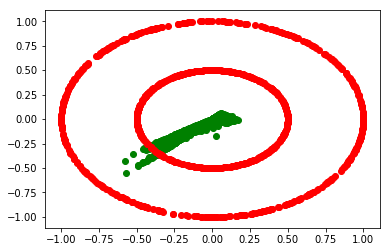

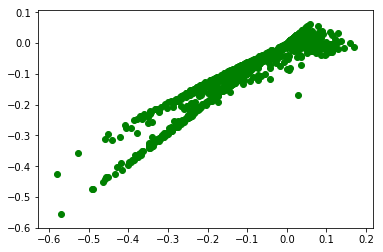

2000 [D loss: 0.688661, acc.: 64.06%] [G loss: 0.726121]


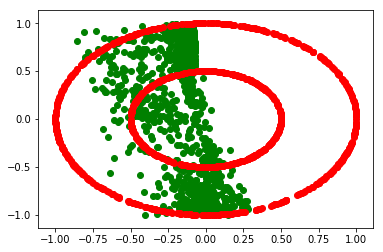

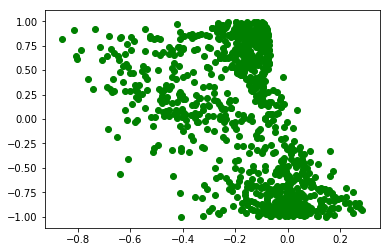

4000 [D loss: 0.705769, acc.: 46.88%] [G loss: 0.711087]


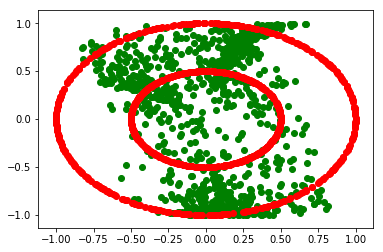

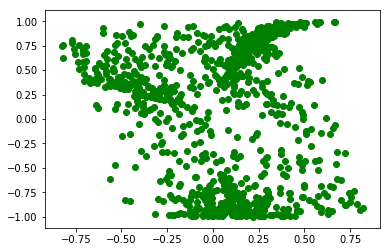

6000 [D loss: 0.699021, acc.: 48.44%] [G loss: 0.657647]


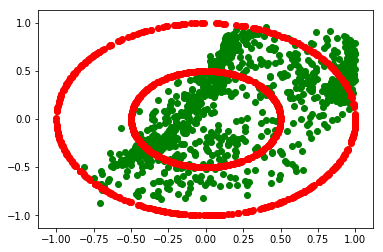

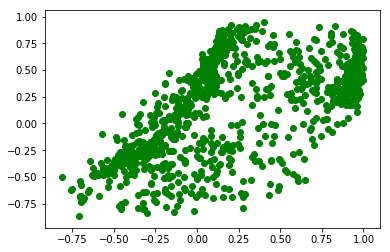

8000 [D loss: 0.689477, acc.: 50.00%] [G loss: 0.684876]


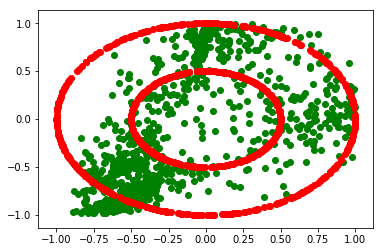

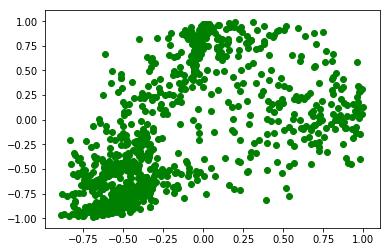

10000 [D loss: 0.691081, acc.: 57.81%] [G loss: 0.694311]


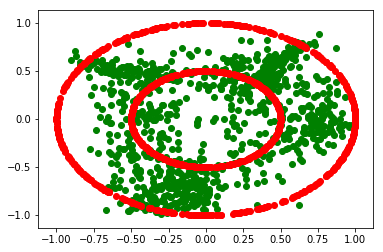

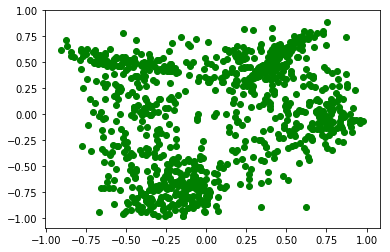

12000 [D loss: 0.687749, acc.: 43.75%] [G loss: 0.677308]


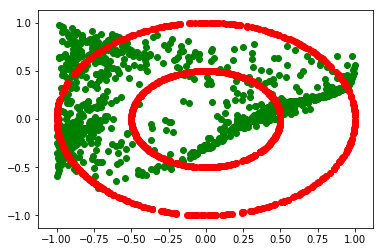

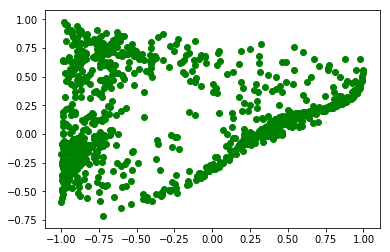

14000 [D loss: 0.688406, acc.: 57.81%] [G loss: 0.702739]


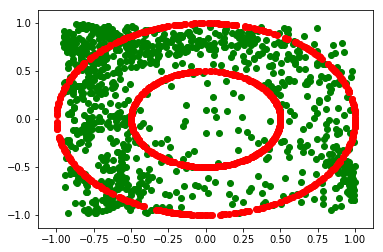

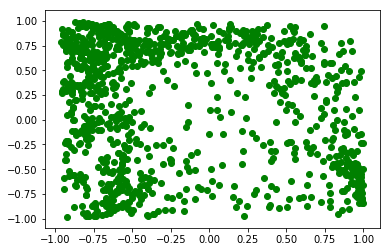

16000 [D loss: 0.693310, acc.: 54.69%] [G loss: 0.694472]


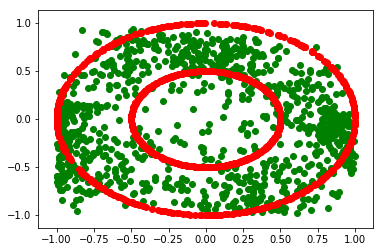

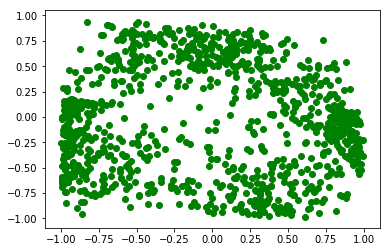

18000 [D loss: 0.696115, acc.: 42.19%] [G loss: 0.699377]


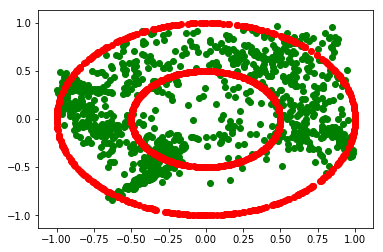

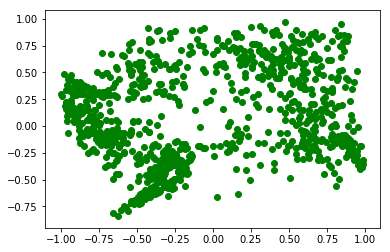

20000 [D loss: 0.688855, acc.: 56.25%] [G loss: 0.702918]


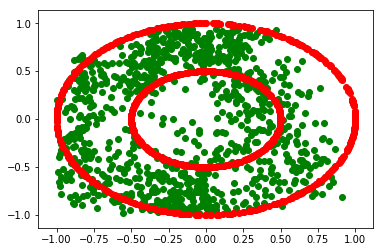

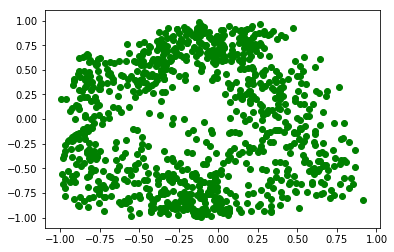

22000 [D loss: 0.694002, acc.: 54.69%] [G loss: 0.714357]


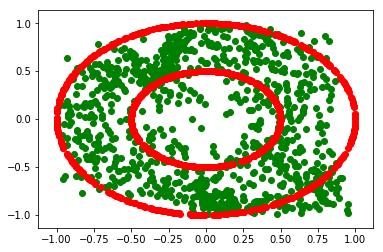

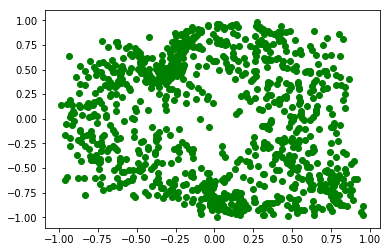

24000 [D loss: 0.693724, acc.: 48.44%] [G loss: 0.694998]


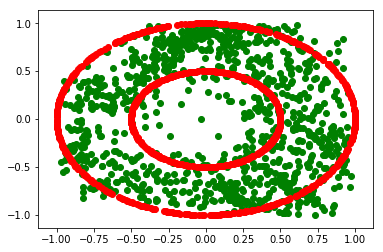

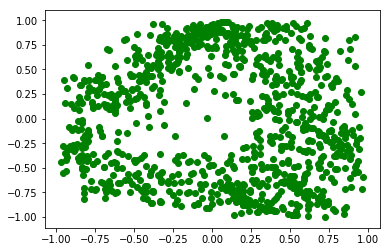

26000 [D loss: 0.694110, acc.: 48.44%] [G loss: 0.685586]


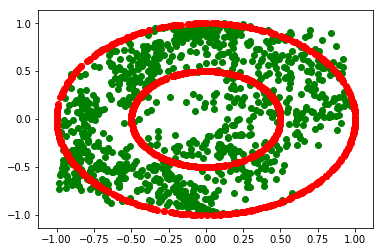

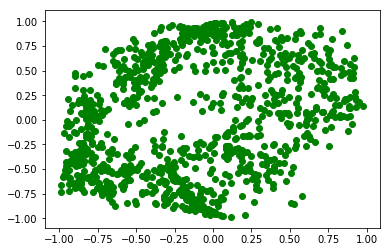

28000 [D loss: 0.692003, acc.: 60.94%] [G loss: 0.697634]


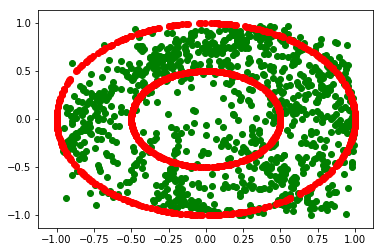

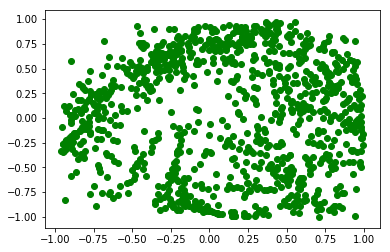

30000 [D loss: 0.692538, acc.: 50.00%] [G loss: 0.697160]


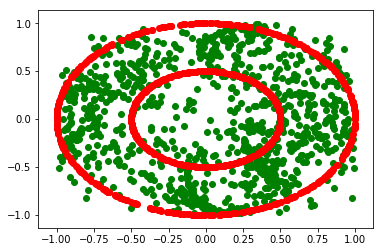

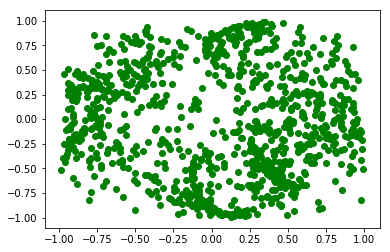

32000 [D loss: 0.689852, acc.: 64.06%] [G loss: 0.691589]


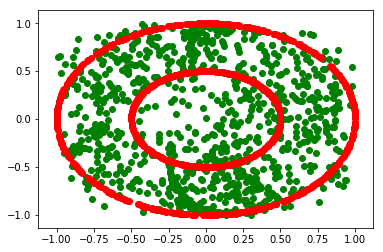

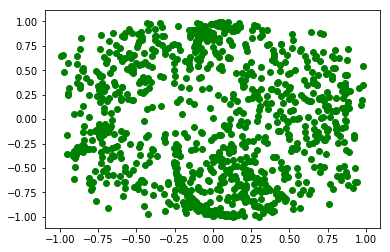

34000 [D loss: 0.694843, acc.: 53.12%] [G loss: 0.691661]


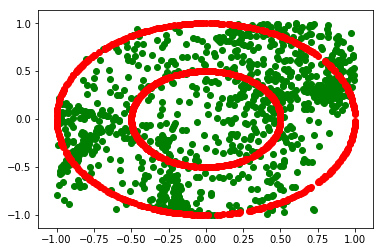

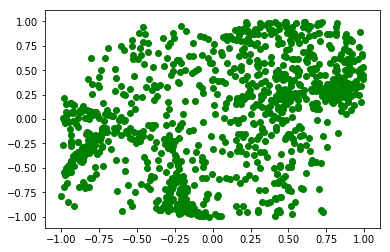

36000 [D loss: 0.689424, acc.: 62.50%] [G loss: 0.691686]


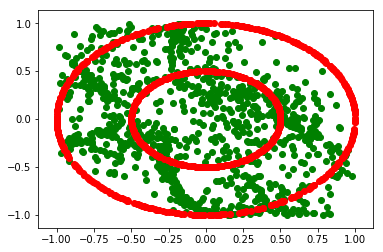

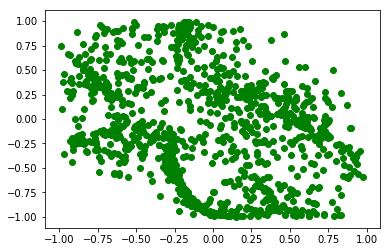

38000 [D loss: 0.691041, acc.: 59.38%] [G loss: 0.690505]


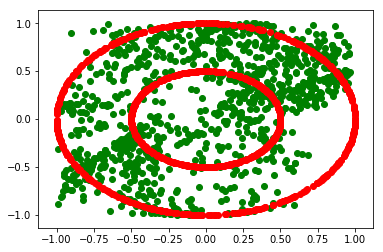

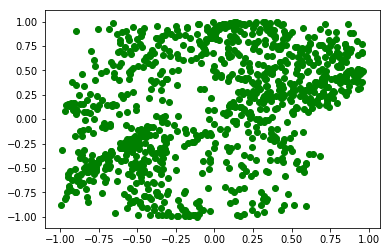

40000 [D loss: 0.690379, acc.: 57.81%] [G loss: 0.692869]


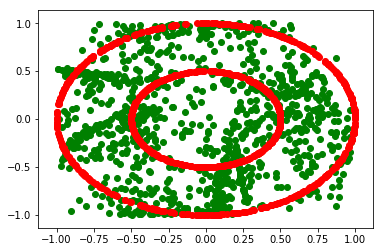

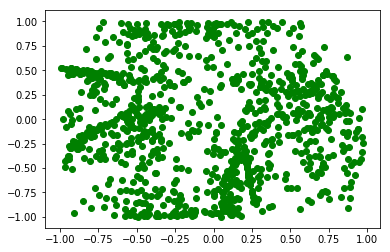

42000 [D loss: 0.692772, acc.: 37.50%] [G loss: 0.690719]


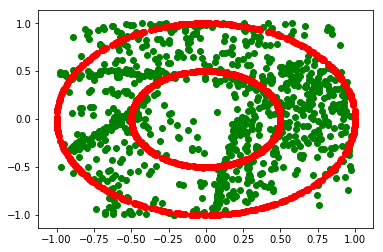

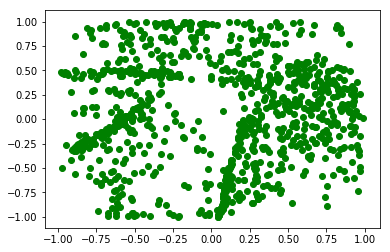

44000 [D loss: 0.689856, acc.: 56.25%] [G loss: 0.694377]


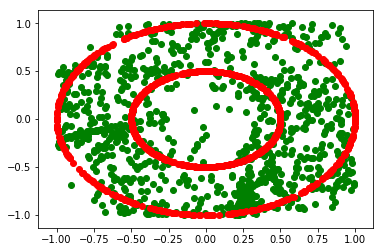

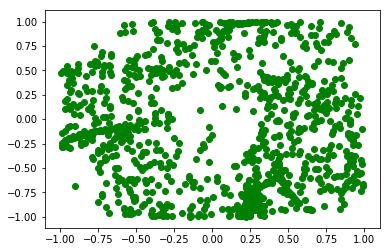

46000 [D loss: 0.688834, acc.: 60.94%] [G loss: 0.696579]


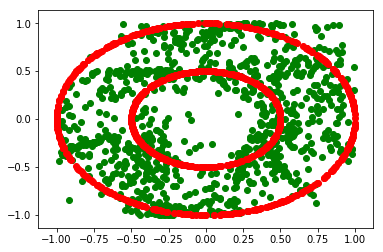

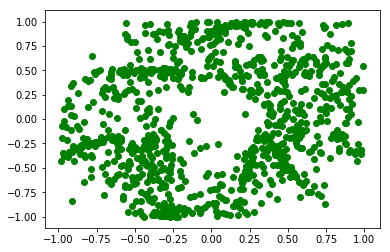

48000 [D loss: 0.691727, acc.: 59.38%] [G loss: 0.691418]


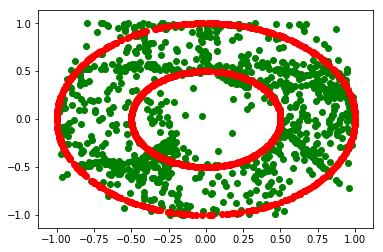

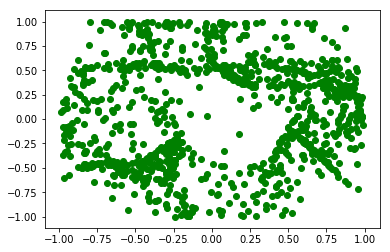

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/circles/circle_factor_5.npy', 2, 2, 'drive/My Drive/WGAN-Circles-factor-5', 50000)

In [0]:
clear_dir('drive/My Drive/WGAN-Circles-factor-5/')

### Eval on S curve factor 5 with S Curve Initialization

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_155 (Dense)            (None, 8)                 32        
_________________________________________________________________
leaky_re_lu_166 (LeakyReLU)  (None, 8)                 0         
_________________________________________________________________
dense_156 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_167 (LeakyReLU)  (None, 16)                0         
_________________________________________________________________
dense_157 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_168 (LeakyReLU)  (None, 8)                 0         
_________________________________________________________________
dense_158 (Dense)            (None, 3)                 27        
Total para

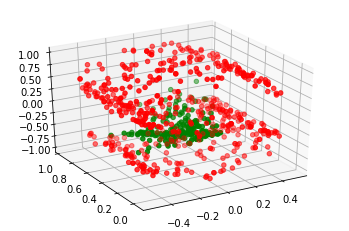

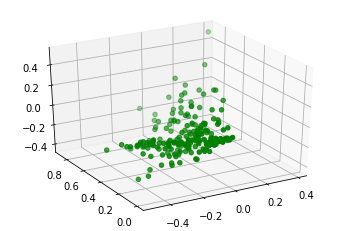

2000 [D loss: -0.026765] [G loss: 0.281214]


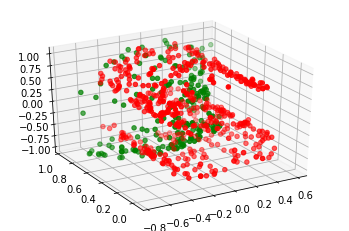

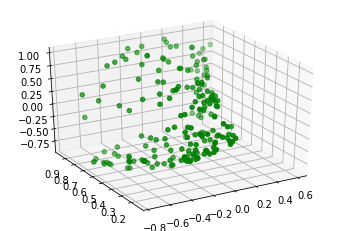

4000 [D loss: 0.042938] [G loss: 0.037642]


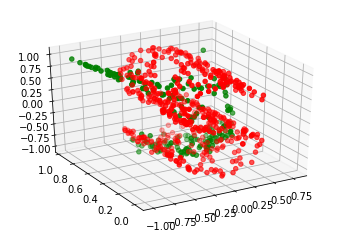

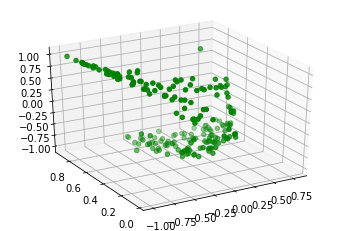

6000 [D loss: -0.015879] [G loss: -0.178256]


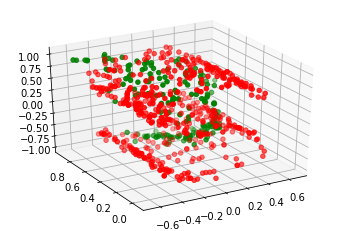

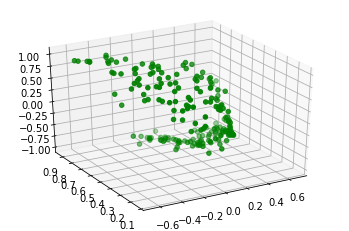

8000 [D loss: 0.009720] [G loss: -0.286687]


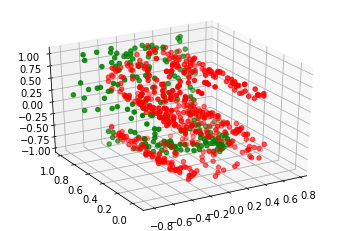

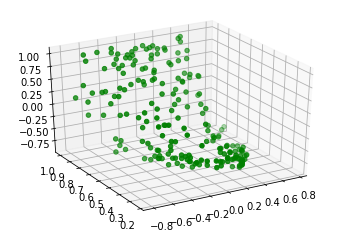

10000 [D loss: 0.004568] [G loss: -0.056391]


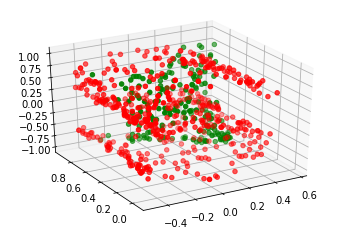

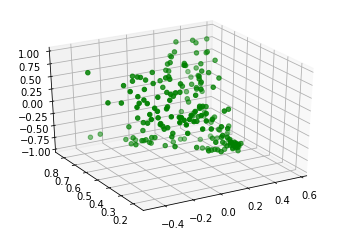

12000 [D loss: -0.012270] [G loss: -0.096494]


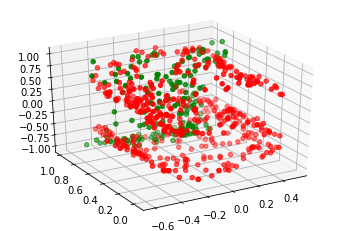

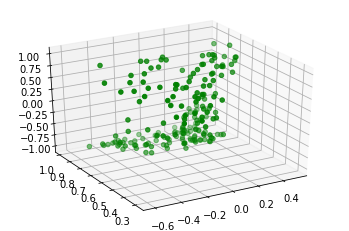

14000 [D loss: -0.010320] [G loss: -0.297833]


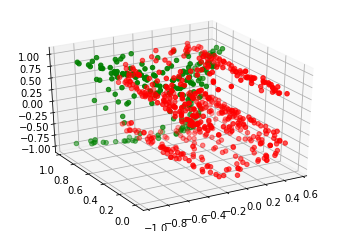

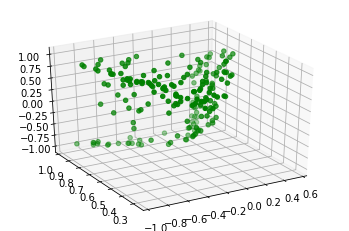

16000 [D loss: 0.014664] [G loss: -0.221313]


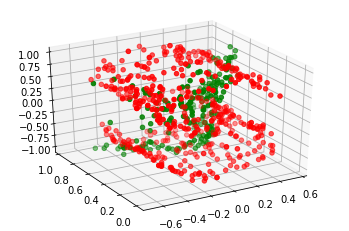

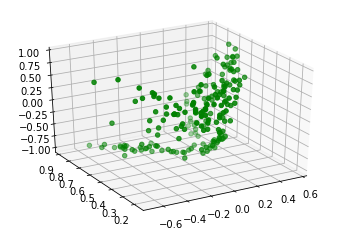

18000 [D loss: 0.038538] [G loss: -0.053999]


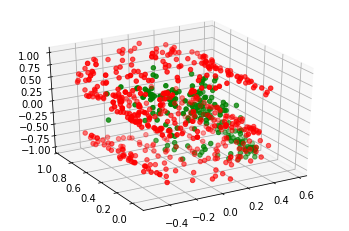

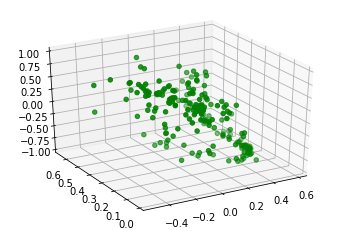

20000 [D loss: 0.057895] [G loss: -0.511298]


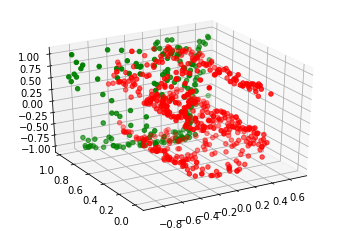

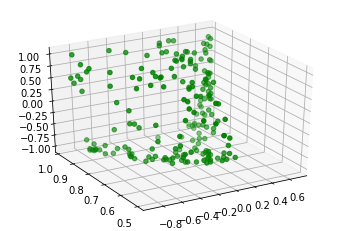

22000 [D loss: 0.036985] [G loss: -0.080384]


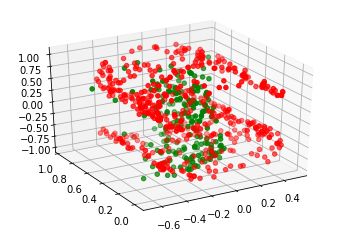

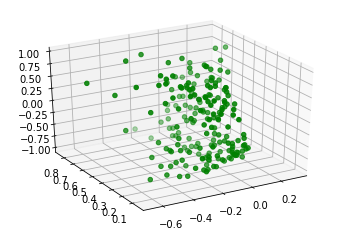

24000 [D loss: -0.009155] [G loss: -0.092170]


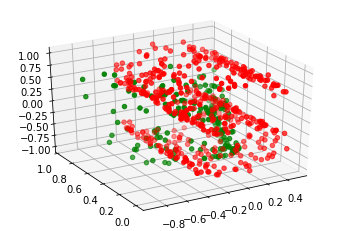

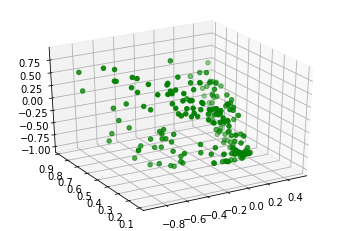

26000 [D loss: 0.026307] [G loss: 0.086183]


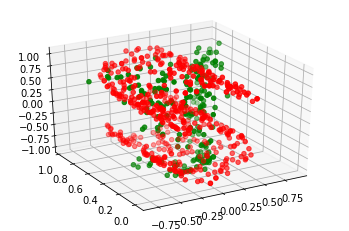

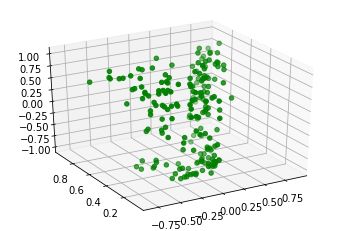

28000 [D loss: 0.028138] [G loss: -0.099175]


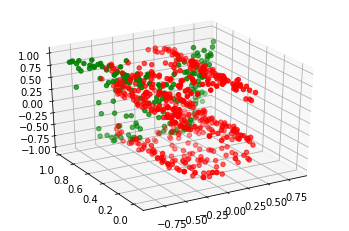

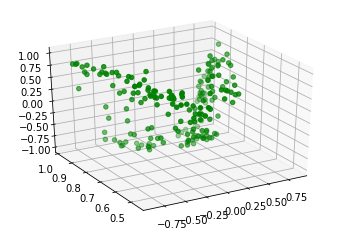

30000 [D loss: -0.019205] [G loss: -0.298910]


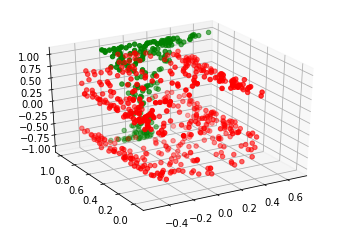

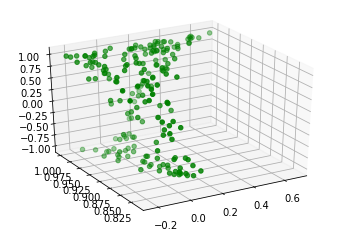

32000 [D loss: -0.029985] [G loss: -0.104393]


OSError: ignored

In [0]:
build_model(WGANGP_point, 'drive/My Drive/synthetic-ds/point/s_curves/scurve_noise_5.npy', 3, 3, 'drive/My Drive/WGAN-SCurve-noise_5-SInit', 50000)

In [0]:
clear_dir('drive/My Drive/WGAN-SCurve-noise_5-SInit/')

FileNotFoundError: ignored

### Eval on S curve factor 5 with normal Initialization

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_171 (Dense)            (None, 8)                 32        
_________________________________________________________________
leaky_re_lu_178 (LeakyReLU)  (None, 8)                 0         
_________________________________________________________________
dense_172 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_179 (LeakyReLU)  (None, 16)                0         
_________________________________________________________________
dense_173 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_180 (LeakyReLU)  (None, 8)                 0         
_________________________________________________________________
dense_174 (Dense)            (None, 3)                 27        
Total para

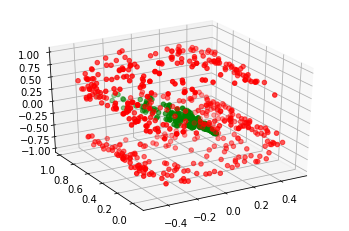

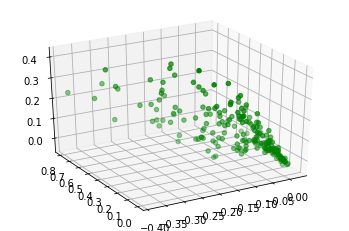

2000 [D loss: -0.022616] [G loss: -0.118738]


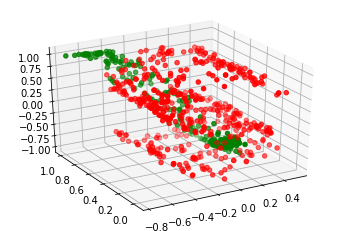

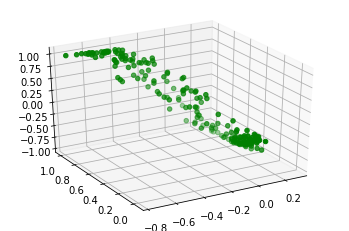

4000 [D loss: 0.019060] [G loss: -0.127628]


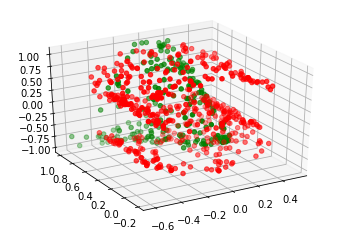

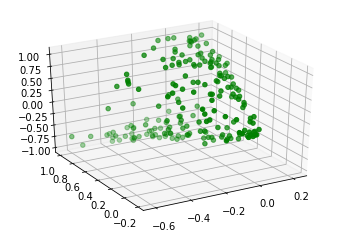

6000 [D loss: -0.020093] [G loss: -0.204166]


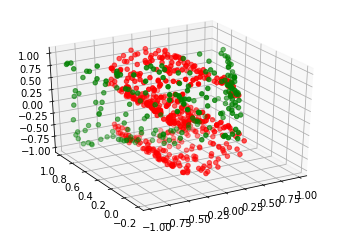

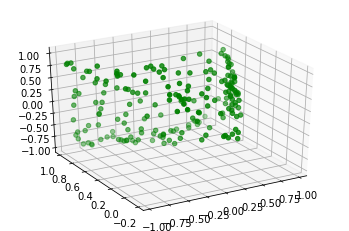

8000 [D loss: 0.024755] [G loss: 0.020844]


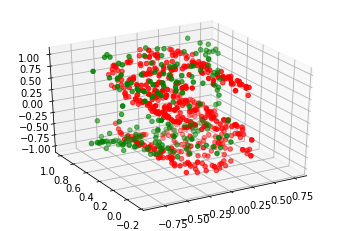

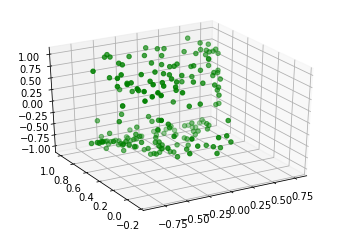

10000 [D loss: -0.016362] [G loss: 0.130620]


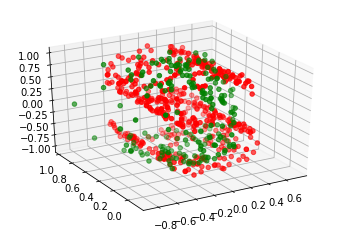

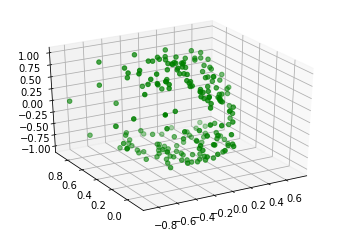

12000 [D loss: 0.003167] [G loss: 0.036359]


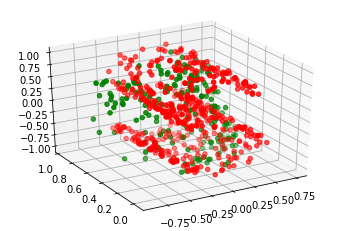

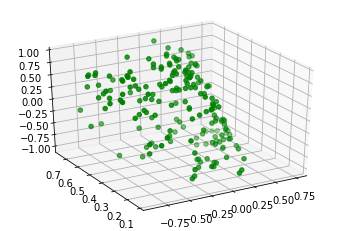

14000 [D loss: 0.025692] [G loss: -0.262973]


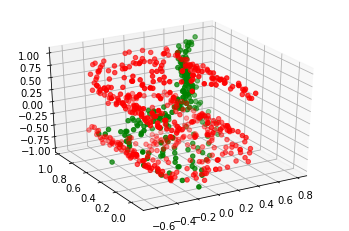

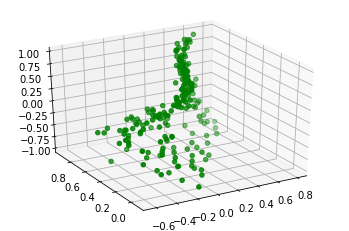

16000 [D loss: 0.003982] [G loss: -0.379337]


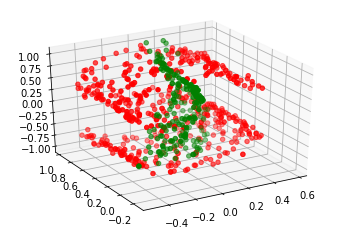

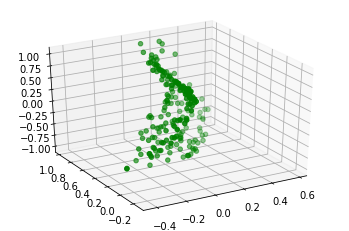

18000 [D loss: -0.012537] [G loss: -0.203024]


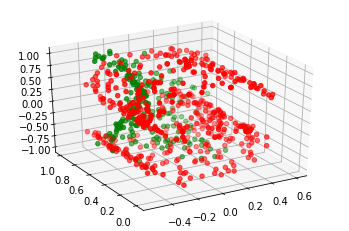

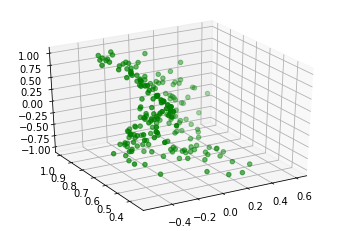

20000 [D loss: 0.014874] [G loss: -0.306389]


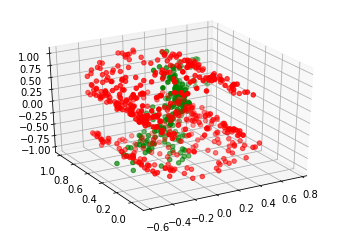

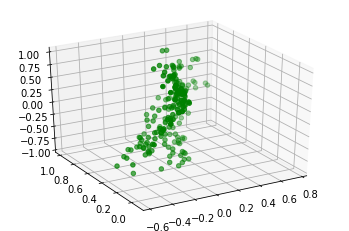

22000 [D loss: -0.010627] [G loss: -0.312989]


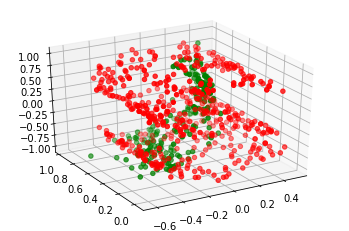

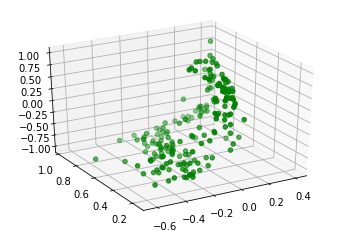

24000 [D loss: 0.019948] [G loss: -0.441620]


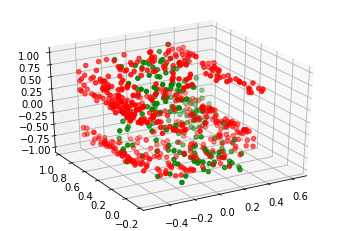

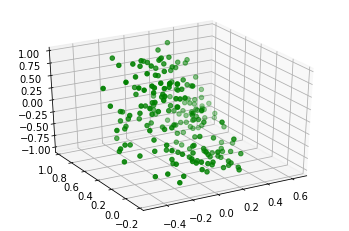

26000 [D loss: 0.030909] [G loss: -0.402347]


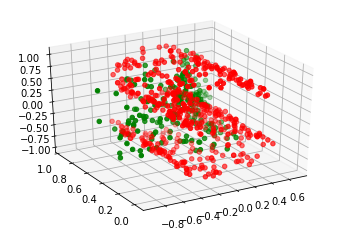

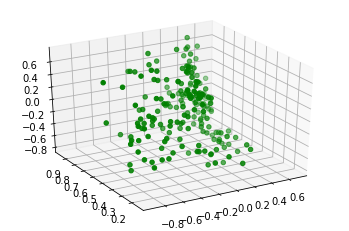

28000 [D loss: 0.004061] [G loss: -0.246059]


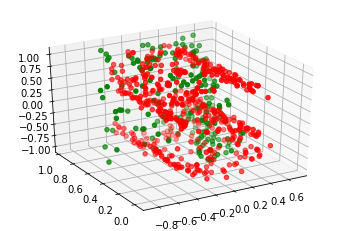

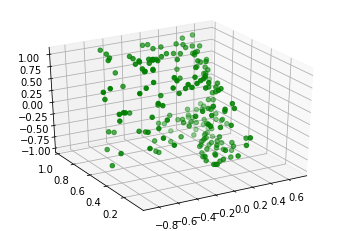

30000 [D loss: 0.021716] [G loss: -0.103344]


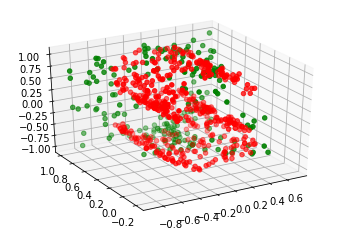

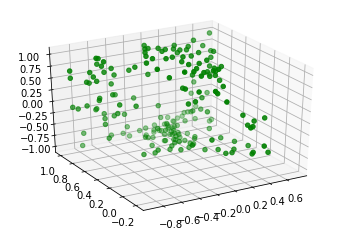

32000 [D loss: -0.010154] [G loss: -0.031837]


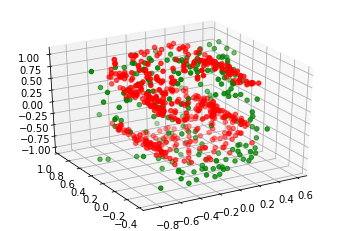

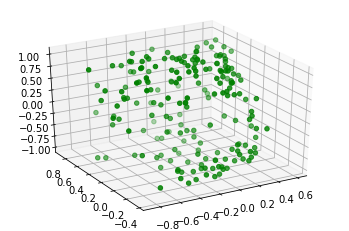

34000 [D loss: 0.068951] [G loss: -0.052657]


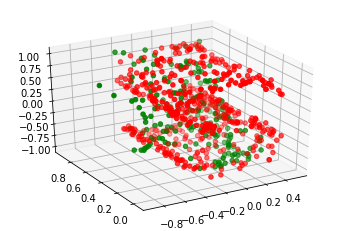

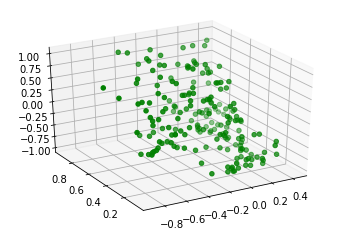

36000 [D loss: -0.029484] [G loss: 0.040258]


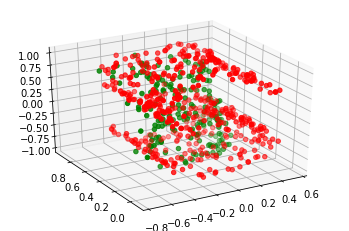

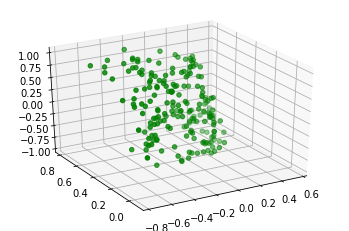

38000 [D loss: -0.003057] [G loss: 0.183106]


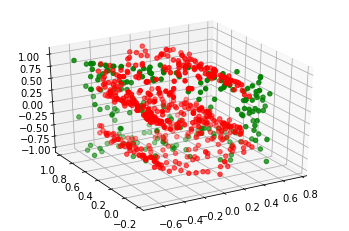

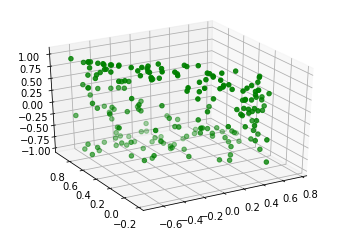

40000 [D loss: 0.015224] [G loss: 0.124672]


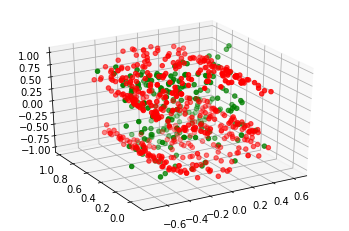

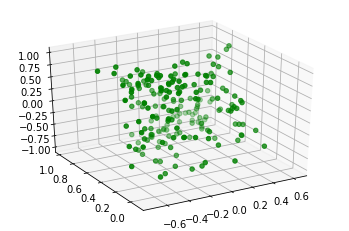

42000 [D loss: -0.009172] [G loss: 0.127751]


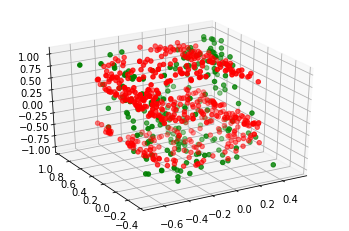

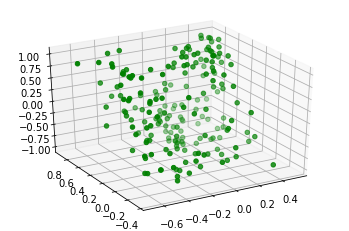

44000 [D loss: -0.003846] [G loss: 0.131715]


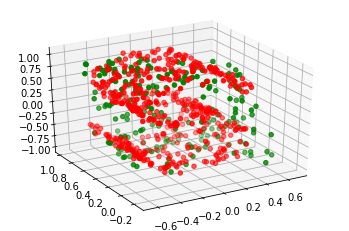

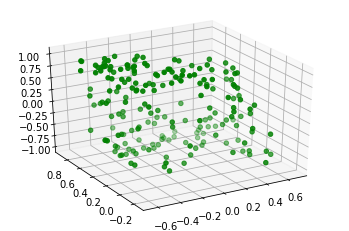

46000 [D loss: -0.007448] [G loss: 0.231258]


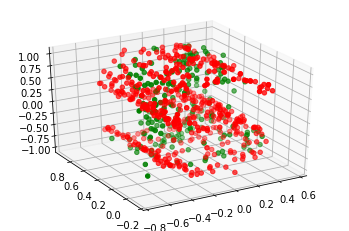

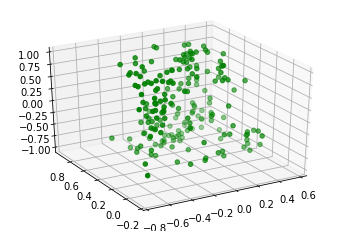

48000 [D loss: -0.006029] [G loss: 0.168796]


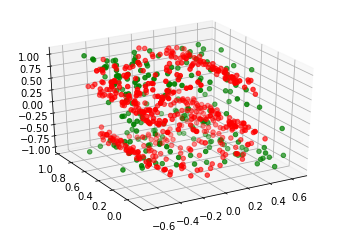

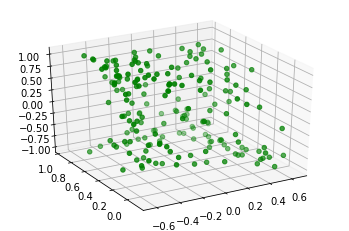

In [0]:
build_model(WGANGP_point, 'drive/My Drive/synthetic-ds/point/s_curves/scurve_noise_5.npy', 3, 3, 'drive/My Drive/WGAN-SCurve-noise_5', 50000)

### Eval on Swiss Roll

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_121 (Dense)            (None, 8)                 32        
_________________________________________________________________
leaky_re_lu_91 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_122 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_92 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_123 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_93 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_124 (Dense)            (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.693554, acc.: 53.12%] [G loss: 0.737229]


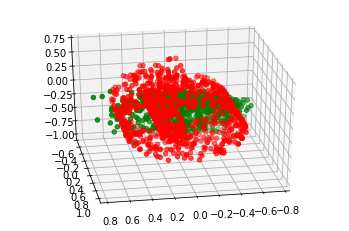

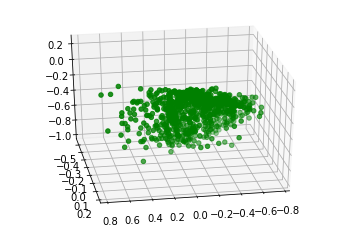

2000 [D loss: 0.691879, acc.: 45.31%] [G loss: 0.702777]


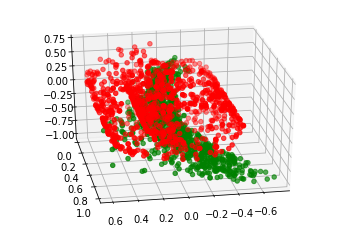

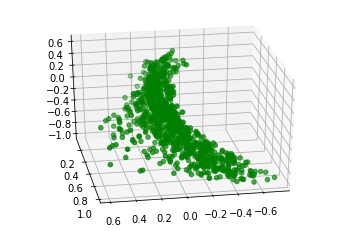

4000 [D loss: 0.701585, acc.: 51.56%] [G loss: 0.706440]


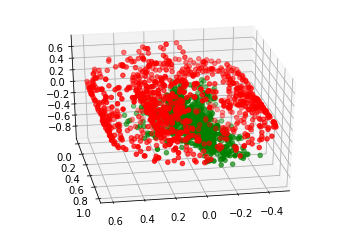

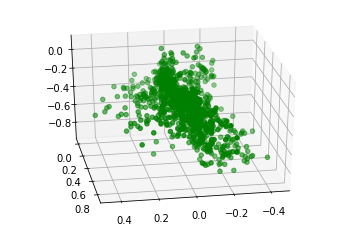

6000 [D loss: 0.696328, acc.: 51.56%] [G loss: 0.665140]


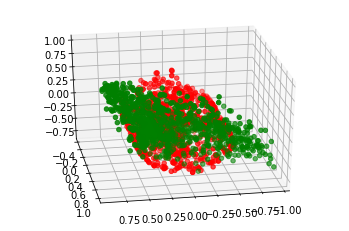

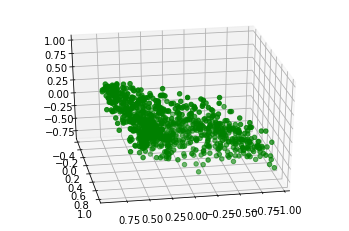

8000 [D loss: 0.695788, acc.: 35.94%] [G loss: 0.699365]


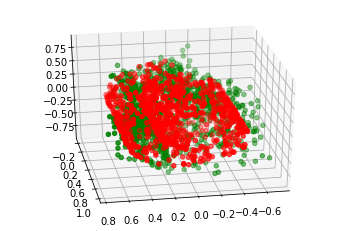

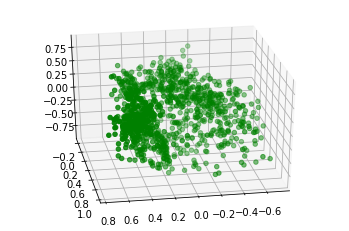

10000 [D loss: 0.693037, acc.: 56.25%] [G loss: 0.700133]


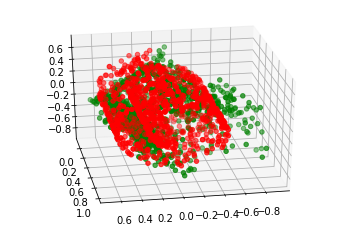

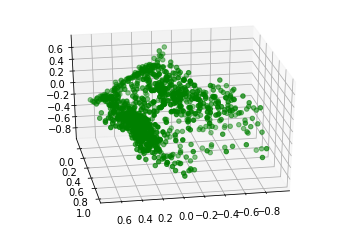

12000 [D loss: 0.692899, acc.: 45.31%] [G loss: 0.692594]


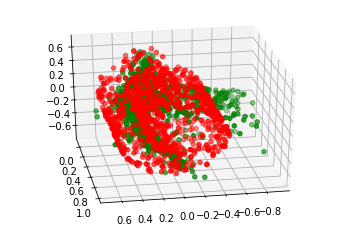

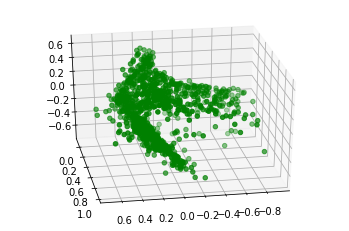

14000 [D loss: 0.692653, acc.: 57.81%] [G loss: 0.696910]


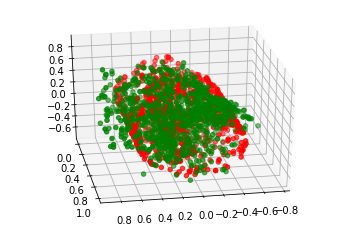

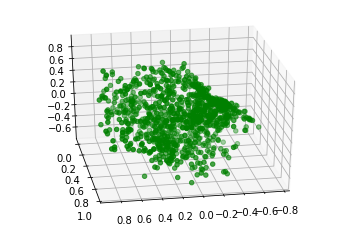

16000 [D loss: 0.692975, acc.: 48.44%] [G loss: 0.692058]


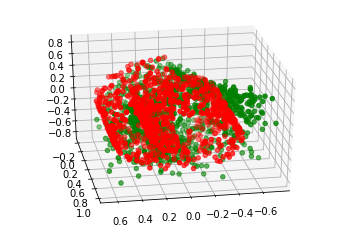

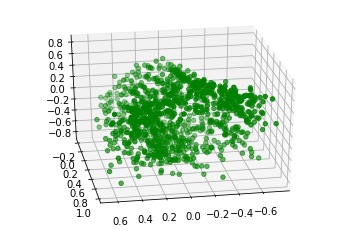

18000 [D loss: 0.694122, acc.: 48.44%] [G loss: 0.688887]


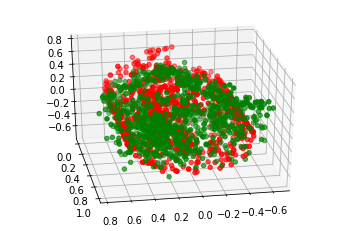

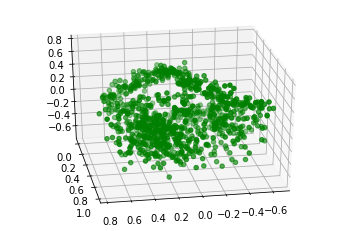

20000 [D loss: 0.693377, acc.: 51.56%] [G loss: 0.689854]


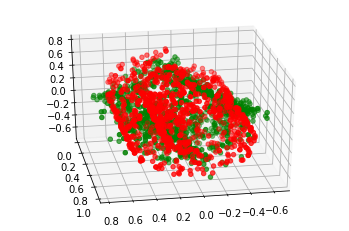

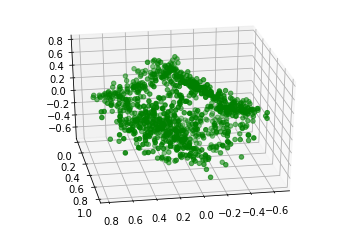

22000 [D loss: 0.693875, acc.: 40.62%] [G loss: 0.695677]


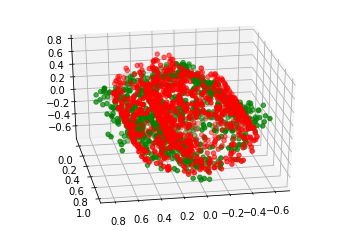

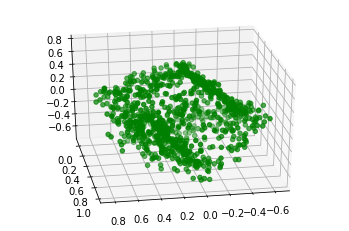

24000 [D loss: 0.693362, acc.: 51.56%] [G loss: 0.695858]


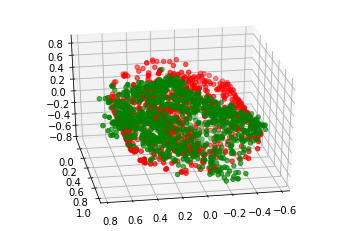

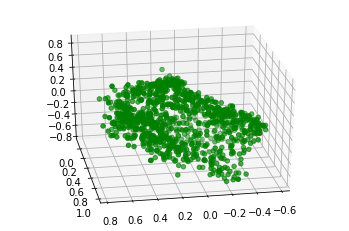

26000 [D loss: 0.692556, acc.: 59.38%] [G loss: 0.693503]


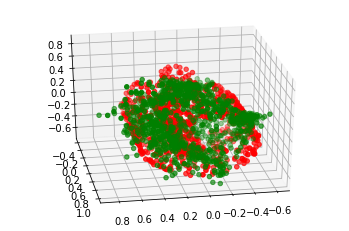

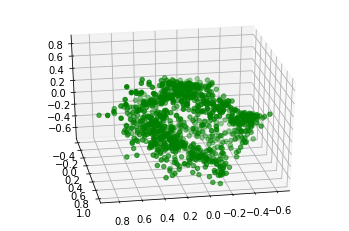

28000 [D loss: 0.692193, acc.: 60.94%] [G loss: 0.692953]


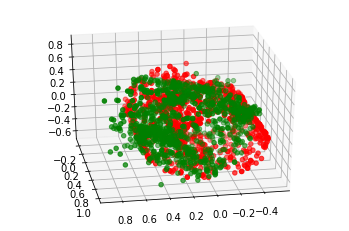

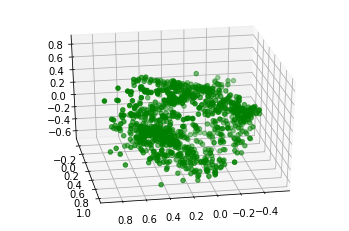

30000 [D loss: 0.692546, acc.: 53.12%] [G loss: 0.694637]


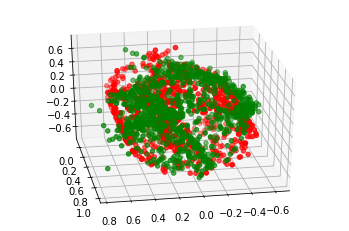

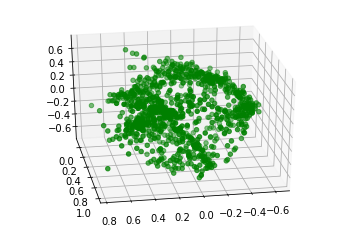

32000 [D loss: 0.692541, acc.: 48.44%] [G loss: 0.695431]


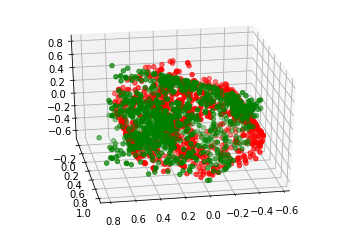

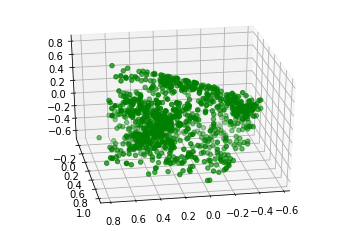

34000 [D loss: 0.692040, acc.: 53.12%] [G loss: 0.693688]


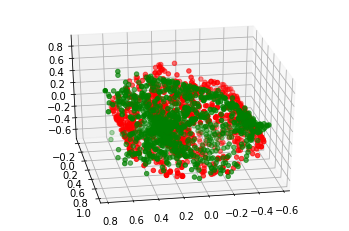

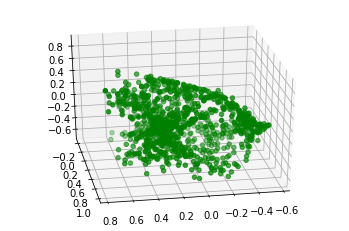

36000 [D loss: 0.693395, acc.: 51.56%] [G loss: 0.692849]


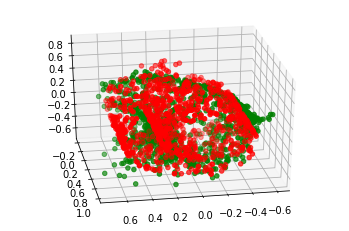

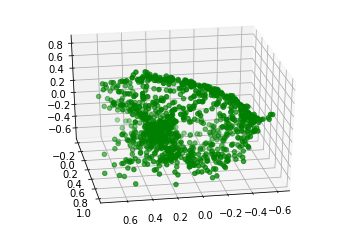

38000 [D loss: 0.692868, acc.: 53.12%] [G loss: 0.695686]


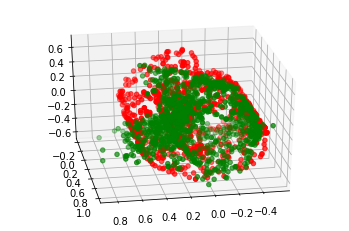

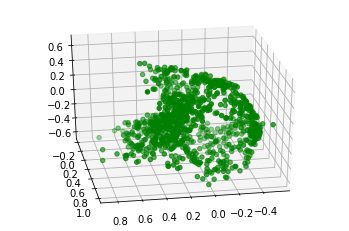

40000 [D loss: 0.692472, acc.: 60.94%] [G loss: 0.696668]


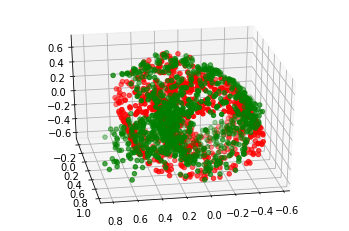

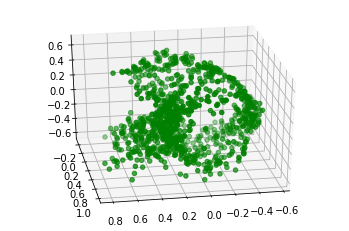

42000 [D loss: 0.693562, acc.: 48.44%] [G loss: 0.692321]


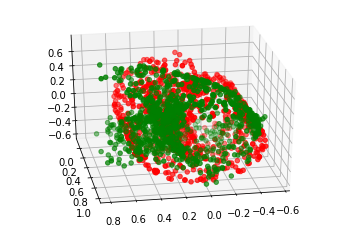

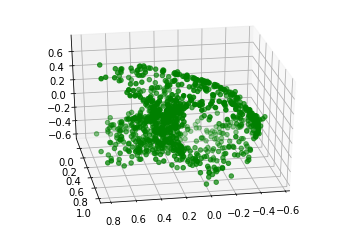

44000 [D loss: 0.694514, acc.: 40.62%] [G loss: 0.692348]


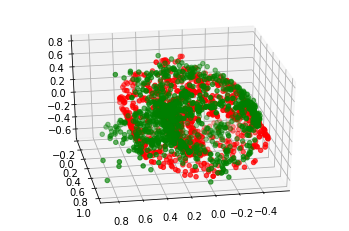

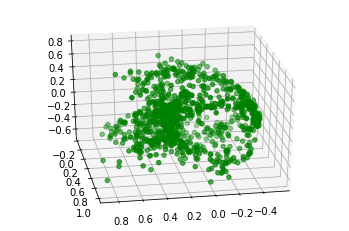

46000 [D loss: 0.692660, acc.: 54.69%] [G loss: 0.692834]


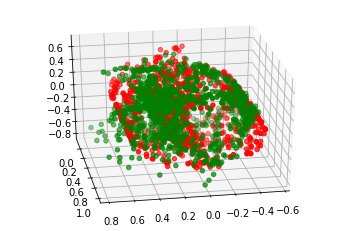

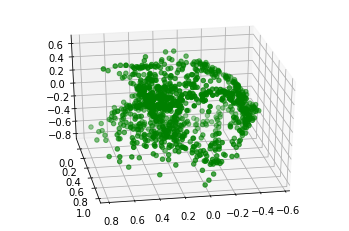

48000 [D loss: 0.693461, acc.: 51.56%] [G loss: 0.693649]


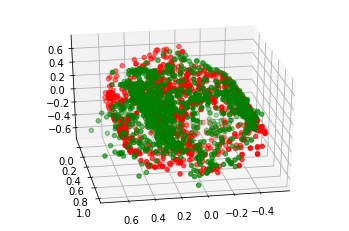

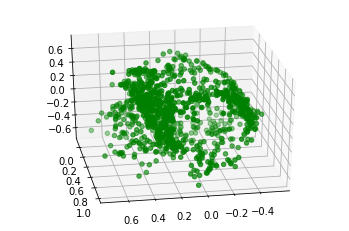

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/swiss_roll/roll_noise_5.npy', 3, 3, 'drive/My Drive/WGAN-SwissRoll-noise-5', 50000, 80)

In [0]:
clear_dir('drive/My Drive/WGAN-SwissRoll-noise-5')

### Eval on Blobs with 3 centers

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_129 (Dense)            (None, 8)                 24        
_________________________________________________________________
leaky_re_lu_97 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_130 (Dense)            (None, 16)                144       
_________________________________________________________________
leaky_re_lu_98 (LeakyReLU)   (None, 16)                0         
_________________________________________________________________
dense_131 (Dense)            (None, 8)                 136       
_________________________________________________________________
leaky_re_lu_99 (LeakyReLU)   (None, 8)                 0         
_________________________________________________________________
dense_132 (Dense)            (None, 1)                 9         
Total para

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.723115, acc.: 50.00%] [G loss: 0.745695]


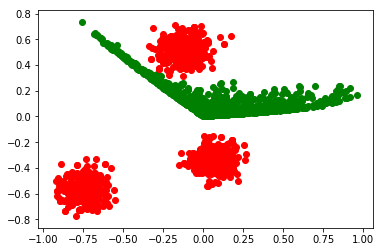

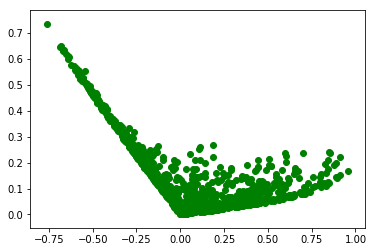

2000 [D loss: 0.685423, acc.: 65.62%] [G loss: 0.708511]


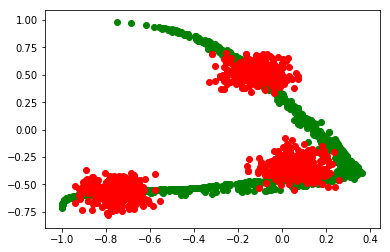

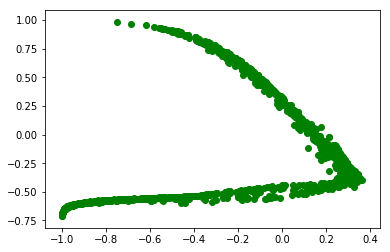

4000 [D loss: 0.692875, acc.: 50.00%] [G loss: 0.690951]


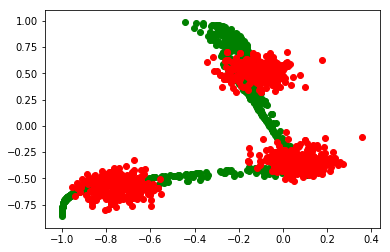

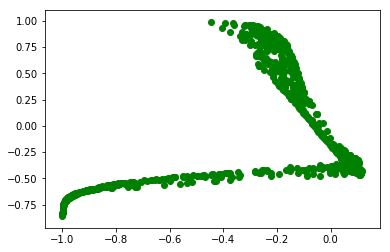

6000 [D loss: 0.691640, acc.: 48.44%] [G loss: 0.692316]


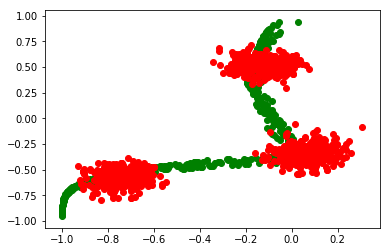

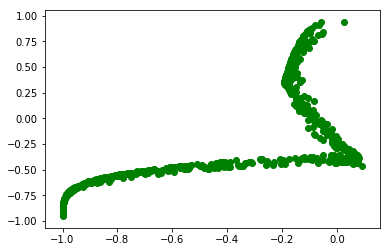

8000 [D loss: 0.693075, acc.: 35.94%] [G loss: 0.696147]


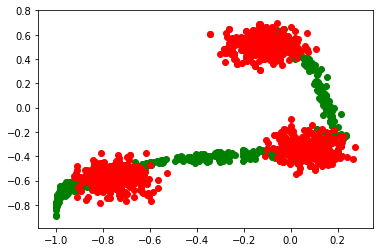

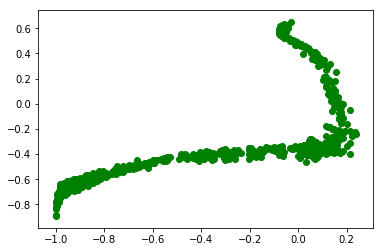

10000 [D loss: 0.691454, acc.: 48.44%] [G loss: 0.693403]


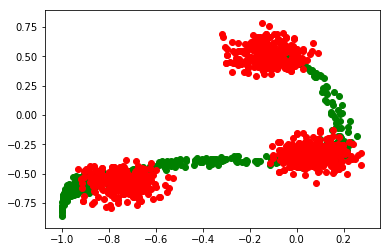

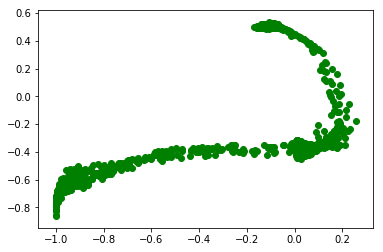

12000 [D loss: 0.693206, acc.: 42.19%] [G loss: 0.692439]


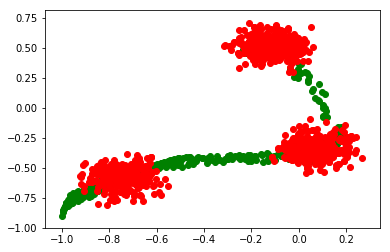

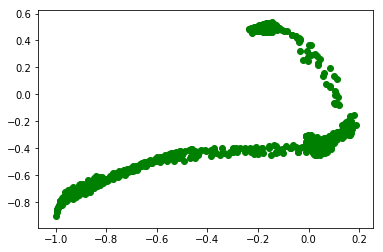

14000 [D loss: 0.691384, acc.: 45.31%] [G loss: 0.693788]


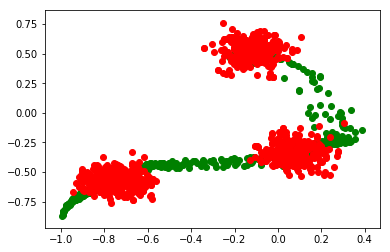

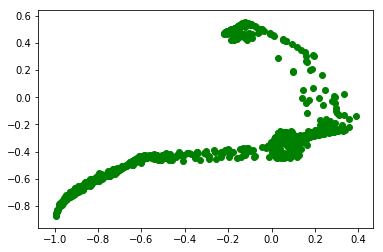

16000 [D loss: 0.693097, acc.: 53.12%] [G loss: 0.686044]


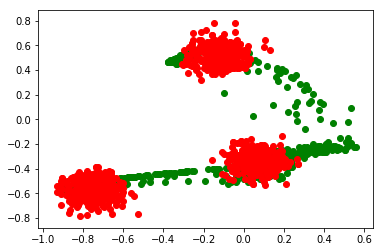

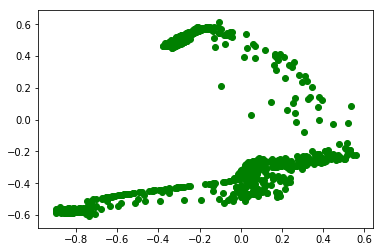

18000 [D loss: 0.691622, acc.: 45.31%] [G loss: 0.695713]


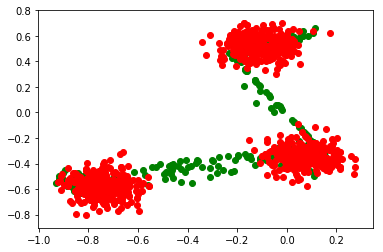

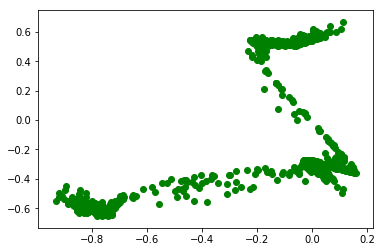

20000 [D loss: 0.695541, acc.: 42.19%] [G loss: 0.685851]


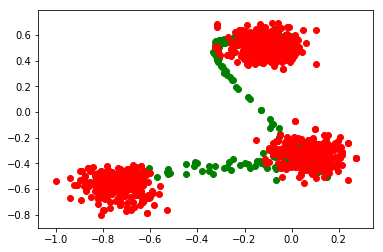

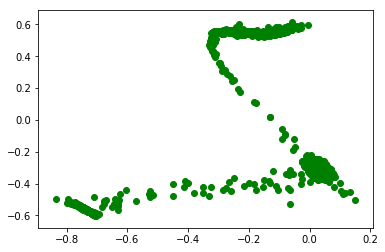

22000 [D loss: 0.691222, acc.: 51.56%] [G loss: 0.692307]


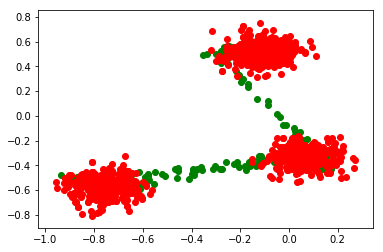

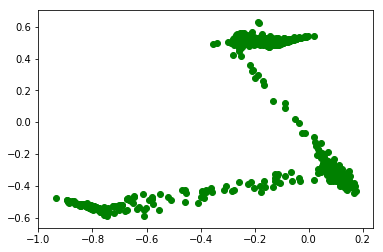

24000 [D loss: 0.694262, acc.: 35.94%] [G loss: 0.698719]


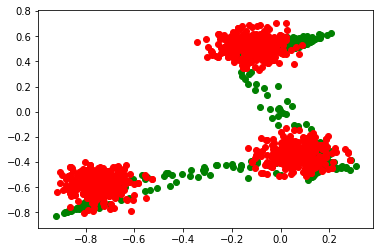

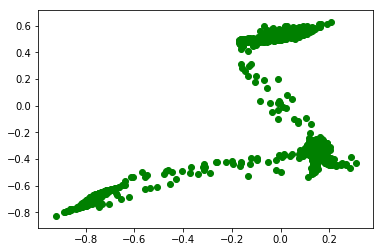

26000 [D loss: 0.693442, acc.: 45.31%] [G loss: 0.694640]


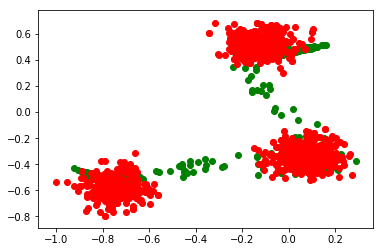

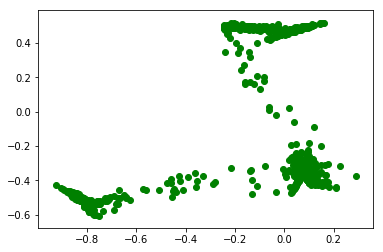

28000 [D loss: 0.696719, acc.: 43.75%] [G loss: 0.688582]


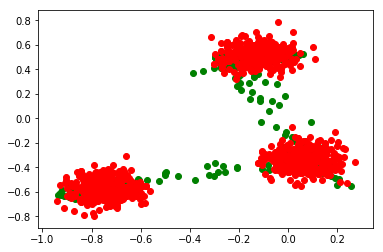

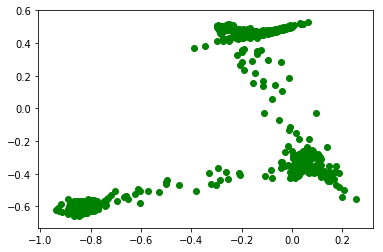

30000 [D loss: 0.694352, acc.: 34.38%] [G loss: 0.693686]


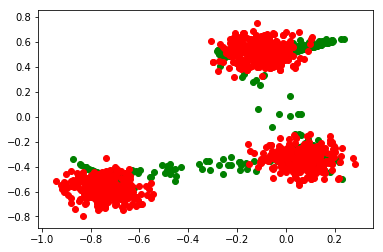

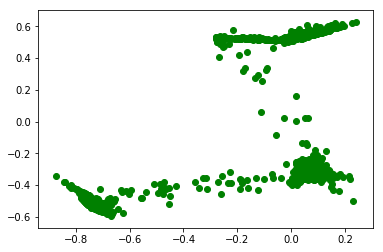

32000 [D loss: 0.693938, acc.: 45.31%] [G loss: 0.690681]


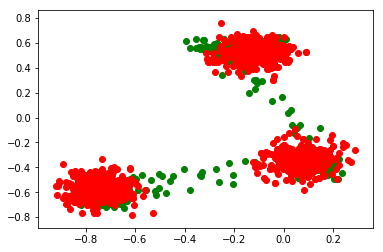

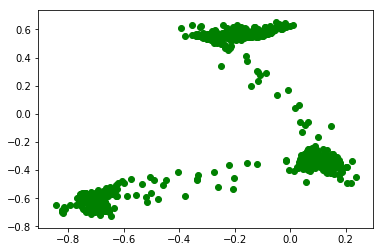

34000 [D loss: 0.694470, acc.: 42.19%] [G loss: 0.692557]


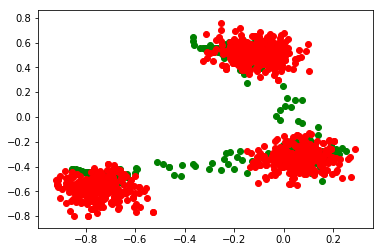

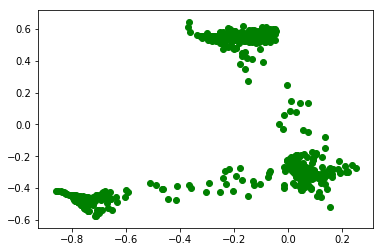

36000 [D loss: 0.692748, acc.: 42.19%] [G loss: 0.701081]


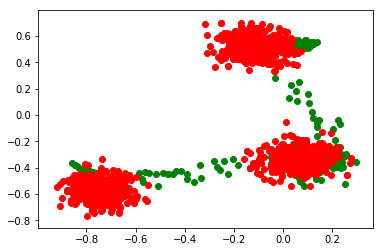

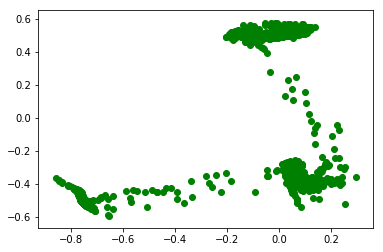

38000 [D loss: 0.698002, acc.: 39.06%] [G loss: 0.697677]


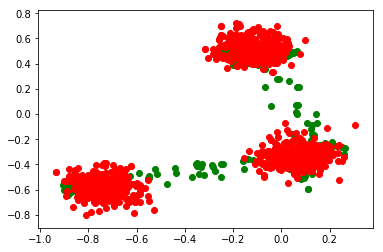

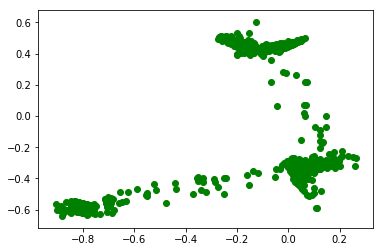

40000 [D loss: 0.693803, acc.: 42.19%] [G loss: 0.702579]


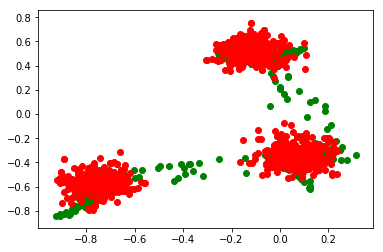

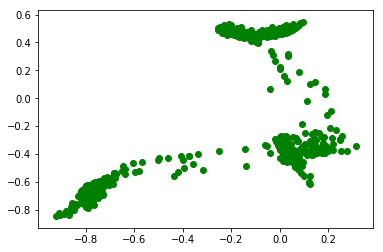

42000 [D loss: 0.695307, acc.: 56.25%] [G loss: 0.690569]


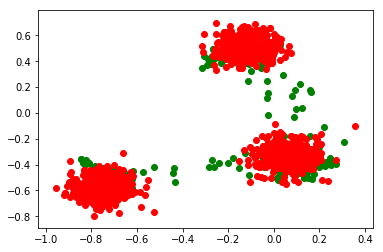

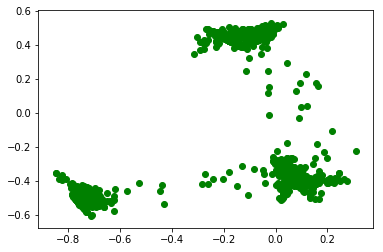

44000 [D loss: 0.695308, acc.: 45.31%] [G loss: 0.703896]


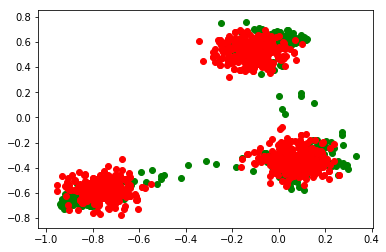

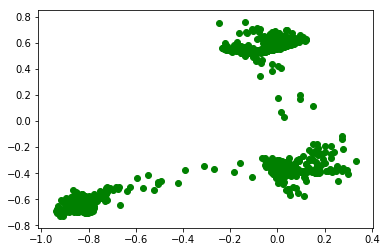

46000 [D loss: 0.694020, acc.: 46.88%] [G loss: 0.694027]


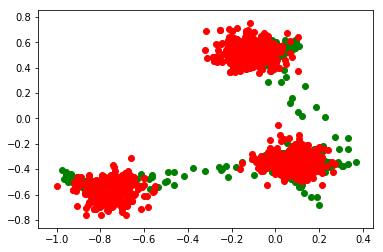

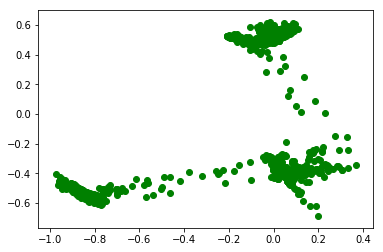

48000 [D loss: 0.692104, acc.: 50.00%] [G loss: 0.700802]


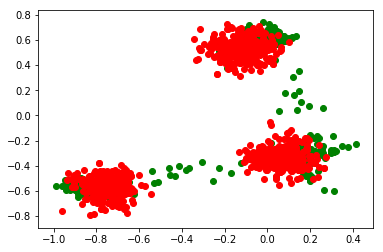

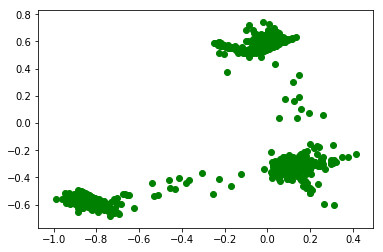

In [0]:
build_model(GAN_point, 'drive/My Drive/synthetic-ds/point/blobs/blobs_3.npy', 2, 2, 'drive/My Drive/WGAN-Blobs-3', 50000, 80)

In [0]:
clear_dir('drive/My Drive/WGAN-Blobs-3')

# Image GANs

## DCGAN

### Class and helper code

In [0]:
class DCGAN():
    def __init__(self, X_train, img_shape, latent_dim, save_path, pretrained = None):
        # Input shape
        self.img_rows = img_shape[0]
        self.img_cols = img_shape[1]
        self.channels = img_shape[2]
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = latent_dim
        self.dataset = X_train
        self.save_path = save_path

        optimizer = Adam(0.0002, 0.5)

        if pretrained is None:
          # Build and compile the discriminator
          self.discriminator = self.build_discriminator()
          self.discriminator.compile(loss='binary_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

          # Build the generator
          self.generator = self.build_generator()
        else:
          self.generator = load_model(pretrained + '/gen_40000.h5')
          
          self.discriminator = load_model(pretrained + '/disc_40000.h5')
          
        # The generator takes noise as input and generates imgs
        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        # For the combined model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator takes generated images as input and determines validity
        valid = self.discriminator(img)

        # The combined model  (stacked generator and discriminator)
        # Trains the generator to fool the discriminator
        self.combined = Model(z, valid)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer)

    def build_generator(self):

        model = Sequential()

        model.add(Dense(128 * 7 * 7, input_dim=self.latent_dim))
        #model.add(Activation("relu"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Reshape((7, 7, 128)))
        model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        #model.add(Activation("relu"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        #model.add(Activation("relu"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2D(self.channels, kernel_size=3, padding="same"))
        model.add(Activation("tanh"))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_discriminator(self):

        model = Sequential()

        model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))

        model.summary()

        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size=128, sample_interval=50, scaling = 0.5):

        
        X_train = self.dataset

        # Rescale -1 to 1
        X_train = X_train / scaling - 1.
        if self.channels == 1:
          X_train = np.expand_dims(X_train, axis=3)
        
        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))
                 
        gen_loss = []
        disc_loss = []

        for epoch in range(epochs):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            # Sample noise and generate a batch of new images
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)

            # Train the discriminator (real classified as ones and generated as zeros)
            d_loss_real = self.discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            # Train the generator (wants discriminator to mistake images as real)
            g_loss = self.combined.train_on_batch(noise, valid)

            gen_loss.append(g_loss)
            disc_loss.append(d_loss[0])
            
            if epoch%sample_interval == 0:
              # Plot the progress
              print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:                
                # Save Snapshots of models, losses and samples
                
                # Save model snapshots
                model_dir = self.save_path + '/models/' + str(epoch) + '/'
                pathlib.Path(model_dir).mkdir(parents=True, exist_ok=True) 
                self.generator.save(model_dir + 'gen_' + str(epoch) + '.h5')
                self.discriminator.save(model_dir + 'disc_' + str(epoch) + '.h5')
                
                # Save Losses
                loss_dir = self.save_path + '/loss/' + str(epoch) + '/'
                pathlib.Path(loss_dir).mkdir(parents=True, exist_ok=True) 
                np.save(loss_dir + 'critic_loss', np.array(disc_loss))
                np.save(loss_dir + 'gen_loss', np.array(gen_loss))
                
                # Plot and Save samples
                sample_dir = self.save_path + '/samples/' + str(epoch) + '/'
                self.sample_images(epoch, sample_dir)

    def sample_images(self, epoch, sample_dir):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
        
        # Rescale images 0 - 1
        gen_imgs = 0.5 * (gen_imgs + 1)

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                if self.channels == 1:
                  axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray')
                else:
                  axs[i,j].imshow(gen_imgs[cnt, :,:,:], cmap='gray')
                axs[i,j].axis('off')
                cnt += 1
        pathlib.Path(sample_dir).mkdir(parents=True, exist_ok=True)
        plt.savefig(sample_dir + 'sample.png')
        plt.show()
        plt.close()

In [0]:
def build_model_image(model_class, ds_path, img_shape, latent_dim, save_path, n_iter, scaling):
  # Load Dataset
  ds = np.load(ds_path)
  X_train = ds
  
  # Train model
  gan = model_class(X_train, img_shape, latent_dim, save_path)
  gan.train(n_iter, 32, 2000, scaling)

### Eval on images with 3 squares of size 4x4

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 14, 14, 32)        320       
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 7, 7, 64)          18496     
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 8, 8, 64)          0         
_________________________________________________________________
batch_normalization_6 (Batch (None, 8, 8, 64)          256       
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 8, 8, 64)          0         
__________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 1.196766, acc.: 45.31%] [G loss: 0.424103]


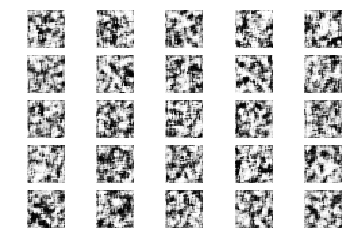

2000 [D loss: 0.471287, acc.: 76.56%] [G loss: 3.226789]


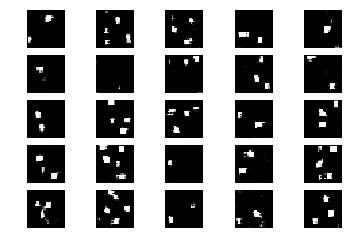

4000 [D loss: 0.005052, acc.: 100.00%] [G loss: 6.168063]


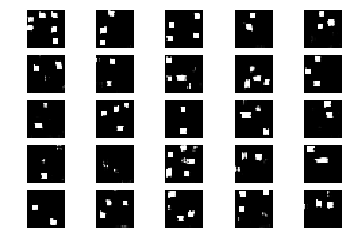

6000 [D loss: 0.001026, acc.: 100.00%] [G loss: 6.603369]


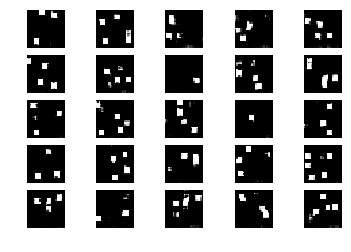

8000 [D loss: 0.015792, acc.: 100.00%] [G loss: 9.238682]


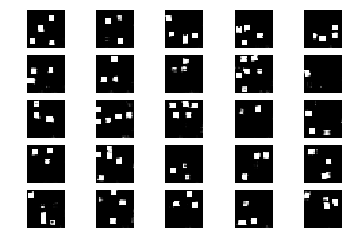

10000 [D loss: 0.000571, acc.: 100.00%] [G loss: 10.332358]


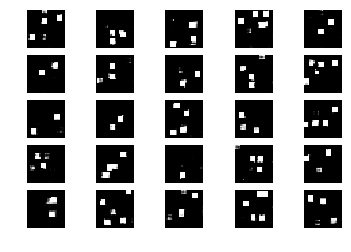

12000 [D loss: 0.002652, acc.: 100.00%] [G loss: 5.544838]


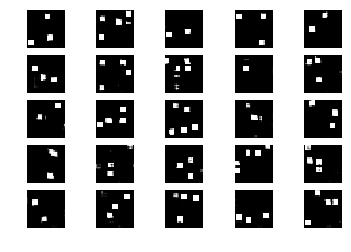

14000 [D loss: 0.009337, acc.: 100.00%] [G loss: 9.014838]


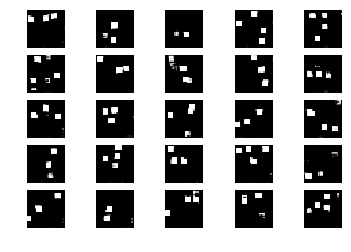

16000 [D loss: 0.020349, acc.: 100.00%] [G loss: 10.371159]


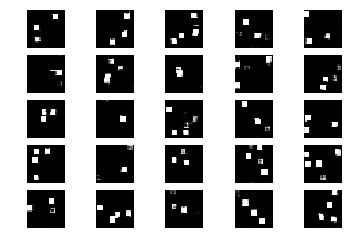

18000 [D loss: 0.000308, acc.: 100.00%] [G loss: 11.369167]


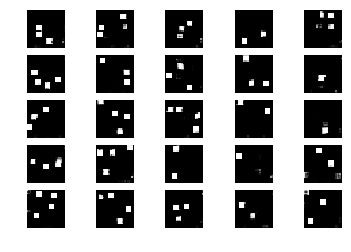

20000 [D loss: 0.000636, acc.: 100.00%] [G loss: 11.445675]


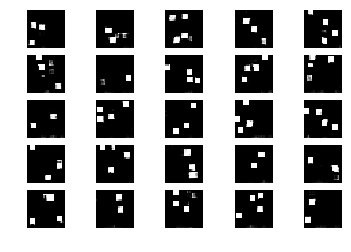

22000 [D loss: 0.000721, acc.: 100.00%] [G loss: 9.246514]


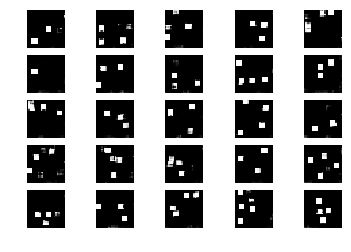

24000 [D loss: 0.026591, acc.: 98.44%] [G loss: 9.867889]


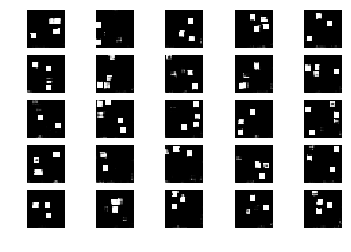

26000 [D loss: 0.000029, acc.: 100.00%] [G loss: 11.793259]


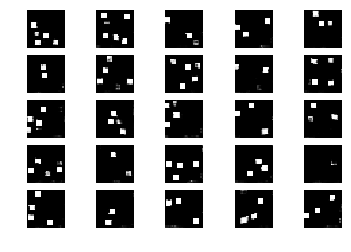

28000 [D loss: 4.048261, acc.: 9.38%] [G loss: 2.590472]


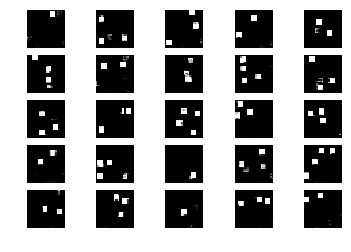

30000 [D loss: 0.001627, acc.: 100.00%] [G loss: 8.912092]


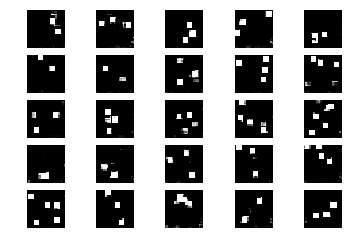

32000 [D loss: 0.003632, acc.: 100.00%] [G loss: 12.023925]


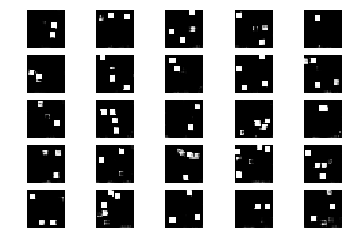

34000 [D loss: 0.000027, acc.: 100.00%] [G loss: 10.237570]


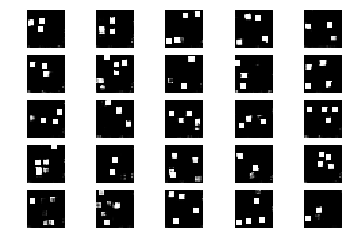

36000 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.267771]


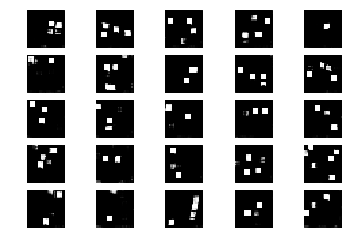

38000 [D loss: 0.000331, acc.: 100.00%] [G loss: 10.774582]


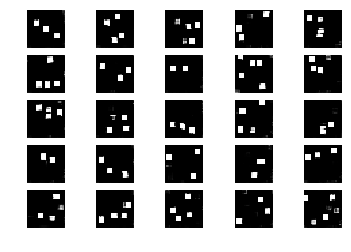

40000 [D loss: 0.000449, acc.: 100.00%] [G loss: 10.069780]


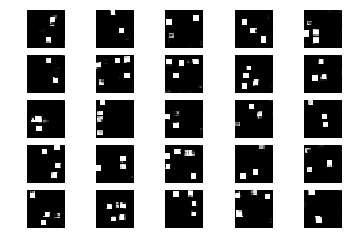

42000 [D loss: 0.005409, acc.: 100.00%] [G loss: 9.106062]


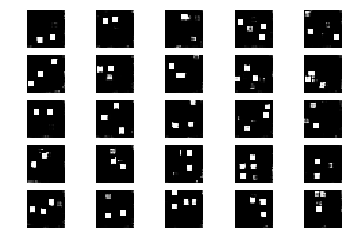

44000 [D loss: 0.000213, acc.: 100.00%] [G loss: 13.210085]


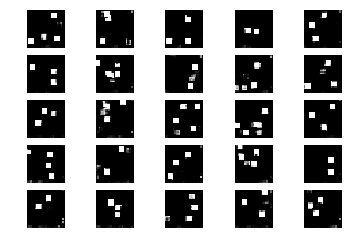

46000 [D loss: 0.040233, acc.: 100.00%] [G loss: 12.198298]


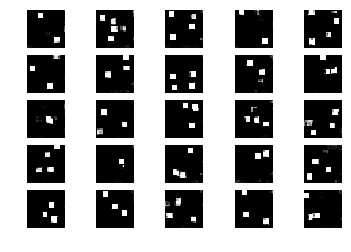

48000 [D loss: 0.001504, acc.: 100.00%] [G loss: 12.658726]


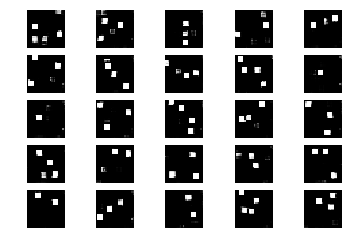

In [0]:
build_model_image(DCGAN, 'drive/My Drive/synthetic-ds/squares/3-4-28x28.npy', (28,28,1), 100, 'drive/My Drive/DCGAN-squares-3-4', 50000, 0.5)

In [0]:
# Be careful with this (deletes the entire saved model, plots etc)
clear_dir('drive/My Drive/DCGAN-squares-3-4')

### Eval on images with 1 square of size 4x4 

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_29 (Conv2D)           (None, 14, 14, 32)        320       
_________________________________________________________________
leaky_re_lu_23 (LeakyReLU)   (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_17 (Dropout)         (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 7, 7, 64)          18496     
_________________________________________________________________
zero_padding2d_5 (ZeroPaddin (None, 8, 8, 64)          0         
_________________________________________________________________
batch_normalization_21 (Batc (None, 8, 8, 64)          256       
_________________________________________________________________
leaky_re_lu_24 (LeakyReLU)   (None, 8, 8, 64)          0         
__________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.993834, acc.: 34.38%] [G loss: 0.947394]


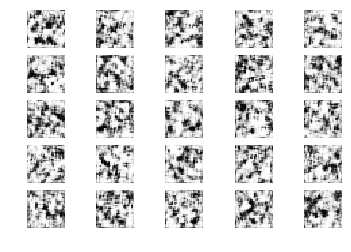

2000 [D loss: 0.126870, acc.: 96.88%] [G loss: 4.446802]


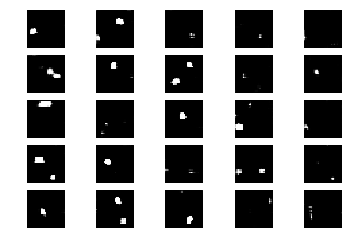

4000 [D loss: 0.002581, acc.: 100.00%] [G loss: 6.641482]


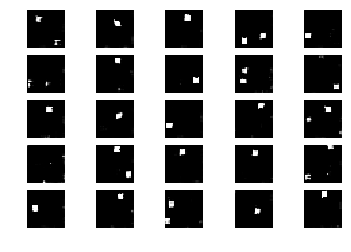

6000 [D loss: 0.056661, acc.: 100.00%] [G loss: 5.032078]


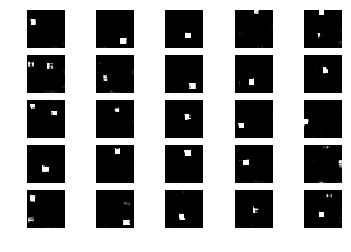

8000 [D loss: 0.008900, acc.: 100.00%] [G loss: 13.204296]


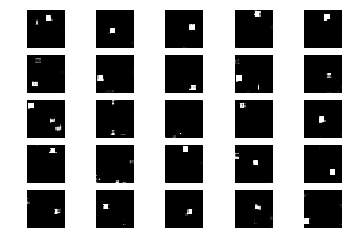

10000 [D loss: 0.002045, acc.: 100.00%] [G loss: 4.797856]


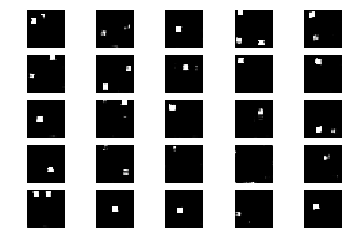

12000 [D loss: 0.000922, acc.: 100.00%] [G loss: 7.391491]


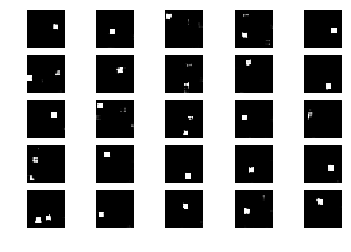

14000 [D loss: 0.000828, acc.: 100.00%] [G loss: 9.574059]


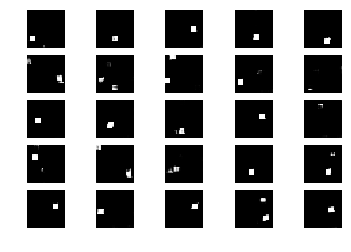

16000 [D loss: 0.001555, acc.: 100.00%] [G loss: 14.239952]


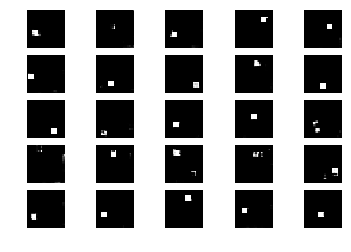

18000 [D loss: 0.000692, acc.: 100.00%] [G loss: 9.007651]


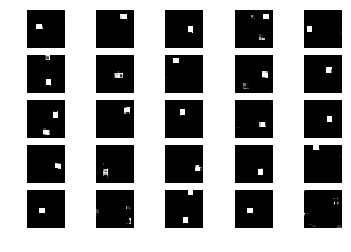

20000 [D loss: 0.012268, acc.: 100.00%] [G loss: 10.571712]


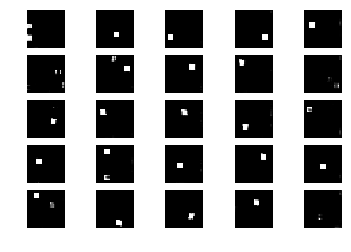

22000 [D loss: 0.039133, acc.: 98.44%] [G loss: 16.118095]


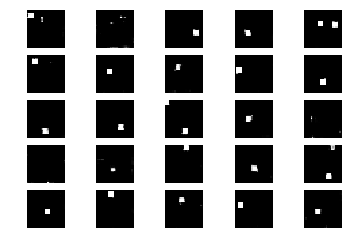

24000 [D loss: 0.000080, acc.: 100.00%] [G loss: 11.898503]


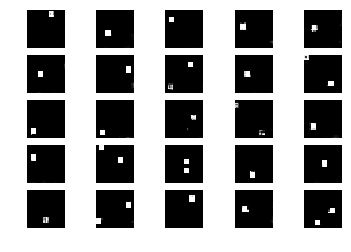

26000 [D loss: 0.000423, acc.: 100.00%] [G loss: 9.648625]


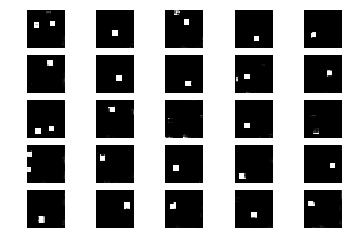

28000 [D loss: 0.002739, acc.: 100.00%] [G loss: 4.199597]


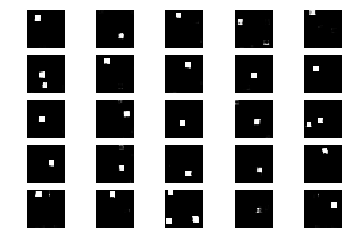

30000 [D loss: 0.000212, acc.: 100.00%] [G loss: 7.157612]


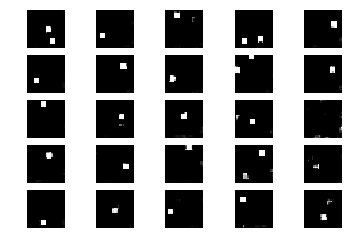

32000 [D loss: 0.000062, acc.: 100.00%] [G loss: 12.670351]


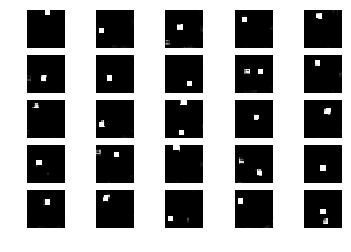

34000 [D loss: 0.003156, acc.: 100.00%] [G loss: 7.098341]


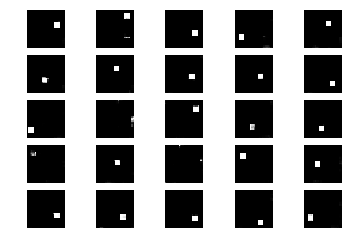

36000 [D loss: 0.014525, acc.: 100.00%] [G loss: 14.525391]


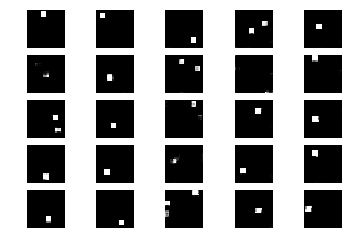

38000 [D loss: 0.000355, acc.: 100.00%] [G loss: 12.268228]


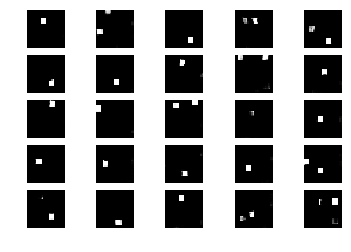

40000 [D loss: 0.000244, acc.: 100.00%] [G loss: 6.440156]


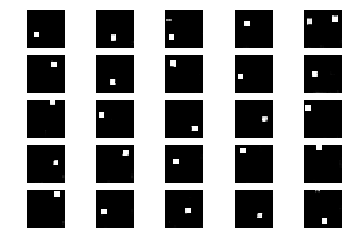

42000 [D loss: 0.006462, acc.: 100.00%] [G loss: 6.488302]


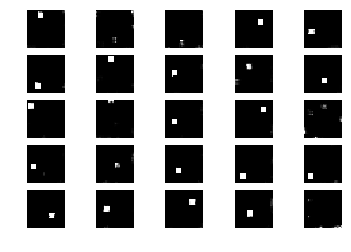

44000 [D loss: 0.000110, acc.: 100.00%] [G loss: 14.493687]


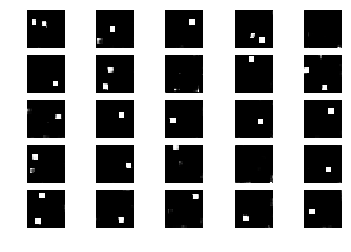

46000 [D loss: 0.004440, acc.: 100.00%] [G loss: 11.182997]


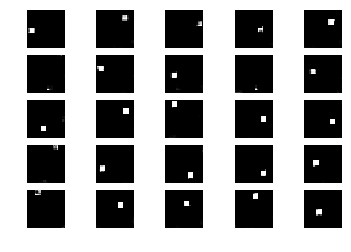

48000 [D loss: 0.000501, acc.: 100.00%] [G loss: 10.373701]


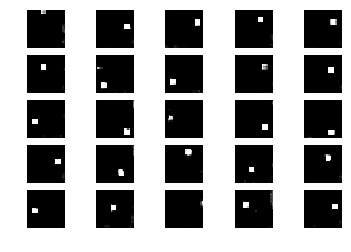

In [0]:
build_model_image(DCGAN, 'drive/My Drive/synthetic-ds/squares/1-4-28x28.npy', (28,28,1), 100, 'drive/My Drive/DCGAN-squares-1-4', 50000, 0.5)

### Using pretrained model on 1-4 on 3-4 (48k model)

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


gen load


/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


disc load


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 3.980553, acc.: 50.00%] [G loss: 11.675339]


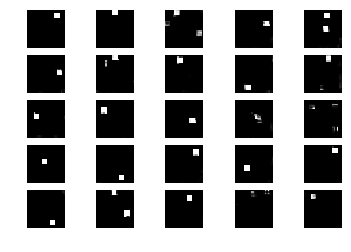

2000 [D loss: 0.001246, acc.: 100.00%] [G loss: 13.841461]


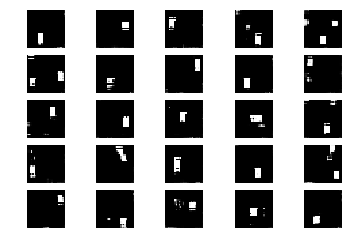

4000 [D loss: 0.000294, acc.: 100.00%] [G loss: 12.230984]


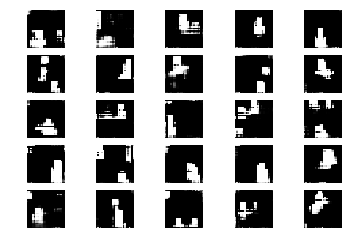

6000 [D loss: 0.000015, acc.: 100.00%] [G loss: 13.790160]


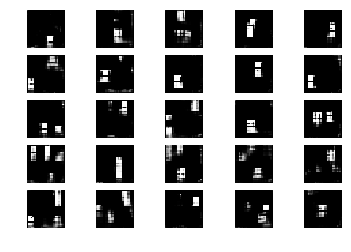

8000 [D loss: 0.000446, acc.: 100.00%] [G loss: 12.783615]


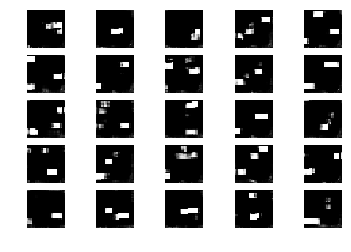

10000 [D loss: 0.000022, acc.: 100.00%] [G loss: 14.676878]


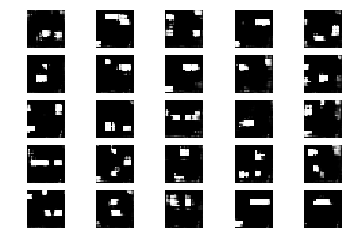

12000 [D loss: 0.000007, acc.: 100.00%] [G loss: 15.717945]


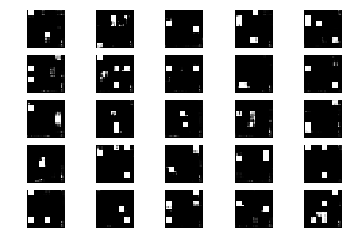

14000 [D loss: 0.000002, acc.: 100.00%] [G loss: 14.463463]


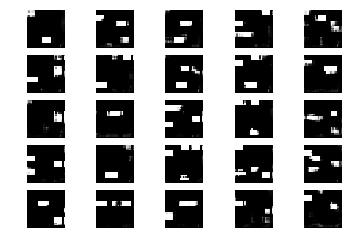

16000 [D loss: 0.000009, acc.: 100.00%] [G loss: 12.881809]


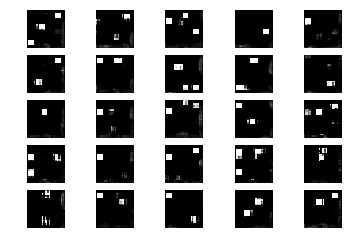

18000 [D loss: 0.000014, acc.: 100.00%] [G loss: 14.991769]


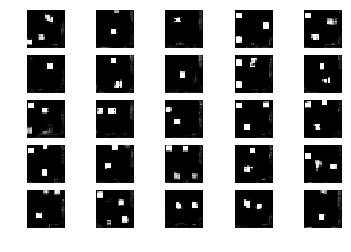

In [0]:
ds_path = 'drive/My Drive/synthetic-ds/squares/3-4-28x28.npy'
# Load Dataset
ds = np.load(ds_path)
X_train = ds

img_shape = (28,28,1)
latent_dim = 100
save_path = 'drive/My Drive/DCGAN-squares-3-4-transfer-48000'

# Since we are transferring weights keep training shorter
n_iter = 20000
scaling = 0.5

# Train model
gan = DCGAN(X_train, img_shape, latent_dim, save_path, pretrained = 'drive/My Drive/DCGAN-squares-1-4/models/48000')
gan.train(n_iter, 32, 2000, scaling)

In [0]:
clear_dir('drive/My Drive/DCGAN-squares-3-4-transfer')

### Using pretrained model on 1-4 on 3-4 (40k model)

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '
/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '
/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 6.651894, acc.: 50.00%] [G loss: 10.938309]


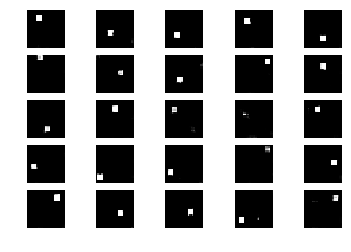

2000 [D loss: 0.000024, acc.: 100.00%] [G loss: 15.647120]


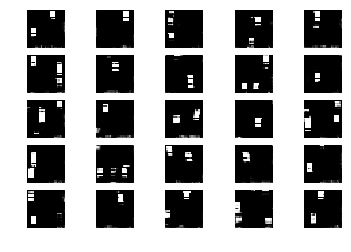

4000 [D loss: 0.000006, acc.: 100.00%] [G loss: 12.875237]


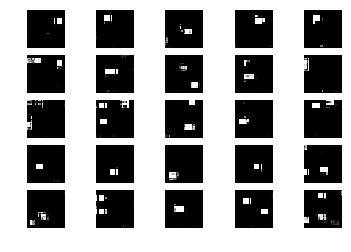

6000 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.910419]


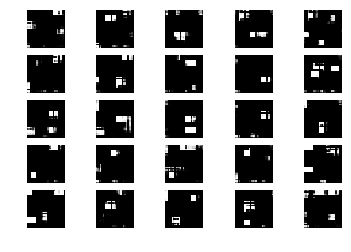

8000 [D loss: 0.003375, acc.: 100.00%] [G loss: 13.576218]


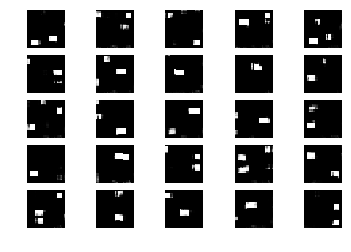

10000 [D loss: 0.000746, acc.: 100.00%] [G loss: 15.148314]


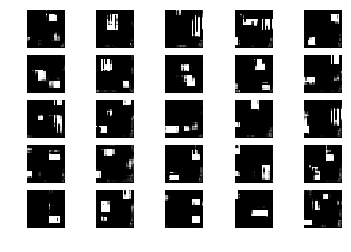

12000 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.251535]


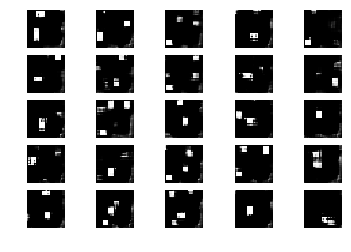

14000 [D loss: 0.000008, acc.: 100.00%] [G loss: 15.771694]


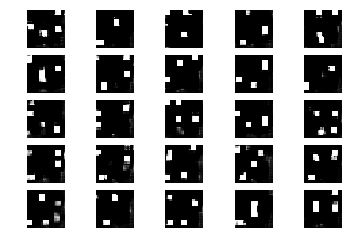

16000 [D loss: 0.000004, acc.: 100.00%] [G loss: 15.687508]


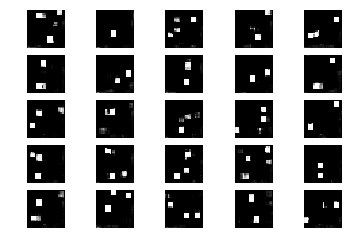

18000 [D loss: 0.000009, acc.: 100.00%] [G loss: 14.525957]


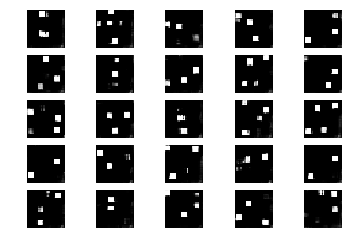

In [0]:
ds_path = 'drive/My Drive/synthetic-ds/squares/3-4-28x28.npy'
# Load Dataset
ds = np.load(ds_path)
X_train = ds

img_shape = (28,28,1)
latent_dim = 100
save_path = 'drive/My Drive/DCGAN-squares-3-4-transfer-40000'

# Since we are transferring weights keep training shorter
n_iter = 20000
scaling = 0.5

# Train model
gan = DCGAN(X_train, img_shape, latent_dim, save_path, pretrained = 'drive/My Drive/DCGAN-squares-1-4/models/40000')
gan.train(n_iter, 32, 2000, scaling)

### Eval on Mixture of Polygons CT2

In [0]:
cv_img = np.zeros((5000, 28, 28, 3))

i = 0
for img in glob.glob("drive/My Drive/synthetic-ds/ct2-28/*.png"):
  cv_img[i]= cv2.imread(img)
  i += 1
  if i%100 == 0:
    print(i)

X_train = cv_img
print(X_train.shape)

100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
(5000, 28, 28, 3)


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_57 (Conv2D)           (None, 14, 14, 32)        896       
_________________________________________________________________
leaky_re_lu_159 (LeakyReLU)  (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_33 (Dropout)         (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_58 (Conv2D)           (None, 7, 7, 64)          18496     
_________________________________________________________________
zero_padding2d_9 (ZeroPaddin (None, 8, 8, 64)          0         
_________________________________________________________________
batch_normalization_41 (Batc (None, 8, 8, 64)          256       
_________________________________________________________________
leaky_re_lu_160 (LeakyReLU)  (None, 8, 8, 64)          0         
__________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 1.176255, acc.: 37.50%] [G loss: 1.237426]
0.9998094
float32
0.9999047


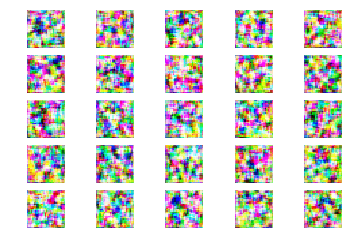

2000 [D loss: 0.636295, acc.: 60.94%] [G loss: 1.455543]
0.99998516
float32
0.9999926


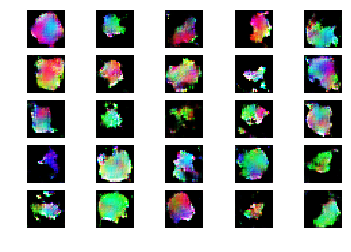

4000 [D loss: 0.457202, acc.: 79.69%] [G loss: 3.287964]
0.99989957
float32
0.9999498


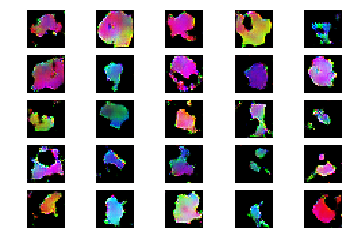

6000 [D loss: 0.164545, acc.: 96.88%] [G loss: 4.407767]
1.0
float32
1.0


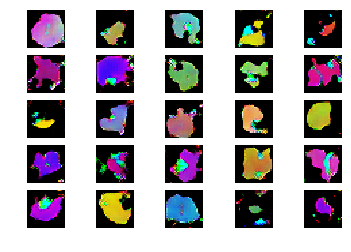

8000 [D loss: 0.450690, acc.: 71.88%] [G loss: 2.841949]
1.0
float32
1.0


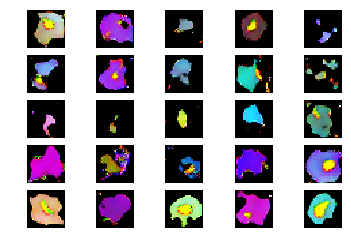

10000 [D loss: 0.235406, acc.: 92.19%] [G loss: 1.569672]
0.99999994
float32
1.0


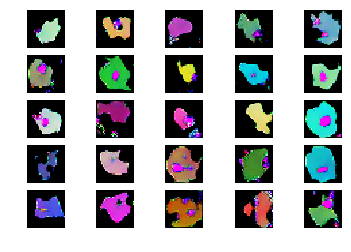

12000 [D loss: 0.012521, acc.: 100.00%] [G loss: 7.209004]
0.99999934
float32
0.99999964


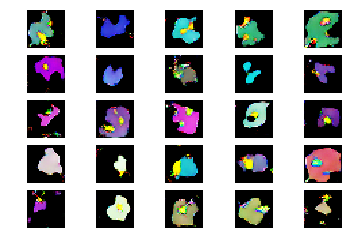

14000 [D loss: 0.038416, acc.: 100.00%] [G loss: 3.173756]
0.9999999
float32
0.99999994


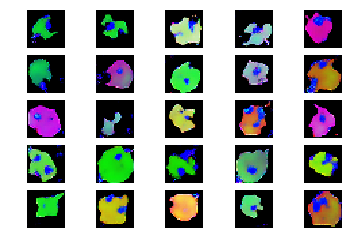

16000 [D loss: 0.045886, acc.: 100.00%] [G loss: 4.795382]
0.9999817
float32
0.9999908


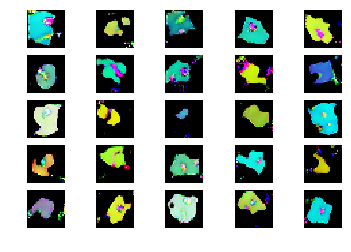

18000 [D loss: 0.011202, acc.: 100.00%] [G loss: 5.546457]
0.99999446
float32
0.99999726


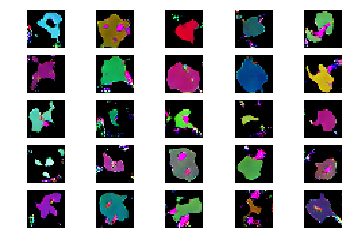

In [0]:
img_shape = (28,28,3)
latent_dim = 256
save_path = 'drive/My Drive/DCGAN-polygons-20k'

n_iter = 20000
scaling = 127.5

# Train model
gan = DCGAN(X_train, img_shape, latent_dim, save_path)
gan.train(n_iter, 32, 2000, scaling)

## WGANGP for Images

In [0]:
class RandomWeightedAverage(_Merge):
    """Provides a (random) weighted average between real and generated image samples"""
    def _merge_function(self, inputs):
        alpha = K.random_uniform((32, 1, 1, 1))
        return (alpha * inputs[0]) + ((1 - alpha) * inputs[1])

class WGANGP_images():
    def __init__(self, X_train, img_shape, latent_dim, save_path):
        self.img_rows = img_shape[0]
        self.img_cols = img_shape[1]
        self.channels = img_shape[2]
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = latent_dim
        self.save_path = save_path
        self.dataset = X_train

        # Following parameter and optimizer set as recommended in paper
        self.n_critic = 5
        optimizer = RMSprop(lr=0.00005)

        # Build the generator and critic
        self.generator = self.build_generator()
        self.critic = self.build_critic()

        #-------------------------------
        # Construct Computational Graph
        #       for the Critic
        #-------------------------------

        # Freeze generator's layers while training critic
        self.generator.trainable = False

        # Image input (real sample)
        real_img = Input(shape=self.img_shape)

        # Noise input
        z_disc = Input(shape=(self.latent_dim,))
        # Generate image based of noise (fake sample)
        fake_img = self.generator(z_disc)

        # Discriminator determines validity of the real and fake images
        fake = self.critic(fake_img)
        valid = self.critic(real_img)

        # Construct weighted average between real and fake images
        interpolated_img = RandomWeightedAverage()([real_img, fake_img])
        # Determine validity of weighted sample
        validity_interpolated = self.critic(interpolated_img)

        # Use Python partial to provide loss function with additional
        # 'averaged_samples' argument
        partial_gp_loss = partial(self.gradient_penalty_loss,
                          averaged_samples=interpolated_img)
        partial_gp_loss.__name__ = 'gradient_penalty' # Keras requires function names

        self.critic_model = Model(inputs=[real_img, z_disc],
                            outputs=[valid, fake, validity_interpolated])
        self.critic_model.compile(loss=[self.wasserstein_loss,
                                              self.wasserstein_loss,
                                              partial_gp_loss],
                                        optimizer=optimizer,
                                        loss_weights=[1, 1, 10])
        #-------------------------------
        # Construct Computational Graph
        #         for Generator
        #-------------------------------

        # For the generator we freeze the critic's layers
        self.critic.trainable = False
        self.generator.trainable = True

        # Sampled noise for input to generator
        z_gen = Input(shape=(100,))
        # Generate images based of noise
        img = self.generator(z_gen)
        # Discriminator determines validity
        valid = self.critic(img)
        # Defines generator model
        self.generator_model = Model(z_gen, valid)
        self.generator_model.compile(loss=self.wasserstein_loss, optimizer=optimizer)


    def gradient_penalty_loss(self, y_true, y_pred, averaged_samples):
        """
        Computes gradient penalty based on prediction and weighted real / fake samples
        """
        gradients = K.gradients(y_pred, averaged_samples)[0]
        # compute the euclidean norm by squaring ...
        gradients_sqr = K.square(gradients)
        #   ... summing over the rows ...
        gradients_sqr_sum = K.sum(gradients_sqr,
                                  axis=np.arange(1, len(gradients_sqr.shape)))
        #   ... and sqrt
        gradient_l2_norm = K.sqrt(gradients_sqr_sum)
        # compute lambda * (1 - ||grad||)^2 still for each single sample
        gradient_penalty = K.square(1 - gradient_l2_norm)
        # return the mean as loss over all the batch samples
        return K.mean(gradient_penalty)


    def wasserstein_loss(self, y_true, y_pred):
        return K.mean(y_true * y_pred)

    def build_generator(self):

        model = Sequential()

        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=4, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=4, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(Conv2D(self.channels, kernel_size=4, padding="same"))
        model.add(Activation("tanh"))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_critic(self):

        model = Sequential()

        model.add(Conv2D(16, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(32, kernel_size=3, strides=2, padding="same"))
        model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(128, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Flatten())
        model.add(Dense(1))

        model.summary()

        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size, sample_interval, scaling):
        X_train = self.dataset

        # Rescale -1 to 1
        X_train = X_train / scaling - 1.
        X_train = np.expand_dims(X_train, axis=3)
        
        #X_train += np.reshape(np.random.normal(0, 0.1, X_train.shape[0]*X_train.shape[1]*X_train.shape[2]*X_train.shape[3]), X_train.shape)
        
        # Adversarial ground truths
        valid = -np.ones((batch_size, 1))
        fake =  np.ones((batch_size, 1))
        dummy = np.zeros((batch_size, 1)) # Dummy gt for gradient penalty
        
        gen_loss = []
        disc_loss = []
        
        for epoch in range(epochs):

            for _ in range(self.n_critic):

                # ---------------------
                #  Train Discriminator
                # ---------------------

                # Select a random batch of images
                idx = np.random.randint(0, X_train.shape[0], batch_size)
                imgs = X_train[idx]
                # Sample generator input
                noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
                # Train the critic
                d_loss = self.critic_model.train_on_batch([imgs, noise],
                                                                [valid, fake, dummy])

            # ---------------------
            #  Train Generator
            # ---------------------

            g_loss = self.generator_model.train_on_batch(noise, valid)
            
            if epoch%sample_interval == 0:
              # Plot the progress
              print ("%d [D loss: %f] [G loss: %f]" % (epoch, d_loss[0], g_loss))

            gen_loss.append(g_loss)
            disc_loss.append(d_loss[0])
            
            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:                
                # Save Snapshots of models, losses and samples
                
                # Save model snapshots
                model_dir = self.save_path + '/models/' + str(epoch) + '/'
                pathlib.Path(model_dir).mkdir(parents=True, exist_ok=True) 
                self.generator_model.save(model_dir + 'gen_' + str(epoch) + '.h5')
                self.critic_model.save(model_dir + 'disc_' + str(epoch) + '.h5')
                
                # Save Losses
                loss_dir = self.save_path + '/loss/' + str(epoch) + '/'
                pathlib.Path(loss_dir).mkdir(parents=True, exist_ok=True) 
                np.save(loss_dir + 'critic_loss', np.array(disc_loss))
                np.save(loss_dir + 'gen_loss', np.array(gen_loss))
                
                # Plot and Save samples
                sample_dir = self.save_path + '/samples/' + str(epoch) + '/'
                self.sample_images(epoch, sample_dir, scaling)

    def sample_images(self, epoch, sample_dir, scaling):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)

        # Rescale images 0 - 1
        gen_imgs = scaling * (gen_imgs + 1)

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray')
                axs[i,j].axis('off')
                cnt += 1
        pathlib.Path(sample_dir).mkdir(parents=True, exist_ok=True)
        plt.savefig(sample_dir + 'sample.png')
        plt.show()
        plt.close()
       

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 6272)              633472    
_________________________________________________________________
reshape_4 (Reshape)          (None, 7, 7, 128)         0         
_________________________________________________________________
up_sampling2d_7 (UpSampling2 (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 14, 14, 128)       262272    
_________________________________________________________________
batch_normalization_16 (Batc (None, 14, 14, 128)       512       
_________________________________________________________________
activation_6 (Activation)    (None, 14, 14, 128)       0         
_________________________________________________________________
up_sampling2d_8 (UpSampling2 (None, 28, 28, 128)       0         
__________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 10.649556] [G loss: 0.118177]


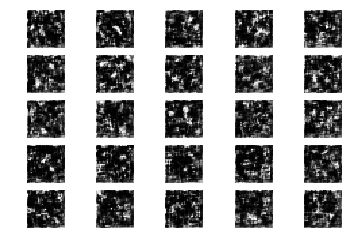

2000 [D loss: -15.752858] [G loss: 9.769885]


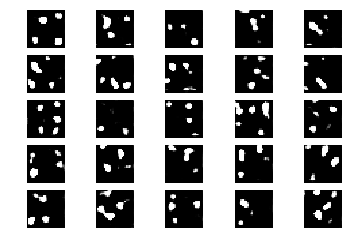

4000 [D loss: -141.205338] [G loss: 82.821968]


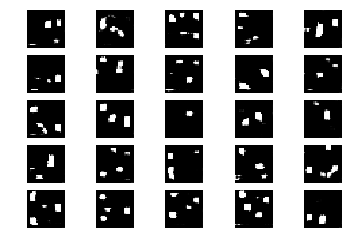

6000 [D loss: -641.677917] [G loss: 287.093262]


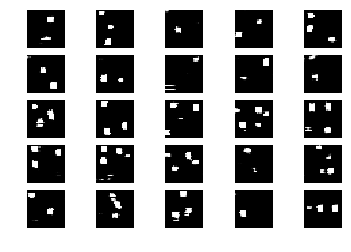

8000 [D loss: -1511.288818] [G loss: 730.708008]


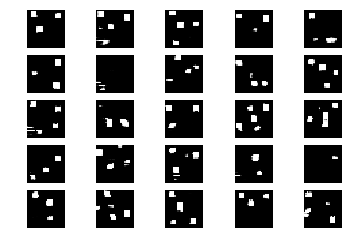

10000 [D loss: -3008.843506] [G loss: 1288.725830]


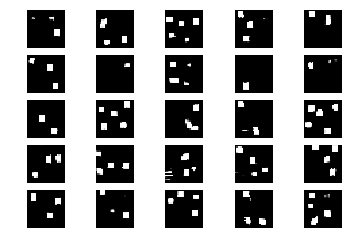

12000 [D loss: -4872.322754] [G loss: 2391.023438]


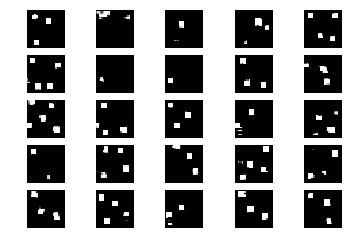

14000 [D loss: -6285.335938] [G loss: 3383.550537]


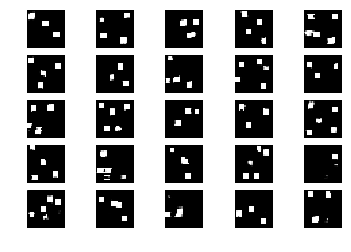

16000 [D loss: -9422.828125] [G loss: 3908.788818]


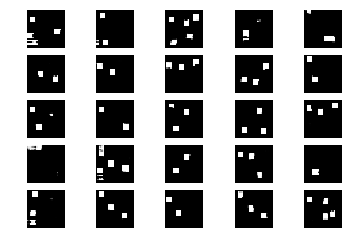

18000 [D loss: -11348.291992] [G loss: 5778.165039]


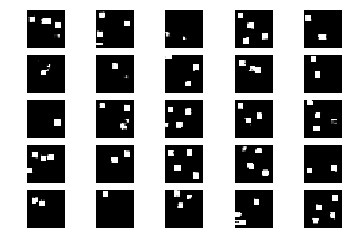

20000 [D loss: -10885.370117] [G loss: 5155.628906]


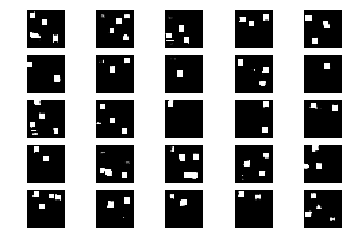

22000 [D loss: -16360.349609] [G loss: 8348.952148]


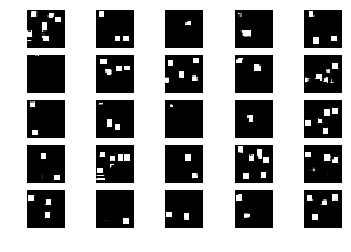

24000 [D loss: -21599.662109] [G loss: 8687.287109]


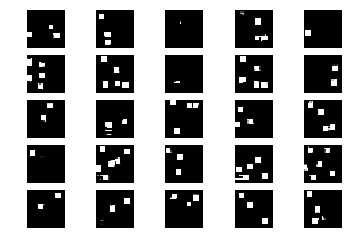

26000 [D loss: -18667.904297] [G loss: 9725.372070]


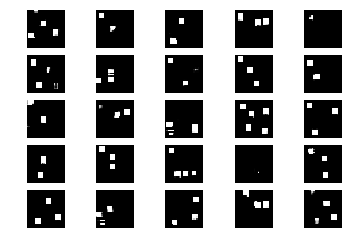

28000 [D loss: -28617.558594] [G loss: 11626.473633]


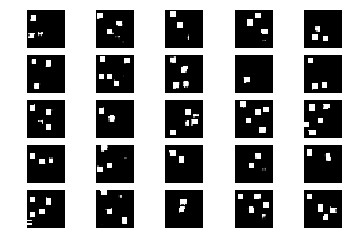

30000 [D loss: -29110.871094] [G loss: 13750.976562]


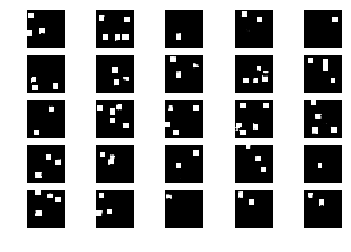

32000 [D loss: -28503.863281] [G loss: 14829.208984]


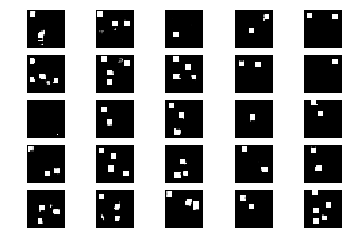

34000 [D loss: -16411.750000] [G loss: 10213.857422]


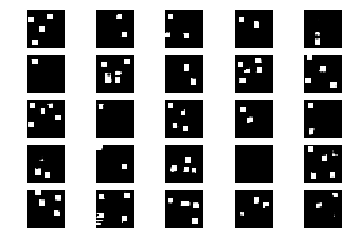

36000 [D loss: -39676.562500] [G loss: 18255.179688]


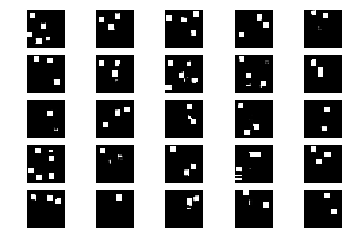

38000 [D loss: -34112.925781] [G loss: 18212.648438]


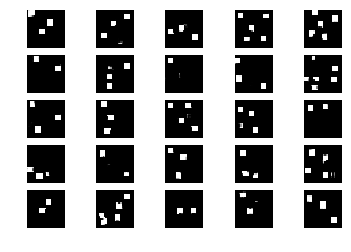

40000 [D loss: -50377.882812] [G loss: 20762.757812]


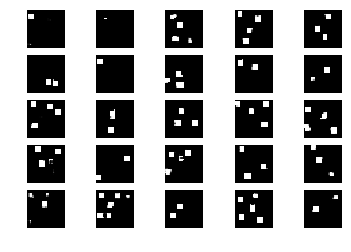

42000 [D loss: -27504.746094] [G loss: 9430.826172]


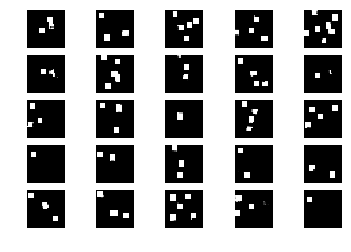

44000 [D loss: -48155.234375] [G loss: 18077.914062]


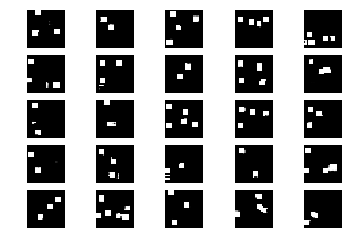

46000 [D loss: -50289.375000] [G loss: 20793.753906]


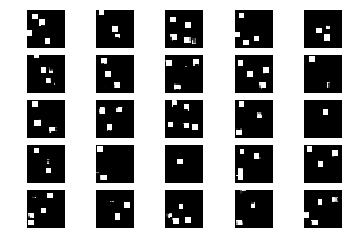

48000 [D loss: -63299.187500] [G loss: 22898.275391]


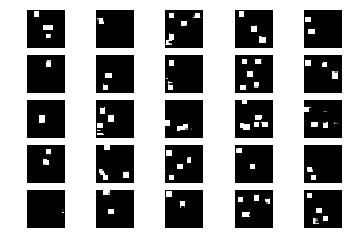

In [0]:
build_model_image(WGANGP_images, 'drive/My Drive/synthetic-ds/squares/3-4-28x28.npy', (28,28,1), 100, 'drive/My Drive/WGAN-squares-3-4', 50000, 0.5)

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 6272)              633472    
_________________________________________________________________
reshape_1 (Reshape)          (None, 7, 7, 128)         0         
_________________________________________________________________
up_sampling2d_1 (UpSampling2 (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 14, 14, 128)       262272    
_________________________________________________________________
batch_normalization_1 (Batch (None, 14, 14, 128)       512       
_________________________________________________________________
activation_1 (Activation)    (None, 14, 14, 128)       0         
_________________________________________________________________
up_s

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 8.213359] [G loss: 0.214030]


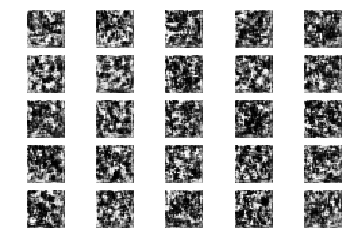

2000 [D loss: -13.403968] [G loss: 6.650217]


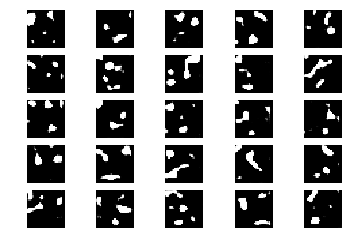

4000 [D loss: -294.542053] [G loss: 146.923187]


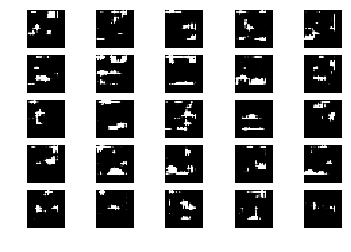

6000 [D loss: -1404.335815] [G loss: 693.999756]


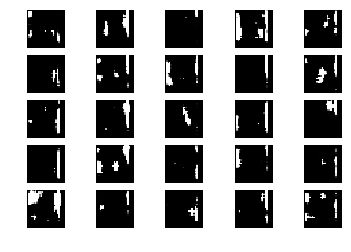

8000 [D loss: -3406.926270] [G loss: 1645.514648]


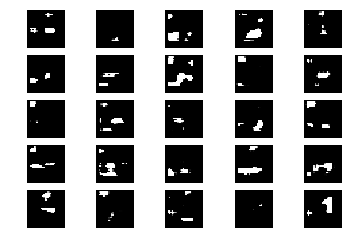

10000 [D loss: -6108.211426] [G loss: 2860.196289]


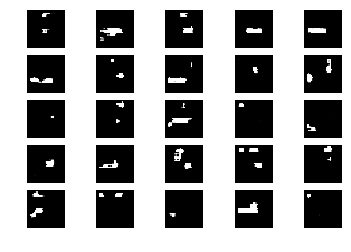

12000 [D loss: -7861.419922] [G loss: 4344.416016]


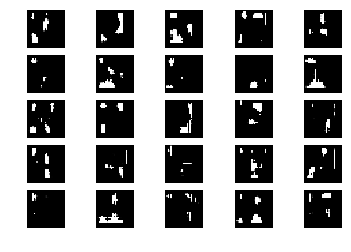

14000 [D loss: -12702.992188] [G loss: 6098.786133]


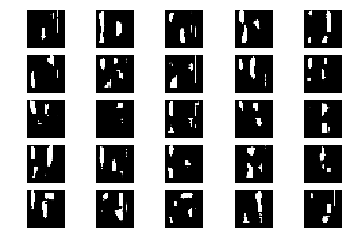

16000 [D loss: -17511.546875] [G loss: 8322.206055]


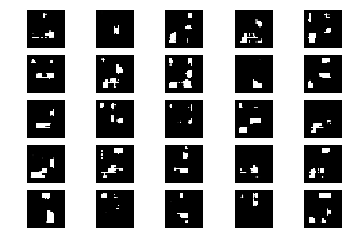

18000 [D loss: -19693.519531] [G loss: 10273.255859]


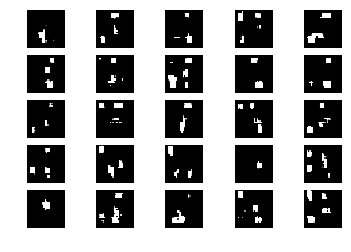

20000 [D loss: -23135.759766] [G loss: 12525.637695]


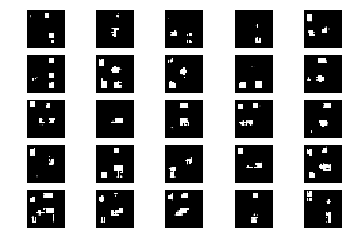

22000 [D loss: -31125.218750] [G loss: 14078.099609]


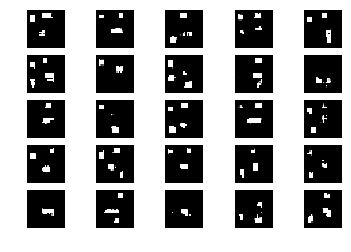

24000 [D loss: -31846.818359] [G loss: 16379.751953]


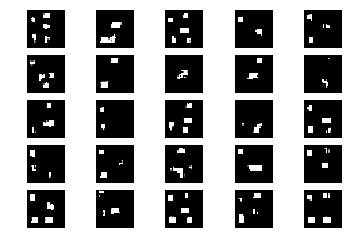

26000 [D loss: -30687.324219] [G loss: 18638.746094]


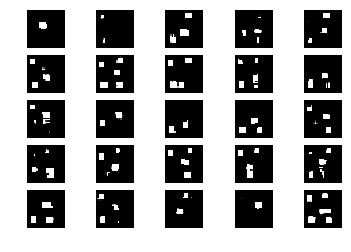

28000 [D loss: -43807.476562] [G loss: 19937.634766]


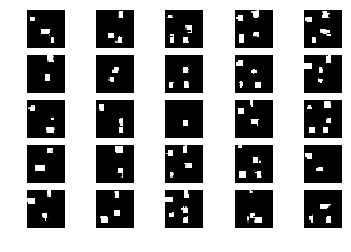

30000 [D loss: -42290.453125] [G loss: 16840.085938]


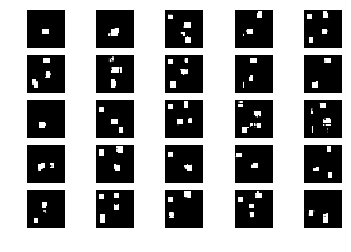

32000 [D loss: -57230.390625] [G loss: 26228.753906]


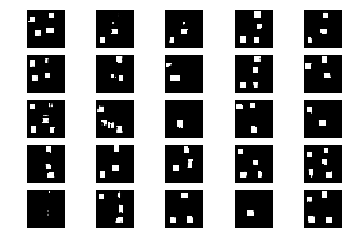

34000 [D loss: -44207.273438] [G loss: 25033.742188]


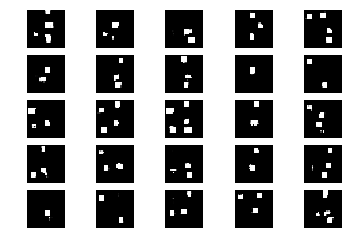

36000 [D loss: -49394.812500] [G loss: 25116.533203]


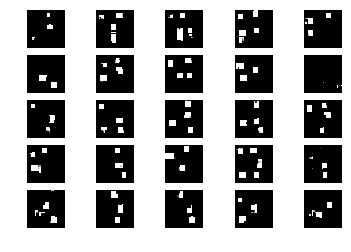

38000 [D loss: -72945.617188] [G loss: 26739.804688]


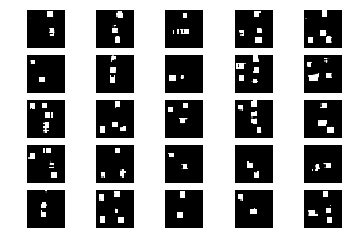

40000 [D loss: -79120.398438] [G loss: 34419.625000]


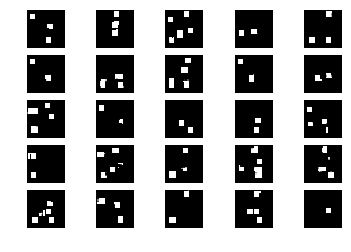

42000 [D loss: -83755.898438] [G loss: 33798.664062]


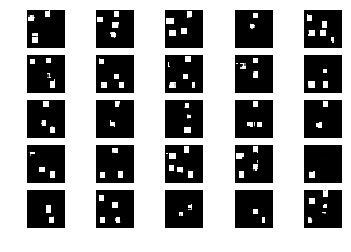

44000 [D loss: -74148.859375] [G loss: 35376.546875]


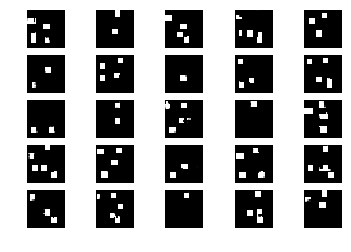

46000 [D loss: -83186.968750] [G loss: 18659.570312]


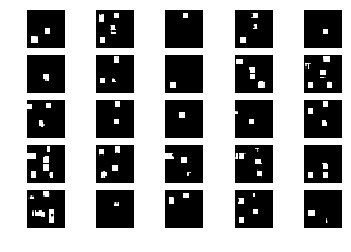

48000 [D loss: -79147.070312] [G loss: 38074.976562]


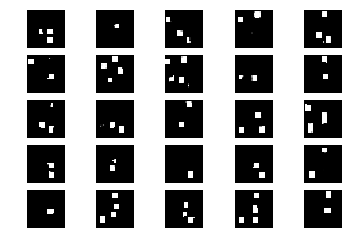

50000 [D loss: -96121.734375] [G loss: 41834.531250]


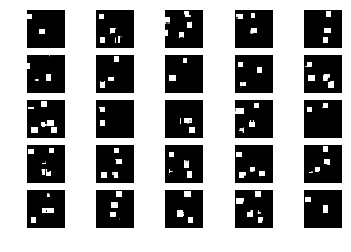

52000 [D loss: -70146.359375] [G loss: 33099.664062]


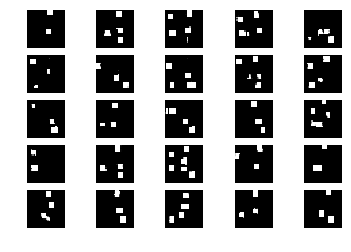

54000 [D loss: -89126.804688] [G loss: 42548.609375]


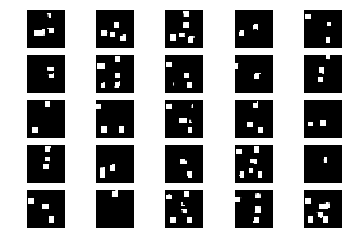

56000 [D loss: -102339.679688] [G loss: 51598.000000]


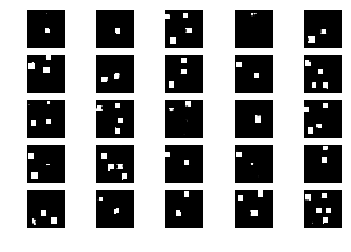

58000 [D loss: -111761.687500] [G loss: 43051.195312]


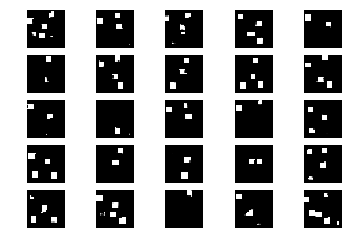

60000 [D loss: -79986.257812] [G loss: 41027.312500]


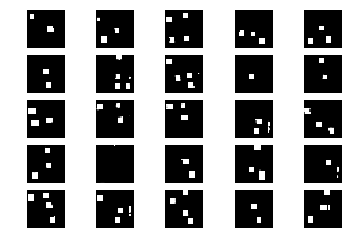

62000 [D loss: 194751.343750] [G loss: 44192.925781]


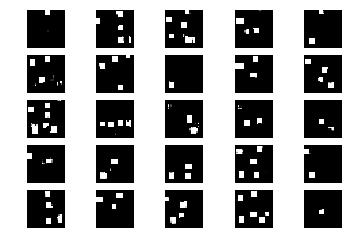

64000 [D loss: -84763.109375] [G loss: 53615.968750]


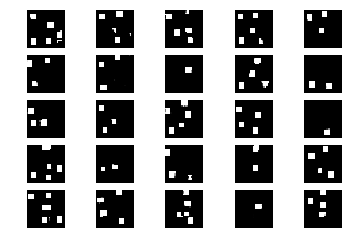

66000 [D loss: -37489.468750] [G loss: 52249.906250]


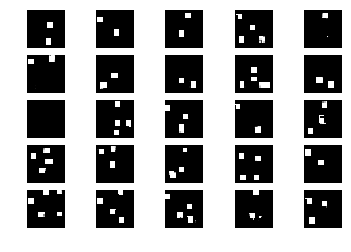

68000 [D loss: -78418.781250] [G loss: 52239.406250]


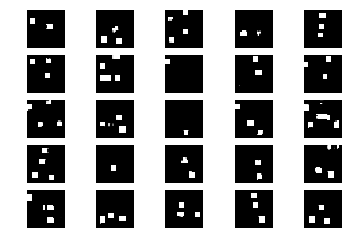

70000 [D loss: -85979.750000] [G loss: 14323.908203]


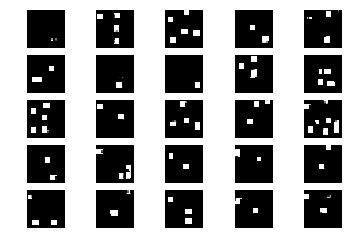

72000 [D loss: -119979.234375] [G loss: 48635.980469]


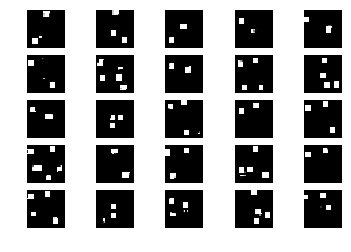

74000 [D loss: -119942.718750] [G loss: 4445.469727]


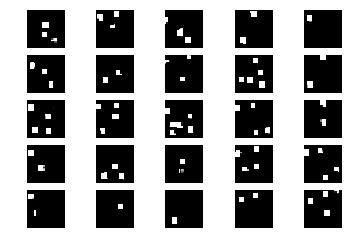

76000 [D loss: -135563.609375] [G loss: 48443.726562]


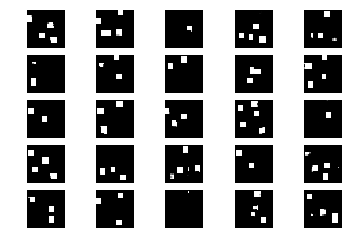

78000 [D loss: -145461.093750] [G loss: 24670.482422]


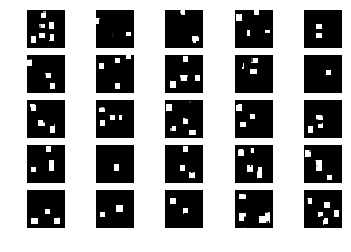

80000 [D loss: -117970.968750] [G loss: 32899.128906]


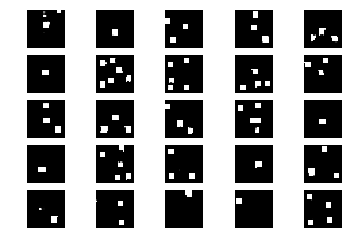

82000 [D loss: -133629.421875] [G loss: 46493.503906]


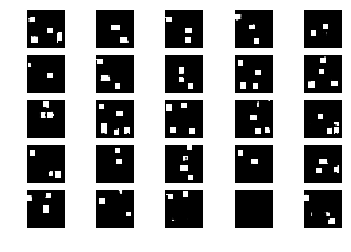

84000 [D loss: -69706.234375] [G loss: 47883.132812]


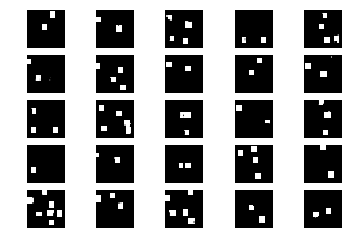

86000 [D loss: -41181.726562] [G loss: 33471.781250]


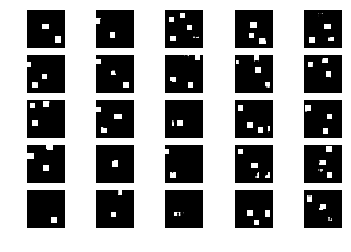

88000 [D loss: -67398.109375] [G loss: 17815.984375]


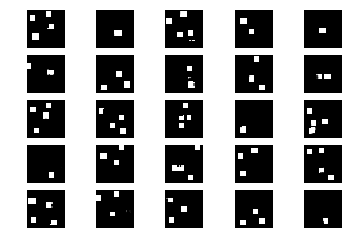

90000 [D loss: -61414.191406] [G loss: 20893.292969]


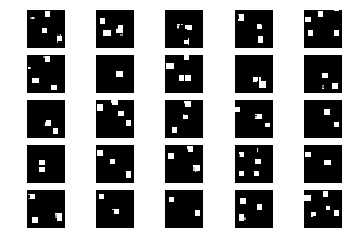

92000 [D loss: -39453.007812] [G loss: -12693.833984]


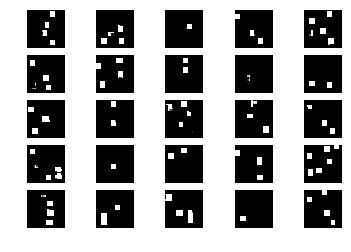

94000 [D loss: -143169.859375] [G loss: 66646.078125]


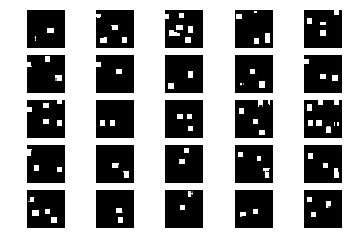

96000 [D loss: -161298.296875] [G loss: 49320.207031]


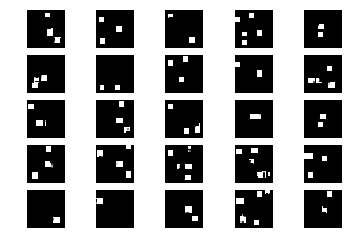

98000 [D loss: -124620.031250] [G loss: 17989.898438]


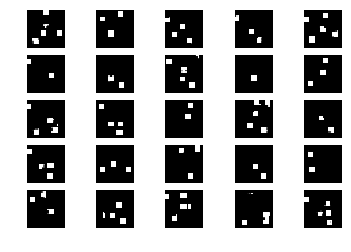

100000 [D loss: -151138.750000] [G loss: 39716.671875]


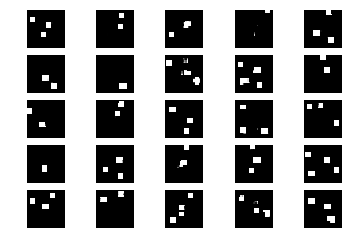

102000 [D loss: -161406.796875] [G loss: 20936.011719]


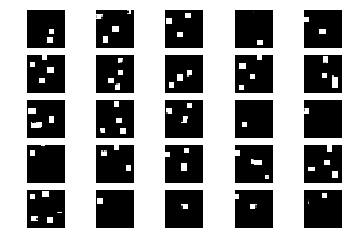

104000 [D loss: -139225.265625] [G loss: 56464.937500]


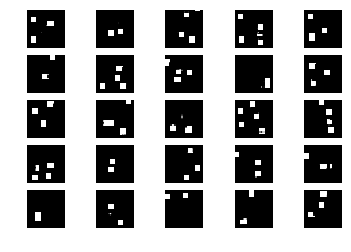

106000 [D loss: -161911.031250] [G loss: 51735.691406]


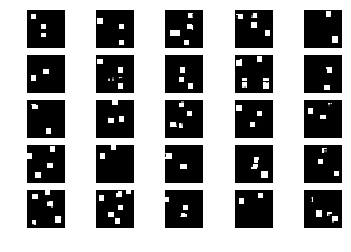

108000 [D loss: -193634.718750] [G loss: 34974.121094]


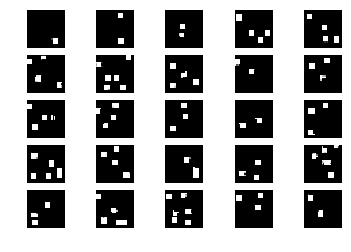

110000 [D loss: -133048.218750] [G loss: 37078.550781]


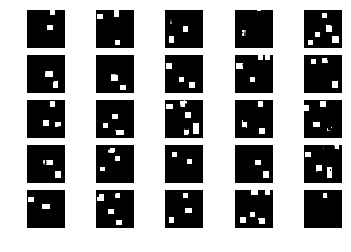

112000 [D loss: -11351.328125] [G loss: 14474.453125]


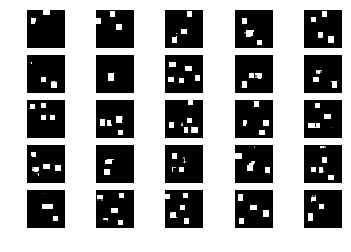

114000 [D loss: -153529.187500] [G loss: 54233.031250]


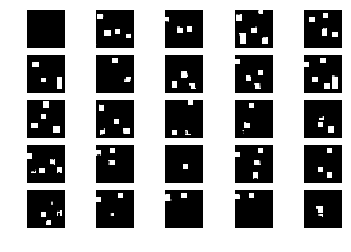

116000 [D loss: -167994.859375] [G loss: 28134.093750]


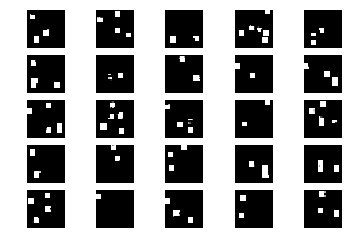

118000 [D loss: -24021.785156] [G loss: 31327.029297]


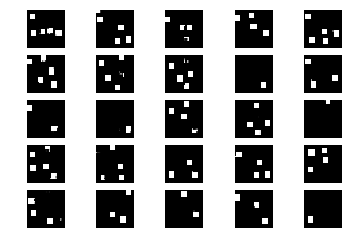

120000 [D loss: -198232.281250] [G loss: 63445.542969]


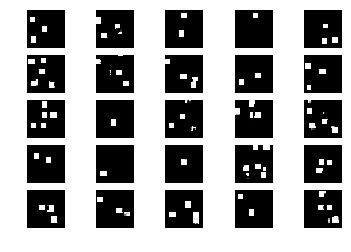

122000 [D loss: -164909.125000] [G loss: 5983.940430]


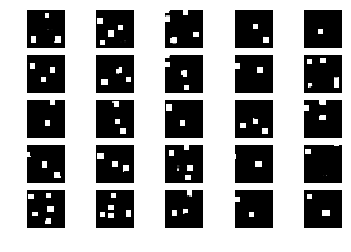

124000 [D loss: -80063.453125] [G loss: 44950.460938]


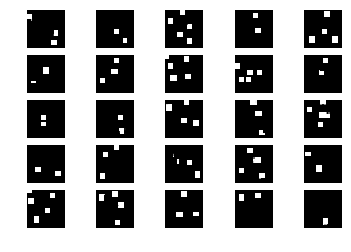

126000 [D loss: -135749.562500] [G loss: 13927.735352]


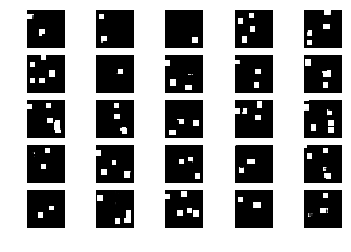

128000 [D loss: -195442.937500] [G loss: 25567.578125]


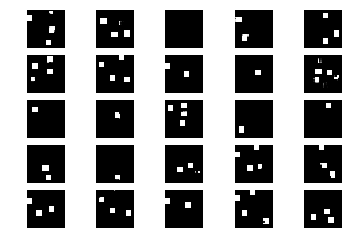

130000 [D loss: -169116.281250] [G loss: -12618.082031]


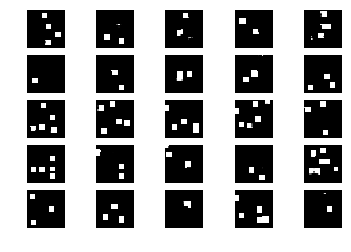

132000 [D loss: -199728.000000] [G loss: -15209.110352]


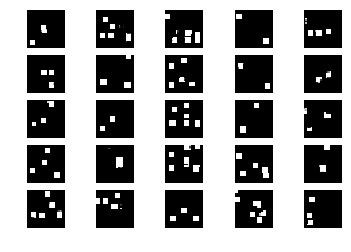

134000 [D loss: -163462.500000] [G loss: 57048.039062]


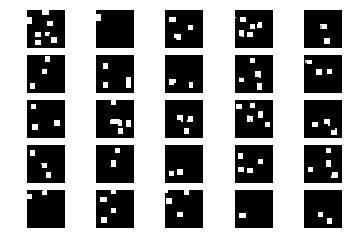

136000 [D loss: -227385.281250] [G loss: 53079.527344]


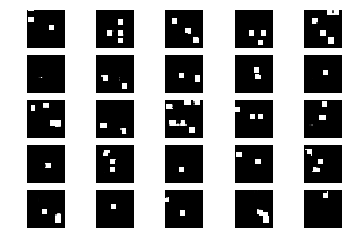

138000 [D loss: -152662.406250] [G loss: 11062.183594]


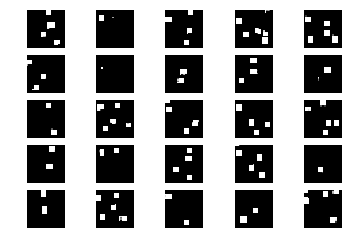

140000 [D loss: -24716.019531] [G loss: 65282.414062]


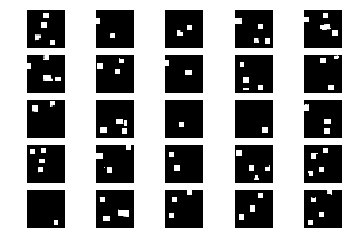

142000 [D loss: -105254.070312] [G loss: 29176.585938]


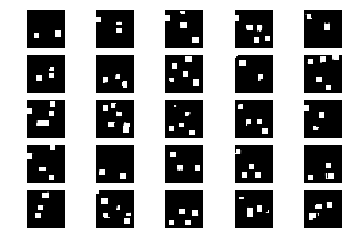

144000 [D loss: -143424.984375] [G loss: 31182.013672]


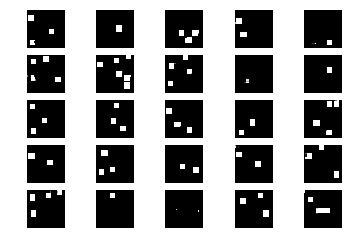

146000 [D loss: -108430.906250] [G loss: 26794.673828]


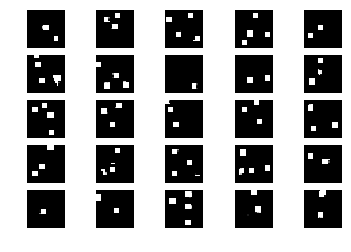

148000 [D loss: -38284.820312] [G loss: 4793.292969]


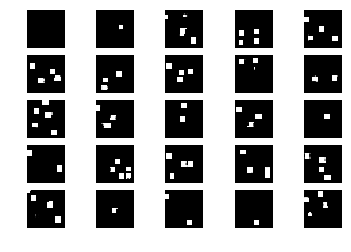

In [10]:
build_model_image(WGANGP_images, 'drive/My Drive/synthetic-ds/squares/3-4-28x28.npy', (28,28,1), 100, 'drive/My Drive/WGAN-squares-3-4-150k', 150000, 0.5)